<a href="https://colab.research.google.com/github/arybinski/xai-notebooks/blob/master/LIME.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Copyright 2018 Google LLC.

Licensed under the Apache License, Version 2.0 (the "License");

In [0]:
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

## Install and Imports

In [0]:
!pip -q install lucid>=0.3.1

import numpy as np
import tensorflow as tf
import lucid.modelzoo.vision_models as models
from lucid.misc.io import show, load, save

# for resizing images
from PIL import Image

# for image uploader
from google.colab import files

# For plots
import matplotlib.pyplot as plt

In [0]:
model = models.InceptionV1()
model.load_graphdef()

In [0]:
def classify2(test_image, n=10, show_output=False):
  tf.reset_default_graph()

  with tf.Session().as_default() as sess:
    input_t = tf.placeholder(tf.float32, shape=(224,224,3))
    model.import_graph(input_t)
    softmax2_t = sess.graph.get_tensor_by_name('import/softmax2:0')
    tf.global_variables_initializer().run()
    logits, = sess.run([softmax2_t], {input_t: test_image})
  
  BATCH = 0
  top_n_label_indices = np.argsort(logits)[BATCH][-n:][::-1]
  safe_top_n_label_indices = np.extract(top_n_label_indices < 1001, top_n_label_indices)
  top_n_labels = np.array(model.labels)[safe_top_n_label_indices]
  top_n_probs = logits[BATCH][safe_top_n_label_indices]
  max_length = max(len(label) for label in top_n_labels)
  predictions = ["{}: {: >6.2%}".format(label.rjust(max_length), prob) for (label, prob) in zip(top_n_labels, top_n_probs)]
  
  if show_output:
    show(test_image)
    print("\n".join(predictions))
  
  return (top_n_probs, top_n_labels)

In [0]:
def classifyImages(images):
  return map(classify2, images);

In [0]:
snorkel_url = "https://storage.googleapis.com/lucid-static/activation-atlas/adversarial-examples/examples/snorkel.png"
grey_whale_url = "https://storage.googleapis.com/lucid-static/activation-atlas/adversarial-examples/examples/grey-whale.jpg"
frying_pan_url = "https://storage.googleapis.com/lucid-static/activation-atlas/adversarial-examples/examples/frying-pan.png"

(224, 224, 3)



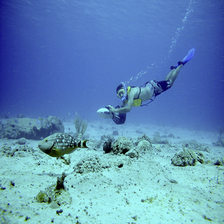

           snorkel: 55.60%
        coral reef: 18.65%
       scuba diver: 13.49%
        loggerhead:  5.52%
          lionfish:  1.71%
         sea snake:  1.36%
               ski:  0.43%
         rock crab:  0.40%
       rock beauty:  0.39%
leatherback turtle:  0.29%


(array([0.5560084 , 0.1865294 , 0.13486609, 0.05519044, 0.01708108,
        0.01356929, 0.00431692, 0.00403554, 0.00388307, 0.00291969],
       dtype=float32),
 array(['snorkel', 'coral reef', 'scuba diver', 'loggerhead', 'lionfish',
        'sea snake', 'ski', 'rock crab', 'rock beauty',
        'leatherback turtle'], dtype='<U30'))

In [0]:
snorkel_img = load(snorkel_url)
im = Image.fromarray(np.uint8(snorkel_img * 255.));
im_resize = im.resize((224, 224), Image.LANCZOS)
im_array = np.asarray(im_resize)/255.
test_image = im_array[:,:,:3]
print(test_image.shape)
classify2(test_image)

In [0]:
%load_ext autoreload
%autoreload 2
!pip install -q lime
import os,sys
try:
    import lime
except:
    sys.path.append(os.path.join('..', '..')) # add the current directory
    import lime
from lime import lime_image

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [0]:
explainer = lime_image.LimeImageExplainer()


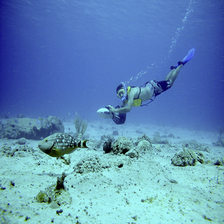

           snorkel: 55.60%
        coral reef: 18.65%
       scuba diver: 13.49%
        loggerhead:  5.52%
          lionfish:  1.71%
         sea snake:  1.36%
               ski:  0.43%
         rock crab:  0.40%
       rock beauty:  0.39%
leatherback turtle:  0.29%



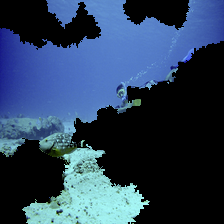

 coral reef: 55.25%
scuba diver: 34.23%
  jellyfish:  2.30%
   lionfish:  2.06%
      wreck:  1.99%
brain coral:  1.30%
    volcano:  0.47%
     castle:  0.36%
   lakeside:  0.17%
      cliff:  0.13%



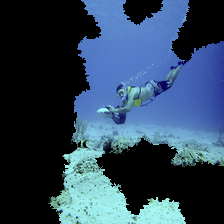

  coral reef: 49.44%
 scuba diver: 25.37%
     snorkel: 14.75%
    lionfish:  6.89%
      puffer:  1.15%
  loggerhead:  0.40%
   jellyfish:  0.39%
 rock beauty:  0.27%
   sea snake:  0.27%
anemone fish:  0.20%



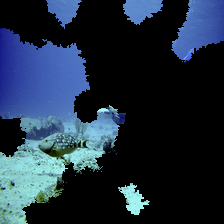

 coral reef: 60.05%
scuba diver:  7.37%
  jellyfish:  5.29%
    volcano:  4.39%
      wreck:  3.52%
brain coral:  1.94%
      cliff:  1.51%
  sea snake:  1.23%
 promontory:  1.19%
   lakeside:  1.11%



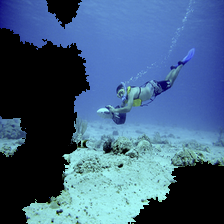

    snorkel: 58.84%
 coral reef: 21.44%
scuba diver: 16.65%
   lionfish:  1.32%
 loggerhead:  0.69%
        ski:  0.24%
  sea snake:  0.19%
rock beauty:  0.11%
      cliff:  0.07%
     puffer:  0.07%



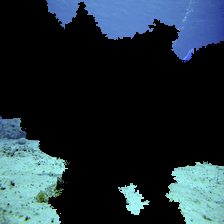

       cliff: 31.21%
  coral reef: 12.35%
  promontory: 11.40%
       wreck:  9.11%
     volcano:  5.78%
 scuba diver:  3.95%
   jellyfish:  3.43%
    lakeside:  3.07%
sea cucumber:  2.34%
       conch:  1.14%



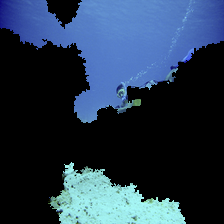

scuba diver: 67.06%
 coral reef: 11.07%
      wreck:  4.42%
      cliff:  2.08%
    volcano:  1.61%
  jellyfish:  1.36%
   lionfish:  0.82%
     castle:  0.79%
       jeep:  0.69%
    tractor:  0.67%



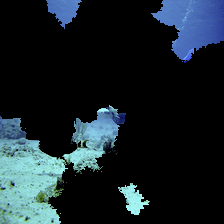

 coral reef: 23.33%
    volcano: 17.44%
  jellyfish: 16.27%
      cliff: 11.10%
 promontory:  5.04%
      wreck:  3.23%
     valley:  2.49%
scuba diver:  2.10%
     geyser:  1.73%
brain coral:  1.61%



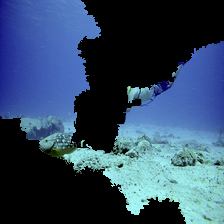

  coral reef: 18.39%
   jellyfish: 13.78%
 scuba diver:  9.67%
       cliff:  8.56%
    lionfish:  3.98%
       wreck:  3.75%
  promontory:  3.59%
sea cucumber:  3.51%
     volcano:  2.18%
     snorkel:  2.02%



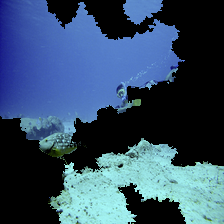

scuba diver: 72.09%
 coral reef: 20.97%
   lionfish:  1.63%
      wreck:  0.92%
     castle:  0.63%
  jellyfish:  0.49%
    volcano:  0.43%
brain coral:  0.30%
       jeep:  0.28%
   broccoli:  0.27%



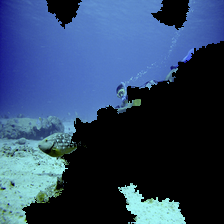

scuba diver: 78.36%
 coral reef: 10.23%
      wreck:  7.59%
   lionfish:  0.95%
  jellyfish:  0.67%
brain coral:  0.51%
    snorkel:  0.31%
    volcano:  0.22%
      cliff:  0.15%
 promontory:  0.11%



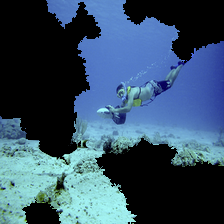

 scuba diver: 43.96%
  coral reef: 27.48%
     snorkel: 20.22%
    lionfish:  5.89%
  loggerhead:  0.33%
   jellyfish:  0.33%
      puffer:  0.29%
   sea snake:  0.22%
       wreck:  0.14%
sea cucumber:  0.13%



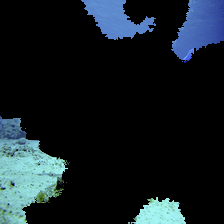

 coral reef: 27.22%
      cliff: 16.65%
 promontory: 13.39%
    volcano:  9.74%
  jellyfish:  5.52%
   lakeside:  3.67%
   seashore:  1.70%
     valley:  1.50%
      wreck:  1.28%
brain coral:  0.96%



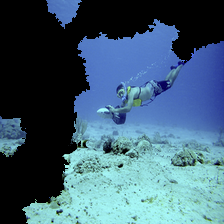

    snorkel: 69.96%
scuba diver: 15.66%
 coral reef:  9.39%
   lionfish:  2.29%
        ski:  1.14%
  sea snake:  0.39%
 loggerhead:  0.20%
  parachute:  0.09%
rock beauty:  0.08%
      conch:  0.07%



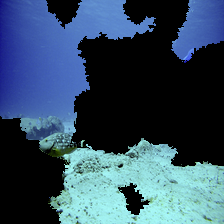

  coral reef: 46.58%
   jellyfish: 31.51%
 scuba diver:  5.57%
 brain coral:  5.11%
     volcano:  3.27%
sea cucumber:  1.08%
    lionfish:  0.95%
  promontory:  0.41%
       wreck:  0.40%
       cliff:  0.37%



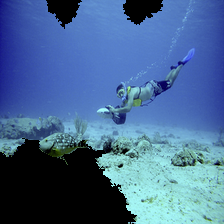

    snorkel: 43.30%
 coral reef: 33.04%
scuba diver: 19.52%
   lionfish:  2.13%
 loggerhead:  0.67%
        ski:  0.28%
  sea snake:  0.19%
rock beauty:  0.13%
      cliff:  0.08%
      wreck:  0.06%



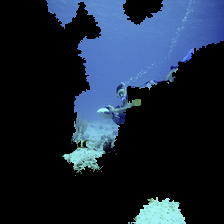

scuba diver: 84.21%
 coral reef:  9.02%
      wreck:  3.41%
   lionfish:  0.91%
  jellyfish:  0.75%
    snorkel:  0.22%
    volcano:  0.21%
brain coral:  0.20%
     castle:  0.11%
      cliff:  0.11%



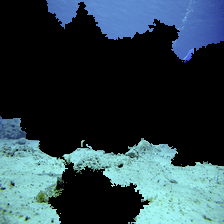

       cliff: 31.47%
  coral reef: 18.77%
       wreck: 11.13%
  promontory:  8.91%
     volcano:  6.56%
   jellyfish:  3.55%
sea cucumber:  3.11%
    lakeside:  1.92%
         alp:  1.67%
 scuba diver:  1.60%



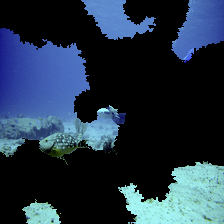

  coral reef: 61.62%
   jellyfish: 16.14%
sea cucumber:  3.51%
 brain coral:  3.21%
     volcano:  3.05%
 scuba diver:  2.20%
  promontory:  0.77%
    lionfish:  0.72%
       cliff:  0.54%
  toy poodle:  0.39%



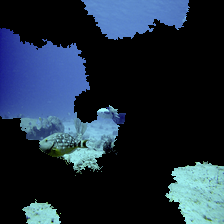

  coral reef: 33.81%
     volcano: 16.70%
   jellyfish: 10.39%
       cliff:  7.73%
 scuba diver:  3.99%
  promontory:  3.27%
 brain coral:  3.11%
       wreck:  2.84%
sea cucumber:  1.70%
      geyser:  1.70%



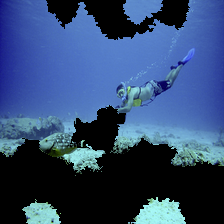

  coral reef: 57.73%
 scuba diver: 30.83%
    lionfish:  6.21%
     snorkel:  3.27%
      puffer:  0.42%
   sea snake:  0.37%
  loggerhead:  0.27%
 brain coral:  0.12%
  hammerhead:  0.11%
electric ray:  0.07%



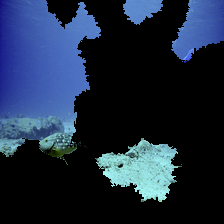

 coral reef: 45.99%
  jellyfish: 20.61%
    volcano: 16.11%
brain coral:  2.88%
 promontory:  1.45%
   lakeside:  1.30%
scuba diver:  1.28%
      cliff:  1.14%
     geyser:  0.91%
     valley:  0.48%



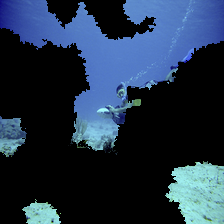

 scuba diver: 71.09%
  coral reef: 14.35%
       wreck:  1.87%
      castle:  1.79%
     volcano:  1.51%
   jellyfish:  1.16%
    lionfish:  1.06%
       cliff:  0.94%
analog clock:  0.50%
 brain coral:  0.46%



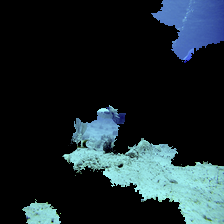

  jellyfish: 44.26%
 coral reef: 13.10%
    volcano:  9.10%
      conch:  4.11%
brain coral:  3.30%
 promontory:  2.27%
      wreck:  2.09%
     valley:  1.64%
      cliff:  1.60%
     geyser:  0.90%



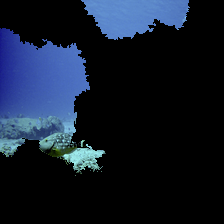

 coral reef: 22.84%
    volcano: 21.32%
      cliff: 11.00%
   lakeside:  6.04%
 promontory:  5.01%
        alp:  4.72%
  jellyfish:  3.41%
scuba diver:  3.40%
      wreck:  3.08%
     geyser:  2.87%



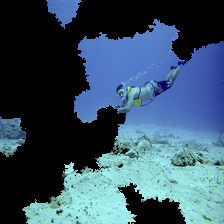

    snorkel: 51.87%
scuba diver: 28.79%
 coral reef: 12.52%
   lionfish:  2.75%
  sea snake:  0.67%
  jellyfish:  0.54%
green snake:  0.33%
brain coral:  0.25%
  parachute:  0.24%
     bubble:  0.20%



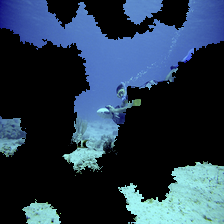

 scuba diver: 85.37%
  coral reef:  6.21%
       wreck:  1.54%
    lionfish:  1.01%
        jeep:  0.63%
sea cucumber:  0.47%
      castle:  0.45%
 brain coral:  0.44%
     snorkel:  0.41%
     volcano:  0.38%



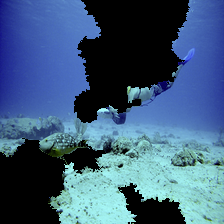

  coral reef: 32.47%
sea cucumber: 23.31%
   jellyfish: 17.96%
    lionfish:  4.81%
 scuba diver:  3.86%
     snorkel:  1.69%
    sea slug:  1.58%
      chiton:  1.46%
 brain coral:  1.45%
   parachute:  1.45%



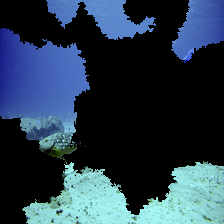

  coral reef: 51.82%
   jellyfish:  9.08%
sea cucumber:  9.00%
     volcano:  7.89%
 brain coral:  3.95%
  promontory:  2.51%
 scuba diver:  1.87%
       cliff:  1.57%
    lakeside:  0.70%
  toy poodle:  0.54%



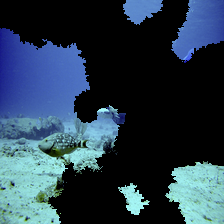

  coral reef: 52.59%
   jellyfish:  8.25%
sea cucumber:  7.83%
     volcano:  4.72%
 brain coral:  4.51%
 scuba diver:  3.96%
     snorkel:  2.37%
   sea snake:  1.61%
       conch:  1.57%
       cliff:  1.52%



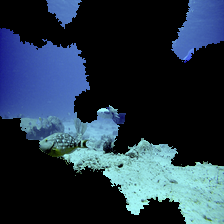

 coral reef: 17.21%
      cliff: 13.68%
    volcano: 11.99%
  jellyfish: 10.97%
 promontory:  5.69%
   lakeside:  3.13%
scuba diver:  2.92%
        alp:  2.75%
brain coral:  2.66%
     valley:  2.44%



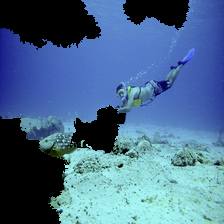

    snorkel: 39.71%
scuba diver: 35.31%
 coral reef: 18.63%
   lionfish:  4.56%
     puffer:  0.26%
  sea snake:  0.26%
brain coral:  0.24%
 loggerhead:  0.13%
  jellyfish:  0.10%
      cliff:  0.08%



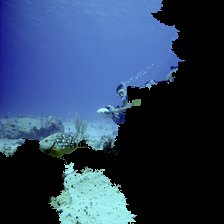

scuba diver: 85.64%
 coral reef: 10.10%
      wreck:  2.54%
   lionfish:  0.31%
brain coral:  0.24%
    snorkel:  0.15%
      cliff:  0.08%
  sea snake:  0.08%
       jeep:  0.07%
  jellyfish:  0.07%



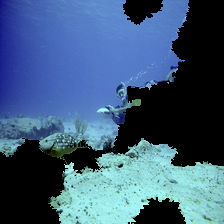

 scuba diver: 90.37%
  coral reef:  7.19%
       wreck:  0.94%
    lionfish:  0.53%
 brain coral:  0.26%
     snorkel:  0.13%
        jeep:  0.09%
     tractor:  0.04%
   sea snake:  0.03%
sea cucumber:  0.03%



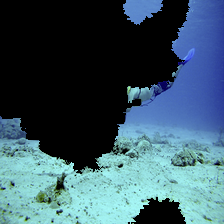

sea cucumber: 32.27%
  coral reef: 17.47%
   jellyfish:  7.46%
       conch:  4.51%
       wreck:  4.06%
       cliff:  3.59%
  promontory:  2.74%
    lionfish:  2.61%
     sandbar:  2.39%
 brain coral:  2.00%



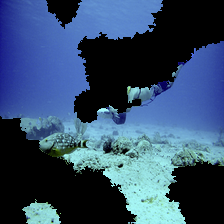

  coral reef: 29.69%
   jellyfish: 25.85%
sea cucumber:  5.21%
    lionfish:  3.63%
       cliff:  3.05%
 brain coral:  2.58%
 scuba diver:  2.37%
     balloon:  2.29%
       wreck:  1.95%
  promontory:  1.92%



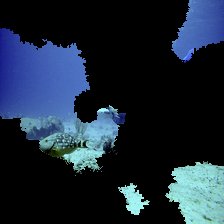

   jellyfish: 30.49%
  coral reef: 24.00%
     volcano:  6.61%
 scuba diver:  5.52%
       cliff:  4.31%
sea cucumber:  2.99%
 brain coral:  2.14%
  promontory:  1.84%
       wreck:  1.64%
     snorkel:  1.48%



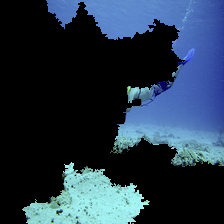

   jellyfish: 22.59%
  coral reef: 14.38%
    lionfish: 12.61%
sea cucumber:  8.67%
       cliff:  4.43%
 scuba diver:  3.93%
       wreck:  3.69%
    sea slug:  2.49%
     volcano:  2.13%
   parachute:  2.03%



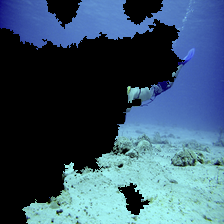

  coral reef: 33.84%
   jellyfish: 20.63%
   parachute:  5.54%
 scuba diver:  4.94%
     snorkel:  3.91%
    lionfish:  3.22%
sea cucumber:  3.10%
  promontory:  2.46%
       cliff:  2.21%
 brain coral:  2.01%



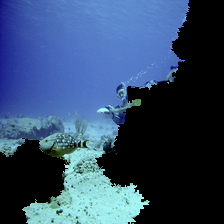

scuba diver: 83.32%
 coral reef:  8.42%
      wreck:  5.57%
   lionfish:  0.50%
    snorkel:  0.33%
       jeep:  0.26%
brain coral:  0.18%
  sea snake:  0.14%
     castle:  0.10%
  jellyfish:  0.09%



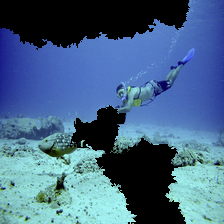

    snorkel: 40.79%
 coral reef: 27.31%
scuba diver: 25.59%
   lionfish:  2.89%
  sea snake:  0.61%
     puffer:  0.37%
 loggerhead:  0.35%
brain coral:  0.22%
      cliff:  0.22%
        ski:  0.19%



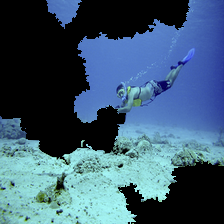

    snorkel: 61.29%
scuba diver: 26.98%
 coral reef:  9.62%
   lionfish:  1.07%
  sea snake:  0.22%
 loggerhead:  0.13%
     puffer:  0.10%
        ski:  0.05%
brain coral:  0.05%
      cliff:  0.05%



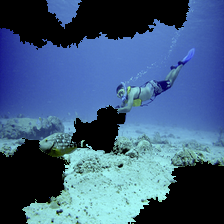

 scuba diver: 48.10%
  coral reef: 25.86%
     snorkel: 22.69%
    lionfish:  1.94%
 brain coral:  0.32%
   sea snake:  0.30%
      puffer:  0.14%
  loggerhead:  0.08%
       cliff:  0.07%
electric ray:  0.05%



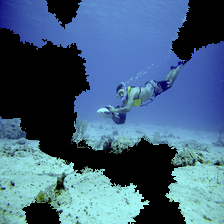

  coral reef: 36.04%
 scuba diver: 29.93%
     snorkel: 27.24%
    lionfish:  3.80%
  loggerhead:  0.41%
   jellyfish:  0.28%
      puffer:  0.27%
sea cucumber:  0.24%
         ski:  0.22%
   sea snake:  0.19%



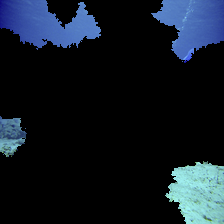

coral reef: 23.12%
     cliff: 14.27%
promontory: 13.58%
   volcano: 10.46%
 jellyfish:  8.88%
  lakeside:  7.05%
    castle:  2.62%
     wreck:  1.60%
  seashore:  1.25%
    geyser:  1.14%



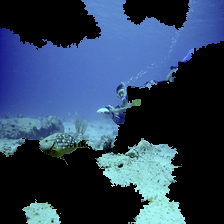

 scuba diver: 76.72%
  coral reef: 17.98%
 brain coral:  1.25%
    lionfish:  0.81%
   jellyfish:  0.79%
       wreck:  0.60%
sea cucumber:  0.29%
     volcano:  0.24%
     snorkel:  0.13%
       conch:  0.11%



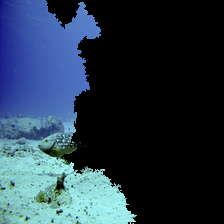

  coral reef: 48.00%
   jellyfish: 13.31%
 scuba diver:  5.97%
     volcano:  5.59%
sea cucumber:  5.27%
 brain coral:  2.91%
  promontory:  2.45%
    lionfish:  2.12%
     snorkel:  2.04%
       wreck:  1.81%



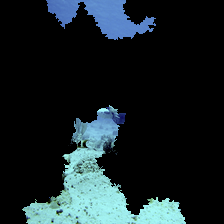

   jellyfish: 50.53%
  coral reef: 14.80%
     volcano:  4.82%
sea cucumber:  3.11%
 brain coral:  2.89%
   sea snake:  2.02%
       conch:  1.46%
    lionfish:  1.39%
       wreck:  1.19%
       cliff:  0.93%



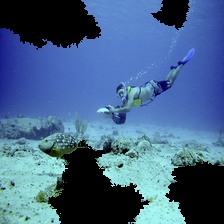

scuba diver: 42.65%
    snorkel: 35.56%
 coral reef: 18.88%
   lionfish:  1.71%
 loggerhead:  0.53%
  sea snake:  0.12%
rock beauty:  0.11%
      wreck:  0.06%
        ski:  0.04%
     puffer:  0.04%



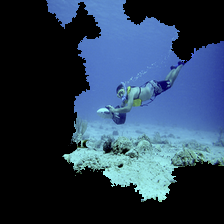

    snorkel: 47.25%
scuba diver: 32.38%
 coral reef: 15.30%
   lionfish:  2.99%
        ski:  0.87%
 loggerhead:  0.24%
rock beauty:  0.11%
  sea snake:  0.10%
      wreck:  0.10%
  parachute:  0.09%



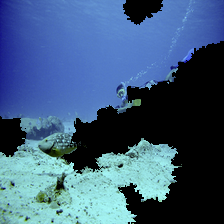

 scuba diver: 71.51%
  coral reef: 20.01%
       wreck:  5.11%
    lionfish:  0.59%
 brain coral:  0.56%
     snorkel:  0.41%
   jellyfish:  0.31%
electric ray:  0.12%
       cliff:  0.10%
   sea snake:  0.10%



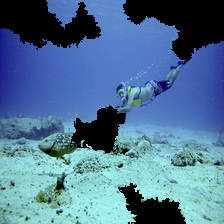

scuba diver: 47.33%
    snorkel: 30.36%
 coral reef: 16.47%
   lionfish:  4.28%
brain coral:  0.24%
  sea snake:  0.20%
      conch:  0.16%
     puffer:  0.11%
  jellyfish:  0.10%
 loggerhead:  0.07%



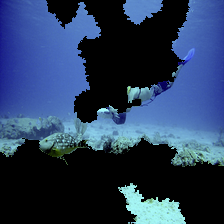

   jellyfish: 51.13%
  coral reef: 29.23%
sea cucumber:  3.57%
   parachute:  3.42%
    lionfish:  3.07%
      chiton:  1.56%
     balloon:  1.10%
    sea slug:  1.08%
       conch:  0.93%
 brain coral:  0.69%



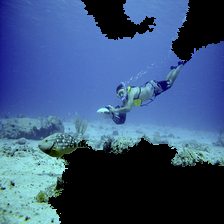

 coral reef: 40.74%
scuba diver: 27.66%
    snorkel: 24.50%
   lionfish:  3.72%
 loggerhead:  1.05%
  sea snake:  0.37%
      wreck:  0.30%
     puffer:  0.17%
        ski:  0.15%
rock beauty:  0.13%



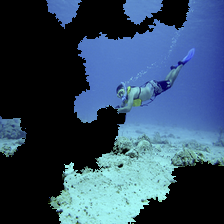

    snorkel: 49.90%
scuba diver: 28.78%
 coral reef: 17.86%
   lionfish:  1.94%
  sea snake:  0.46%
 loggerhead:  0.16%
     puffer:  0.14%
green snake:  0.09%
brain coral:  0.07%
        ski:  0.06%



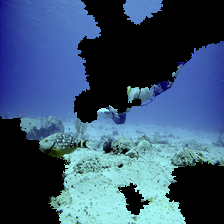

  coral reef: 40.70%
   jellyfish: 26.04%
sea cucumber:  3.18%
    lionfish:  3.10%
 brain coral:  2.51%
 scuba diver:  2.27%
     balloon:  2.24%
   parachute:  1.55%
     snorkel:  1.41%
       conch:  1.04%



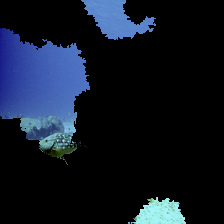

  jellyfish: 35.84%
 coral reef: 28.37%
    volcano:  7.31%
scuba diver:  2.92%
   lionfish:  2.77%
   lakeside:  1.91%
     castle:  1.51%
   fountain:  0.89%
      cliff:  0.85%
     bubble:  0.62%



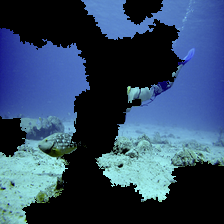

  coral reef: 44.22%
   jellyfish: 12.49%
    lionfish:  8.06%
       conch:  5.33%
 scuba diver:  3.81%
       wreck:  3.65%
 brain coral:  2.55%
     volcano:  1.71%
sea cucumber:  1.66%
  promontory:  1.49%



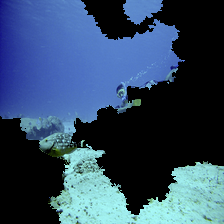

scuba diver: 56.65%
 coral reef: 13.80%
      wreck:  8.17%
     castle:  5.33%
   lionfish:  3.29%
       jeep:  1.56%
      cliff:  1.32%
    volcano:  0.77%
  jellyfish:  0.76%
brain coral:  0.48%



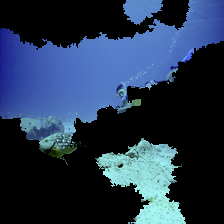

scuba diver: 52.74%
 coral reef: 35.59%
      wreck:  1.73%
   lionfish:  1.50%
  jellyfish:  1.43%
     castle:  0.73%
       jeep:  0.69%
   broccoli:  0.60%
brain coral:  0.55%
    volcano:  0.52%



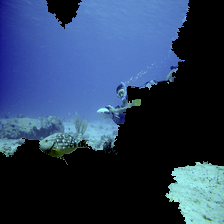

scuba diver: 82.27%
 coral reef:  8.40%
      wreck:  3.54%
   lionfish:  0.84%
     castle:  0.63%
  jellyfish:  0.42%
      cliff:  0.41%
    snorkel:  0.41%
   lakeside:  0.38%
    volcano:  0.30%



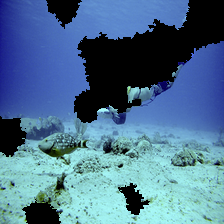

  coral reef: 35.70%
   jellyfish: 16.40%
sea cucumber:  8.84%
 scuba diver:  5.39%
    lionfish:  4.62%
   parachute:  2.93%
     snorkel:  2.77%
 brain coral:  2.53%
       conch:  2.18%
       wreck:  1.41%



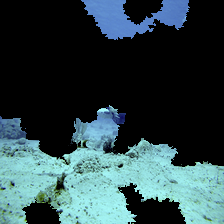

 coral reef: 32.44%
  jellyfish: 11.90%
    volcano:  8.54%
      conch:  7.49%
 promontory:  4.43%
      cliff:  3.50%
brain coral:  3.32%
     valley:  2.03%
      wreck:  1.67%
   stingray:  1.38%



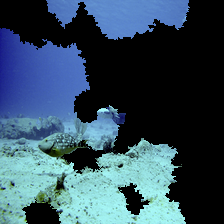

  coral reef: 79.08%
 scuba diver:  4.56%
 brain coral:  3.10%
     volcano:  1.84%
   jellyfish:  1.73%
sea cucumber:  1.27%
   sea snake:  1.21%
    lionfish:  1.19%
       wreck:  1.04%
       cliff:  0.61%



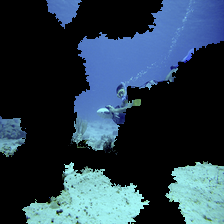

 scuba diver: 86.74%
  coral reef:  6.05%
       wreck:  1.08%
    lionfish:  0.93%
        jeep:  0.62%
       cliff:  0.52%
sea cucumber:  0.47%
     volcano:  0.42%
 brain coral:  0.42%
      castle:  0.37%



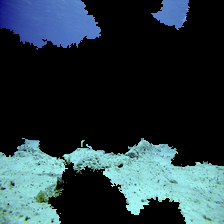

  coral reef: 27.15%
     volcano: 17.92%
   jellyfish:  9.56%
       cliff:  7.02%
      valley:  4.24%
 brain coral:  3.63%
         alp:  2.61%
  promontory:  2.57%
    lakeside:  1.62%
sea cucumber:  1.57%



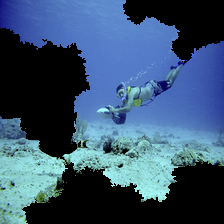

     snorkel: 64.64%
 scuba diver: 20.92%
  coral reef: 11.37%
    lionfish:  1.60%
         ski:  0.21%
       cliff:  0.15%
sea cucumber:  0.11%
  loggerhead:  0.10%
       wreck:  0.09%
   sea snake:  0.07%



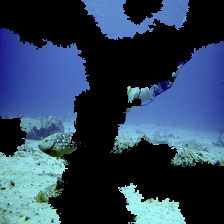

  coral reef: 38.19%
   jellyfish: 18.05%
    lionfish:  7.13%
       conch:  3.35%
       wreck:  3.16%
 brain coral:  3.04%
 scuba diver:  2.57%
     volcano:  1.96%
sea cucumber:  1.79%
       cliff:  1.47%



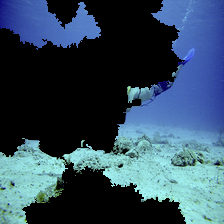

  coral reef: 24.98%
   jellyfish: 19.36%
 scuba diver:  6.93%
     snorkel:  5.34%
       cliff:  4.63%
    lionfish:  4.55%
 brain coral:  4.27%
sea cucumber:  3.53%
       conch:  2.40%
  promontory:  1.89%



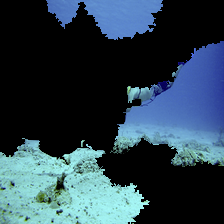

  coral reef: 18.24%
   jellyfish: 17.46%
sea cucumber:  8.46%
       cliff:  5.72%
    lionfish:  4.48%
 brain coral:  3.52%
   sea snake:  2.83%
     volcano:  2.62%
   parachute:  2.45%
       wreck:  2.15%



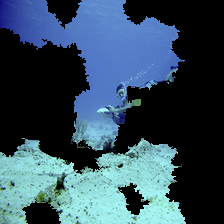

 scuba diver: 92.61%
  coral reef:  5.23%
    lionfish:  0.49%
 brain coral:  0.41%
       wreck:  0.25%
   jellyfish:  0.21%
     snorkel:  0.11%
     volcano:  0.10%
sea cucumber:  0.07%
        jeep:  0.05%



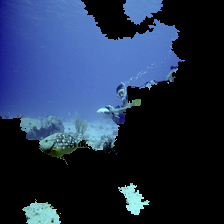

scuba diver: 72.44%
 coral reef: 14.78%
      wreck:  2.88%
     castle:  1.69%
   lionfish:  1.35%
  jellyfish:  0.99%
       jeep:  0.48%
   lakeside:  0.37%
      cliff:  0.33%
    volcano:  0.29%



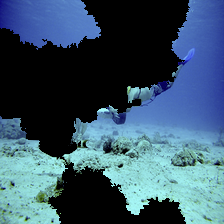

sea cucumber: 19.39%
   jellyfish: 14.69%
  coral reef: 13.51%
       cliff:  5.74%
   parachute:  5.31%
  promontory:  4.53%
       conch:  3.02%
     balloon:  2.24%
     snorkel:  2.21%
         alp:  1.74%



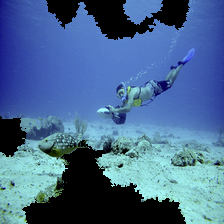

    snorkel: 40.56%
scuba diver: 28.35%
 coral reef: 25.94%
   lionfish:  2.98%
        ski:  0.75%
 loggerhead:  0.40%
  sea snake:  0.16%
      wreck:  0.14%
rock beauty:  0.13%
      cliff:  0.06%



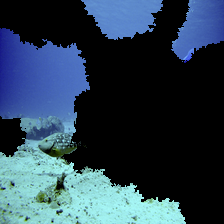

  coral reef: 52.19%
  promontory:  5.97%
   jellyfish:  5.82%
     volcano:  5.33%
 scuba diver:  3.74%
       wreck:  3.04%
 brain coral:  2.24%
    lakeside:  2.15%
sea cucumber:  2.08%
       cliff:  1.79%



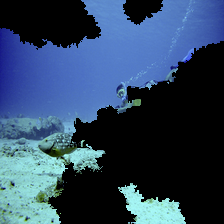

scuba diver: 51.05%
 coral reef: 33.44%
      wreck:  5.18%
  jellyfish:  2.35%
   lionfish:  2.30%
brain coral:  0.93%
    volcano:  0.80%
      cliff:  0.57%
    snorkel:  0.48%
   lakeside:  0.31%



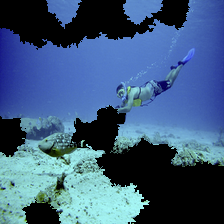

  coral reef: 60.16%
 scuba diver: 21.25%
     snorkel: 12.23%
    lionfish:  3.60%
      puffer:  0.57%
   sea snake:  0.52%
  loggerhead:  0.32%
 brain coral:  0.21%
electric ray:  0.14%
  hammerhead:  0.11%



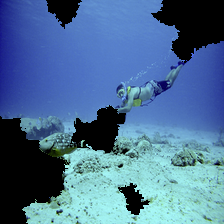

scuba diver: 74.29%
    snorkel: 11.77%
 coral reef:  9.97%
   lionfish:  2.33%
brain coral:  0.30%
  jellyfish:  0.21%
  sea snake:  0.15%
      wreck:  0.09%
      conch:  0.07%
     puffer:  0.07%



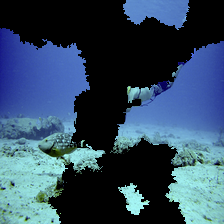

  coral reef: 24.81%
   jellyfish: 11.73%
       cliff:  6.55%
 brain coral:  5.21%
    lionfish:  4.34%
 scuba diver:  4.13%
     volcano:  3.67%
sea cucumber:  3.50%
  promontory:  2.57%
    lakeside:  2.20%



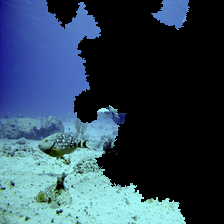

  coral reef: 53.64%
   jellyfish:  8.65%
 scuba diver:  8.53%
sea cucumber:  5.40%
 brain coral:  4.95%
     snorkel:  3.42%
    lionfish:  3.10%
   sea snake:  2.04%
       conch:  1.88%
  loggerhead:  0.96%



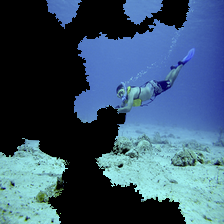

    snorkel: 49.62%
scuba diver: 33.52%
 coral reef: 12.53%
   lionfish:  2.39%
  sea snake:  0.43%
 loggerhead:  0.27%
green snake:  0.16%
     puffer:  0.13%
brain coral:  0.10%
        ski:  0.09%



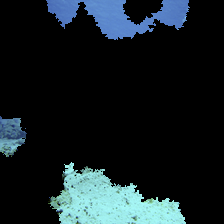

     volcano: 31.83%
   jellyfish: 11.43%
       cliff:  7.91%
  coral reef:  6.80%
    lakeside:  6.55%
  promontory:  4.16%
      geyser:  2.51%
         alp:  2.10%
coral fungus:  0.90%
 brain coral:  0.89%



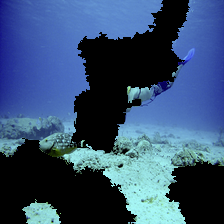

  coral reef: 32.80%
sea cucumber: 14.12%
   jellyfish:  9.90%
    lionfish:  9.12%
 scuba diver:  6.65%
       wreck:  3.79%
       conch:  3.78%
 brain coral:  2.40%
     volcano:  1.76%
       cliff:  1.36%



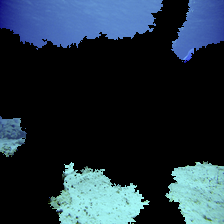

  coral reef: 24.39%
     volcano: 22.05%
  promontory: 13.73%
    lakeside:  7.83%
   jellyfish:  6.39%
       cliff:  4.51%
sea cucumber:  1.69%
coral fungus:  1.40%
 brain coral:  1.01%
  toy poodle:  1.00%



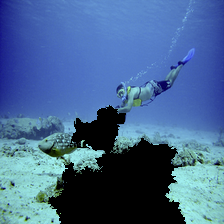

scuba diver: 36.91%
    snorkel: 34.60%
 coral reef: 19.82%
 loggerhead:  2.20%
   lionfish:  1.37%
  sea snake:  0.68%
      cliff:  0.62%
 hammerhead:  0.42%
      wreck:  0.39%
     puffer:  0.28%



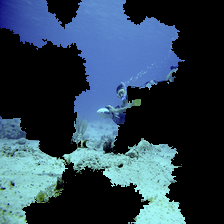

scuba diver: 91.11%
 coral reef:  5.02%
      wreck:  0.60%
   lionfish:  0.53%
       jeep:  0.51%
brain coral:  0.39%
    snorkel:  0.31%
  jellyfish:  0.22%
    volcano:  0.21%
    tractor:  0.11%



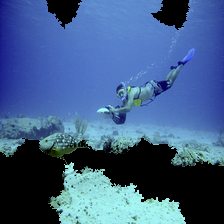

 coral reef: 52.50%
scuba diver: 30.85%
    snorkel: 12.75%
   lionfish:  2.26%
 loggerhead:  0.73%
rock beauty:  0.15%
  sea snake:  0.13%
     puffer:  0.07%
        ski:  0.07%
     dugong:  0.07%



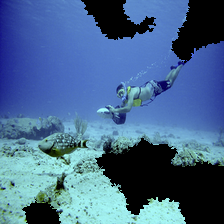

  coral reef: 58.10%
 scuba diver: 22.95%
     snorkel: 11.41%
    lionfish:  4.38%
  loggerhead:  0.99%
   sea snake:  0.49%
      puffer:  0.37%
 rock beauty:  0.22%
anemone fish:  0.17%
       wreck:  0.12%



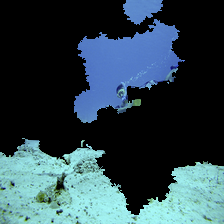

scuba diver: 75.61%
 coral reef:  7.29%
   lionfish:  2.26%
      wreck:  2.11%
       jeep:  1.16%
     castle:  1.04%
    tractor:  0.98%
  jellyfish:  0.73%
   snowplow:  0.66%
       tank:  0.58%



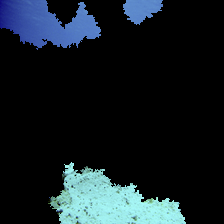

     volcano: 32.93%
   jellyfish: 12.27%
  coral reef:  6.52%
    lakeside:  4.46%
      geyser:  2.46%
coral fungus:  2.16%
       cliff:  1.91%
  promontory:  1.36%
    mushroom:  1.24%
         alp:  1.19%



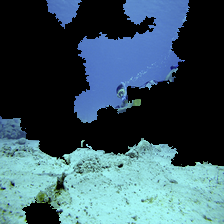

 scuba diver: 72.43%
  coral reef:  9.86%
        jeep:  3.20%
       wreck:  2.94%
    lionfish:  2.06%
      castle:  1.28%
     tractor:  0.66%
       cliff:  0.57%
analog clock:  0.39%
     snorkel:  0.38%



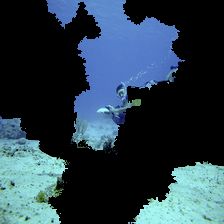

 scuba diver: 86.24%
       wreck:  4.48%
  coral reef:  2.84%
      castle:  1.23%
     volcano:  1.08%
       cliff:  0.92%
    lionfish:  0.44%
        jeep:  0.34%
     snorkel:  0.24%
sea cucumber:  0.22%



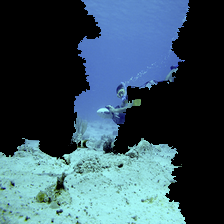

 scuba diver: 96.83%
        jeep:  1.16%
  coral reef:  0.55%
       wreck:  0.37%
    lionfish:  0.26%
     snorkel:  0.13%
    snowplow:  0.08%
     tractor:  0.07%
sea cucumber:  0.07%
 brain coral:  0.06%



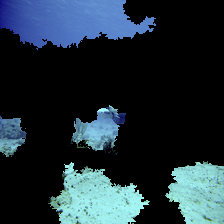

  coral reef: 42.66%
     volcano: 17.84%
   jellyfish: 14.84%
 brain coral:  3.31%
       cliff:  2.53%
  promontory:  2.14%
sea cucumber:  1.82%
   sea snake:  1.27%
       wreck:  1.18%
    lakeside:  1.13%



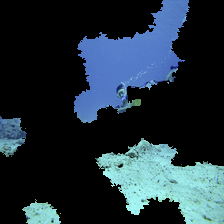

 scuba diver: 75.54%
  coral reef:  7.47%
       wreck:  3.52%
      castle:  1.73%
     volcano:  1.33%
       cliff:  1.24%
        jeep:  0.99%
    lionfish:  0.81%
   jellyfish:  0.59%
analog clock:  0.44%



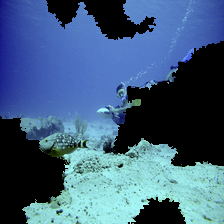

 scuba diver: 84.06%
  coral reef: 10.87%
        jeep:  1.26%
       wreck:  1.08%
    lionfish:  0.56%
 brain coral:  0.42%
sea cucumber:  0.19%
     tractor:  0.15%
     snorkel:  0.14%
      castle:  0.12%



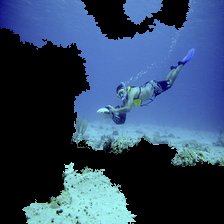

 coral reef: 50.71%
scuba diver: 23.08%
    snorkel: 20.98%
   lionfish:  3.79%
 loggerhead:  0.54%
     puffer:  0.17%
  sea snake:  0.16%
rock beauty:  0.09%
        ski:  0.07%
brain coral:  0.05%



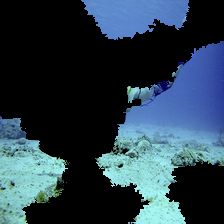

       cliff: 20.35%
  coral reef: 12.28%
       wreck: 10.44%
sea cucumber:  5.73%
  promontory:  5.06%
   jellyfish:  3.16%
 brain coral:  2.30%
       conch:  2.21%
    lakeside:  2.19%
     sandbar:  2.13%



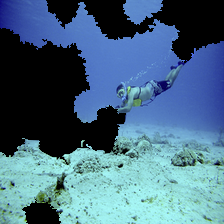

    snorkel: 45.62%
scuba diver: 29.51%
 coral reef: 16.02%
   lionfish:  4.62%
  jellyfish:  0.75%
  sea snake:  0.64%
brain coral:  0.46%
green snake:  0.31%
     puffer:  0.25%
      conch:  0.20%



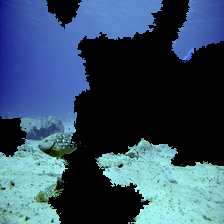

  coral reef: 50.82%
   jellyfish: 10.44%
 scuba diver:  7.26%
       wreck:  4.87%
  promontory:  4.21%
 brain coral:  3.54%
     volcano:  3.06%
sea cucumber:  2.81%
       cliff:  1.75%
       conch:  1.46%



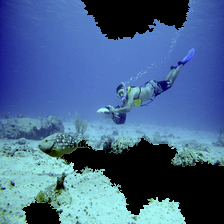

 coral reef: 47.63%
    snorkel: 26.50%
scuba diver: 20.74%
   lionfish:  2.68%
 loggerhead:  0.89%
  sea snake:  0.47%
     puffer:  0.16%
rock beauty:  0.12%
        ski:  0.11%
      wreck:  0.06%



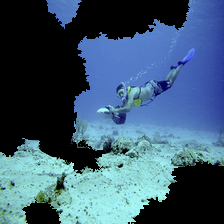

    snorkel: 51.16%
scuba diver: 34.00%
 coral reef: 11.74%
   lionfish:  1.92%
 loggerhead:  0.36%
        ski:  0.26%
  sea snake:  0.16%
rock beauty:  0.06%
     puffer:  0.05%
      wreck:  0.03%



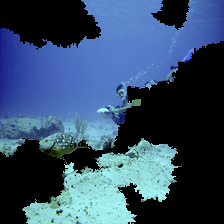

 scuba diver: 87.82%
  coral reef:  9.85%
       wreck:  0.77%
 brain coral:  0.35%
    lionfish:  0.33%
sea cucumber:  0.23%
     snorkel:  0.13%
   jellyfish:  0.08%
        jeep:  0.05%
   sea snake:  0.04%



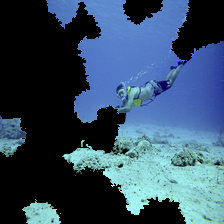

scuba diver: 46.51%
 coral reef: 22.08%
    snorkel: 19.78%
   lionfish:  7.46%
  jellyfish:  1.39%
      conch:  0.36%
     puffer:  0.35%
  sea snake:  0.24%
brain coral:  0.24%
green snake:  0.15%



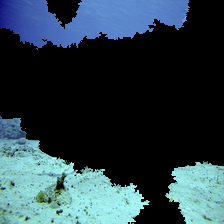

  promontory: 31.88%
       cliff: 17.34%
     volcano: 13.43%
  coral reef: 10.55%
   jellyfish:  4.97%
    lakeside:  2.90%
sea cucumber:  2.34%
 brain coral:  1.43%
         alp:  1.13%
    seashore:  0.89%



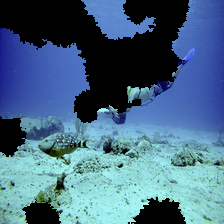

  coral reef: 53.02%
   jellyfish: 14.52%
sea cucumber:  7.86%
    lionfish:  3.78%
 brain coral:  2.63%
       conch:  2.44%
     snorkel:  1.84%
   parachute:  1.27%
      chiton:  1.13%
 scuba diver:  1.05%



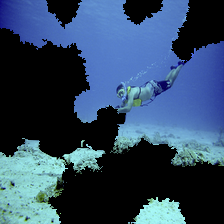

 coral reef: 63.79%
scuba diver: 16.56%
    snorkel:  6.13%
   lionfish:  4.76%
  jellyfish:  4.73%
     puffer:  0.95%
brain coral:  0.53%
  sea snake:  0.47%
      conch:  0.30%
green snake:  0.23%



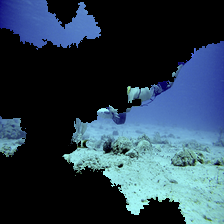

 parachute: 21.50%
 jellyfish: 20.27%
   balloon: 11.27%
       alp:  7.16%
coral reef:  5.98%
     cliff:  3.52%
promontory:  3.44%
  lakeside:  2.76%
    valley:  2.20%
     conch:  2.12%



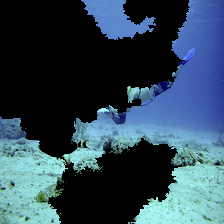

   jellyfish: 26.54%
  coral reef: 14.89%
       cliff: 10.63%
sea cucumber:  5.89%
  promontory:  5.49%
     balloon:  4.31%
       conch:  2.91%
   parachute:  2.63%
    lakeside:  1.63%
       wreck:  1.61%



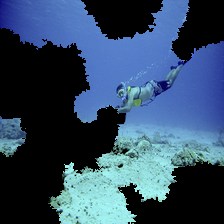

scuba diver: 35.48%
    snorkel: 29.32%
 coral reef: 27.25%
   lionfish:  4.08%
  jellyfish:  1.10%
  sea snake:  0.53%
brain coral:  0.27%
green snake:  0.21%
     puffer:  0.15%
     bubble:  0.15%



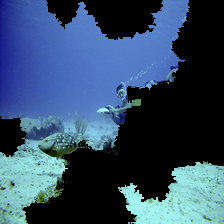

 scuba diver: 84.61%
  coral reef:  6.55%
       wreck:  1.92%
    lionfish:  1.60%
        jeep:  0.60%
     snorkel:  0.49%
      castle:  0.46%
 brain coral:  0.34%
sea cucumber:  0.32%
       cliff:  0.23%



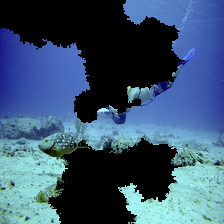

   jellyfish: 45.83%
  coral reef: 13.96%
sea cucumber: 10.57%
   parachute:  5.98%
    lionfish:  4.17%
    sea slug:  2.33%
 brain coral:  2.00%
       conch:  1.88%
     balloon:  1.71%
     snorkel:  1.57%



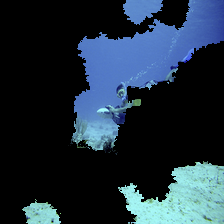

 scuba diver: 87.98%
  coral reef:  3.45%
       wreck:  1.21%
    lionfish:  1.17%
        jeep:  0.53%
      castle:  0.41%
   jellyfish:  0.36%
     volcano:  0.32%
sea cucumber:  0.29%
 brain coral:  0.28%



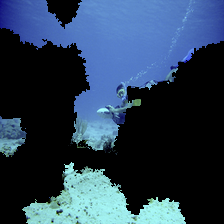

scuba diver: 85.68%
 coral reef:  9.40%
      wreck:  1.87%
   lionfish:  0.41%
      cliff:  0.35%
    snorkel:  0.26%
  jellyfish:  0.25%
brain coral:  0.24%
    volcano:  0.20%
       jeep:  0.17%



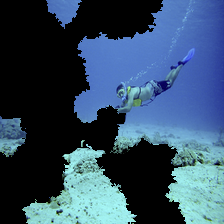

    snorkel: 37.20%
 coral reef: 32.36%
scuba diver: 25.39%
   lionfish:  1.36%
  sea snake:  0.89%
     puffer:  0.36%
  jellyfish:  0.27%
 loggerhead:  0.26%
      cliff:  0.20%
brain coral:  0.15%



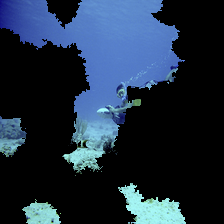

scuba diver: 82.40%
 coral reef:  9.03%
      wreck:  2.81%
  jellyfish:  1.18%
    volcano:  0.79%
   lionfish:  0.48%
     castle:  0.36%
brain coral:  0.33%
    snorkel:  0.29%
      cliff:  0.28%



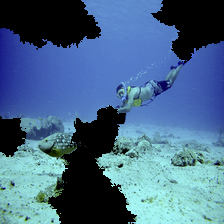

 scuba diver: 56.80%
     snorkel: 21.87%
  coral reef: 14.50%
    lionfish:  2.42%
 brain coral:  0.51%
   sea snake:  0.50%
   jellyfish:  0.44%
sea cucumber:  0.42%
       conch:  0.30%
       wreck:  0.28%



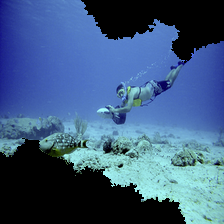

    snorkel: 47.97%
scuba diver: 26.42%
 coral reef: 20.03%
        ski:  1.65%
   lionfish:  1.37%
  sea snake:  0.37%
 loggerhead:  0.31%
      cliff:  0.19%
      wreck:  0.19%
  parachute:  0.15%



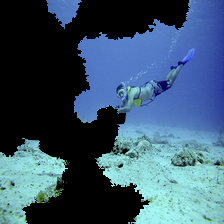

    snorkel: 50.38%
scuba diver: 35.86%
 coral reef: 10.49%
   lionfish:  1.68%
  sea snake:  0.43%
 loggerhead:  0.14%
      cliff:  0.10%
     puffer:  0.10%
brain coral:  0.09%
green snake:  0.09%



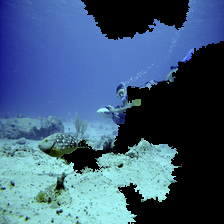

 scuba diver: 88.37%
  coral reef:  7.56%
       wreck:  1.36%
    lionfish:  0.64%
        jeep:  0.59%
 brain coral:  0.27%
     snorkel:  0.22%
   sea snake:  0.10%
sea cucumber:  0.09%
   jellyfish:  0.08%



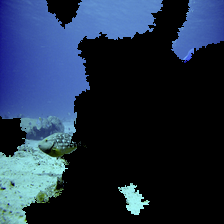

 coral reef: 41.92%
  jellyfish: 18.63%
scuba diver:  8.96%
      wreck:  5.22%
    volcano:  3.30%
 promontory:  3.30%
brain coral:  1.92%
      cliff:  1.88%
    snorkel:  1.35%
   lakeside:  1.28%



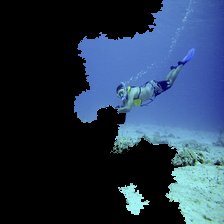

scuba diver: 41.72%
    snorkel: 36.34%
 coral reef: 16.96%
   lionfish:  1.60%
 loggerhead:  0.63%
  sea snake:  0.59%
     puffer:  0.48%
  jellyfish:  0.16%
 hammerhead:  0.16%
      wreck:  0.12%



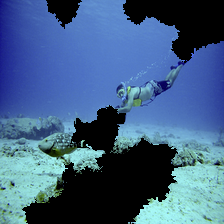

scuba diver: 37.77%
 coral reef: 35.36%
    snorkel: 18.33%
   lionfish:  3.18%
  jellyfish:  0.93%
      cliff:  0.64%
brain coral:  0.55%
  sea snake:  0.40%
      conch:  0.28%
      wreck:  0.22%



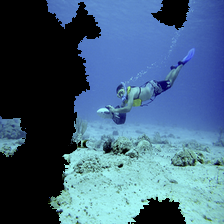

    snorkel: 42.13%
scuba diver: 40.19%
 coral reef: 14.18%
   lionfish:  2.31%
 loggerhead:  0.52%
        ski:  0.25%
  sea snake:  0.10%
rock beauty:  0.07%
     puffer:  0.04%
      wreck:  0.03%



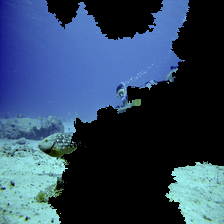

scuba diver: 67.78%
 coral reef: 15.85%
      wreck:  5.72%
   lionfish:  3.03%
    volcano:  1.07%
  jellyfish:  1.04%
      cliff:  0.85%
brain coral:  0.72%
     castle:  0.67%
    snorkel:  0.58%



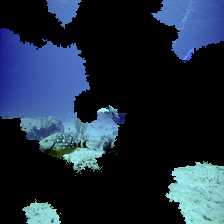

  coral reef: 29.76%
   jellyfish: 21.22%
 scuba diver: 11.27%
     volcano:  8.48%
 brain coral:  3.66%
       cliff:  3.28%
       wreck:  2.60%
sea cucumber:  2.17%
    lionfish:  1.43%
  promontory:  1.28%



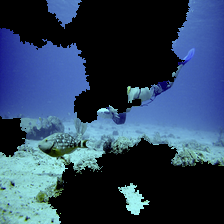

   jellyfish: 45.15%
  coral reef: 14.85%
sea cucumber: 11.24%
   parachute:  6.70%
     balloon:  6.62%
    lionfish:  2.44%
       conch:  1.61%
      chiton:  1.22%
    sea slug:  1.09%
 brain coral:  0.94%



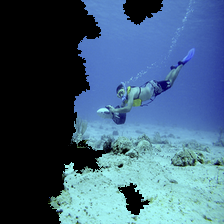

    snorkel: 49.62%
scuba diver: 33.84%
 coral reef: 11.76%
   lionfish:  3.15%
 loggerhead:  0.55%
        ski:  0.49%
rock beauty:  0.16%
  sea snake:  0.08%
     puffer:  0.07%
      wreck:  0.05%



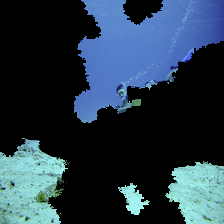

 scuba diver: 80.55%
  coral reef:  6.26%
       wreck:  3.77%
    lionfish:  3.07%
   jellyfish:  1.68%
       cliff:  0.58%
     volcano:  0.50%
 brain coral:  0.39%
      castle:  0.37%
sea cucumber:  0.30%



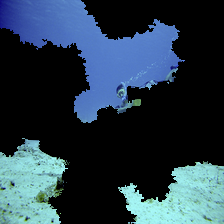

 scuba diver: 79.55%
  coral reef:  5.69%
       wreck:  1.87%
    lionfish:  1.70%
       cliff:  1.25%
      castle:  1.13%
     volcano:  1.07%
   jellyfish:  0.60%
 brain coral:  0.39%
sea cucumber:  0.39%



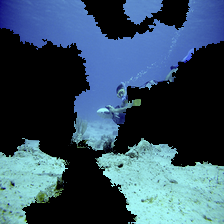

 scuba diver: 91.54%
        jeep:  2.83%
  coral reef:  1.73%
       wreck:  0.77%
sea cucumber:  0.48%
     volcano:  0.31%
    lionfish:  0.31%
 brain coral:  0.29%
       cliff:  0.29%
     snorkel:  0.28%



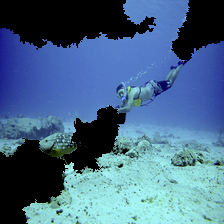

scuba diver: 53.40%
 coral reef: 20.70%
    snorkel: 16.05%
   lionfish:  5.86%
brain coral:  0.54%
  sea snake:  0.53%
     puffer:  0.37%
      conch:  0.37%
  jellyfish:  0.26%
   flatworm:  0.17%



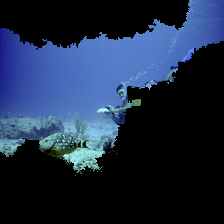

scuba diver: 68.58%
 coral reef: 14.09%
      wreck: 11.24%
   lakeside:  0.69%
     castle:  0.62%
       jeep:  0.61%
    snorkel:  0.43%
      cliff:  0.41%
   lionfish:  0.37%
  jellyfish:  0.29%



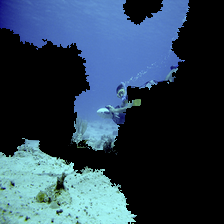

 scuba diver: 79.06%
  coral reef: 11.42%
    lionfish:  1.74%
     snorkel:  1.41%
 brain coral:  1.01%
   jellyfish:  0.88%
       wreck:  0.65%
sea cucumber:  0.63%
     volcano:  0.52%
      castle:  0.22%



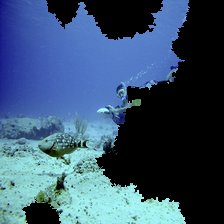

 scuba diver: 77.44%
  coral reef: 15.84%
    lionfish:  2.13%
       wreck:  1.30%
     snorkel:  0.62%
 brain coral:  0.48%
   jellyfish:  0.33%
        jeep:  0.21%
sea cucumber:  0.16%
   sea snake:  0.14%



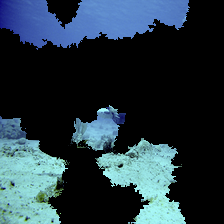

    coral reef: 22.08%
     jellyfish: 20.24%
       volcano: 14.65%
         cliff: 11.69%
    promontory: 10.27%
        valley:  2.96%
   brain coral:  1.63%
           alp:  1.55%
cliff dwelling:  1.33%
      lakeside:  1.33%



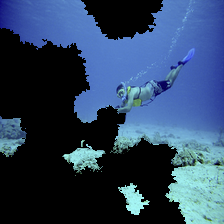

 coral reef: 38.85%
scuba diver: 30.23%
    snorkel: 26.48%
   lionfish:  2.14%
  sea snake:  0.48%
  jellyfish:  0.24%
 loggerhead:  0.20%
     puffer:  0.20%
      cliff:  0.13%
 hammerhead:  0.11%



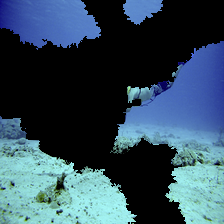

  coral reef: 21.62%
   jellyfish:  9.46%
       cliff:  8.95%
  promontory:  8.74%
    lakeside:  6.97%
sea cucumber:  5.60%
     sandbar:  3.97%
 brain coral:  3.94%
       conch:  3.63%
    seashore:  3.26%



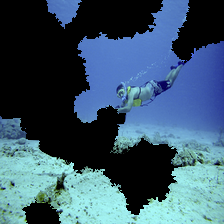

    snorkel: 31.80%
scuba diver: 31.17%
 coral reef: 19.58%
   lionfish:  5.56%
  jellyfish:  2.91%
      conch:  1.56%
  sea snake:  1.39%
brain coral:  0.73%
green snake:  0.60%
     puffer:  0.59%



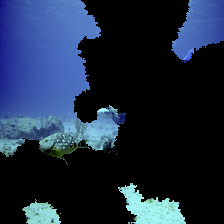

  coral reef: 56.07%
   jellyfish: 16.64%
 scuba diver:  7.41%
     volcano:  2.80%
 brain coral:  2.21%
    lionfish:  1.20%
sea cucumber:  1.17%
       cliff:  0.91%
  promontory:  0.86%
       wreck:  0.80%



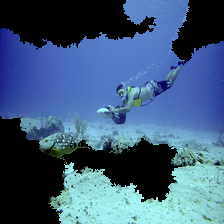

  coral reef: 34.62%
 scuba diver: 32.02%
     snorkel: 23.29%
    lionfish:  5.65%
         ski:  1.11%
  loggerhead:  0.37%
   sea snake:  0.34%
      puffer:  0.26%
 rock beauty:  0.26%
anemone fish:  0.26%



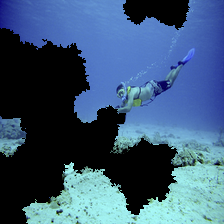

    snorkel: 37.01%
scuba diver: 30.48%
 coral reef: 27.64%
   lionfish:  2.84%
  sea snake:  0.30%
 loggerhead:  0.24%
      cliff:  0.21%
     puffer:  0.19%
brain coral:  0.13%
  jellyfish:  0.12%



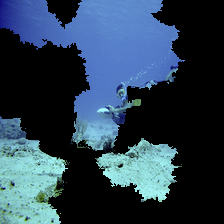

scuba diver: 93.56%
 coral reef:  1.97%
       jeep:  1.16%
      wreck:  1.10%
    volcano:  0.22%
    snorkel:  0.21%
   lionfish:  0.17%
    tractor:  0.16%
     castle:  0.14%
brain coral:  0.13%



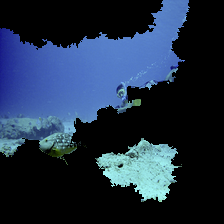

scuba diver: 49.23%
 coral reef: 29.37%
  jellyfish:  2.62%
   broccoli:  2.50%
    volcano:  2.30%
       jeep:  1.33%
      wreck:  1.31%
     castle:  1.10%
      cliff:  1.04%
   lionfish:  1.01%



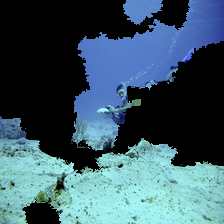

 scuba diver: 85.51%
        jeep:  7.40%
  coral reef:  2.32%
       wreck:  2.30%
    lionfish:  0.40%
     tractor:  0.22%
     snorkel:  0.22%
    snowplow:  0.18%
sea cucumber:  0.17%
 brain coral:  0.17%



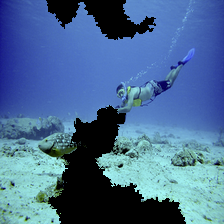

scuba diver: 45.75%
    snorkel: 33.70%
 coral reef: 17.19%
   lionfish:  2.33%
  sea snake:  0.18%
 loggerhead:  0.14%
      wreck:  0.07%
 hammerhead:  0.07%
brain coral:  0.07%
     puffer:  0.07%



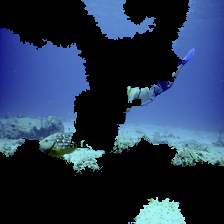

  coral reef: 40.12%
   jellyfish: 33.07%
    lionfish:  7.35%
sea cucumber:  3.05%
 scuba diver:  2.05%
     volcano:  1.86%
       conch:  1.20%
 brain coral:  1.11%
       wreck:  0.75%
    sea slug:  0.69%



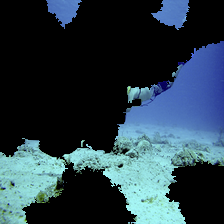

      cliff: 22.06%
 coral reef: 18.06%
scuba diver:  4.87%
    volcano:  4.51%
      wreck:  4.22%
  jellyfish:  4.05%
   lionfish:  2.98%
brain coral:  2.71%
  sea snake:  2.43%
 promontory:  2.29%



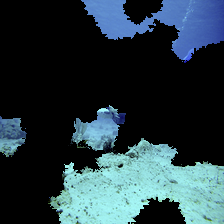

    coral reef: 41.91%
         cliff: 13.89%
       volcano:  9.03%
    promontory:  7.32%
     jellyfish:  4.72%
        valley:  2.74%
         wreck:  2.53%
cliff dwelling:  2.49%
   brain coral:  2.34%
         conch:  1.60%



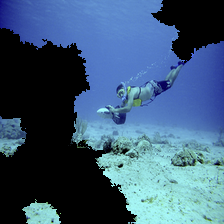

scuba diver: 45.73%
    snorkel: 35.95%
 coral reef: 13.24%
   lionfish:  2.91%
        ski:  0.32%
      wreck:  0.18%
  sea snake:  0.17%
 loggerhead:  0.15%
      cliff:  0.13%
      conch:  0.12%



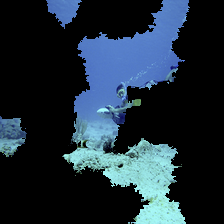

     scuba diver: 92.61%
      coral reef:  2.51%
            jeep:  2.38%
           wreck:  0.60%
        lionfish:  0.26%
         tractor:  0.19%
         snorkel:  0.16%
          castle:  0.15%
            tank:  0.09%
steam locomotive:  0.07%



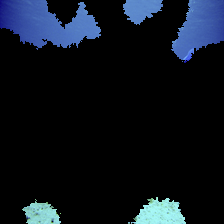

   jellyfish: 29.23%
  coral reef: 19.86%
     volcano:  6.97%
    lakeside:  5.12%
coral fungus:  1.67%
    mushroom:  1.63%
  teddy bear:  1.44%
  promontory:  1.25%
  toy poodle:  1.23%
picket fence:  1.07%



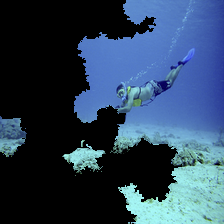

scuba diver: 40.82%
    snorkel: 30.84%
 coral reef: 22.95%
   lionfish:  2.94%
     puffer:  0.42%
 loggerhead:  0.38%
  sea snake:  0.38%
 hammerhead:  0.14%
  jellyfish:  0.11%
      wreck:  0.09%



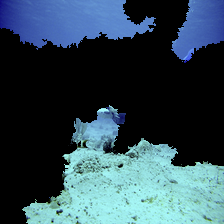

   jellyfish: 24.14%
  coral reef: 11.33%
     volcano:  9.61%
      valley:  7.21%
       conch:  5.35%
  promontory:  3.09%
 brain coral:  2.91%
sea cucumber:  2.38%
    lakeside:  1.78%
         alp:  1.69%



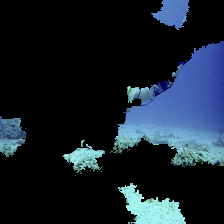

 coral reef: 32.24%
      cliff: 10.43%
      wreck:  7.20%
  jellyfish:  5.84%
scuba diver:  5.19%
  sea snake:  3.37%
   lionfish:  2.37%
 promontory:  2.28%
  parachute:  1.97%
   lakeside:  1.84%



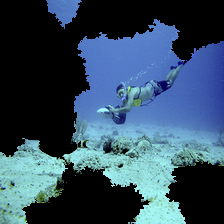

    snorkel: 52.89%
scuba diver: 32.23%
 coral reef: 11.02%
   lionfish:  2.23%
        ski:  0.31%
  sea snake:  0.23%
 loggerhead:  0.18%
rock beauty:  0.10%
brain coral:  0.08%
      wreck:  0.06%



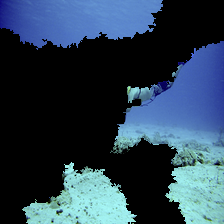

       cliff: 14.84%
  coral reef: 13.98%
  promontory:  8.64%
   jellyfish:  7.56%
    lakeside:  6.93%
     volcano:  6.11%
sea cucumber:  5.98%
   parachute:  3.77%
 brain coral:  2.97%
     sandbar:  2.66%



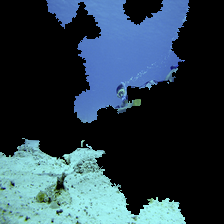

 scuba diver: 67.54%
  coral reef: 16.79%
    lionfish:  4.18%
   jellyfish:  2.04%
     volcano:  1.14%
       wreck:  1.05%
      castle:  0.83%
 brain coral:  0.47%
     tractor:  0.28%
analog clock:  0.28%



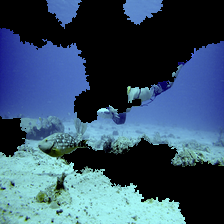

  coral reef: 44.44%
   jellyfish: 14.55%
   parachute: 11.66%
    lionfish:  4.04%
sea cucumber:  3.89%
       conch:  2.84%
     balloon:  2.43%
 brain coral:  2.15%
         alp:  1.11%
    sea slug:  1.04%



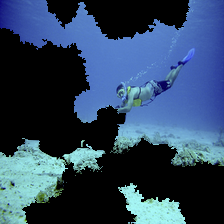

 coral reef: 44.69%
scuba diver: 27.13%
    snorkel: 23.12%
   lionfish:  2.96%
  sea snake:  0.45%
     puffer:  0.31%
  jellyfish:  0.20%
 loggerhead:  0.19%
brain coral:  0.17%
green snake:  0.09%



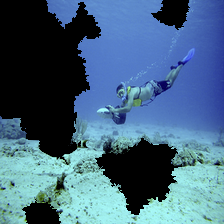

 scuba diver: 68.53%
     snorkel: 17.09%
  coral reef: 10.51%
    lionfish:  2.77%
  loggerhead:  0.38%
      puffer:  0.12%
         ski:  0.08%
       wreck:  0.08%
   sea snake:  0.06%
sea cucumber:  0.04%



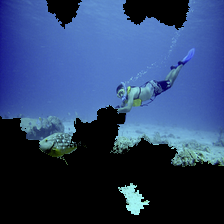

      scuba diver: 41.34%
       coral reef: 40.66%
          snorkel: 10.39%
         lionfish:  4.51%
       loggerhead:  0.45%
           puffer:  0.36%
        jellyfish:  0.28%
        sea snake:  0.27%
great white shark:  0.19%
            cliff:  0.17%



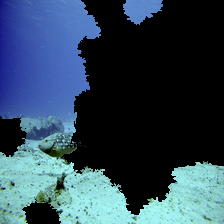

    coral reef: 39.16%
  sea cucumber: 19.95%
   brain coral:  4.94%
   scuba diver:  3.77%
    promontory:  3.36%
     jellyfish:  3.09%
       volcano:  2.96%
Scotch terrier:  1.74%
         cliff:  1.56%
         wreck:  1.29%



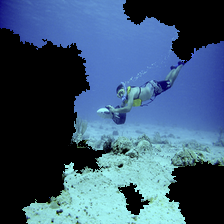

    snorkel: 41.01%
scuba diver: 28.74%
 coral reef: 26.28%
   lionfish:  2.35%
        ski:  0.32%
  sea snake:  0.21%
 loggerhead:  0.20%
rock beauty:  0.09%
  parachute:  0.08%
      wreck:  0.08%



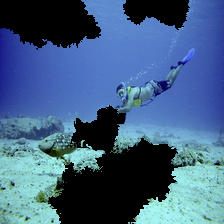

  coral reef: 35.67%
 scuba diver: 32.62%
     snorkel: 26.70%
    lionfish:  2.78%
 brain coral:  0.25%
      puffer:  0.25%
       cliff:  0.24%
   jellyfish:  0.20%
   sea snake:  0.19%
sea cucumber:  0.15%



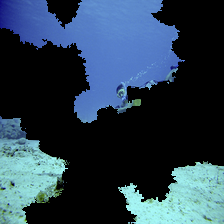

 scuba diver: 76.31%
       wreck:  6.71%
  coral reef:  3.91%
      castle:  1.66%
       cliff:  1.44%
     volcano:  1.35%
    lionfish:  0.95%
analog clock:  0.77%
   jellyfish:  0.58%
 brain coral:  0.42%



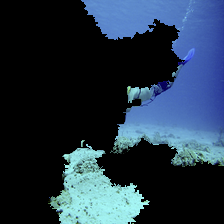

   jellyfish: 26.65%
  coral reef: 17.59%
    lionfish:  9.46%
       cliff:  3.61%
 scuba diver:  3.58%
       wreck:  3.35%
     volcano:  3.04%
sea cucumber:  2.64%
    sea slug:  2.09%
      castle:  1.93%



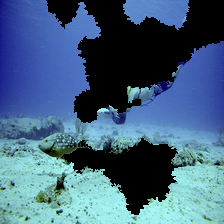

   jellyfish: 37.21%
  coral reef: 29.79%
sea cucumber:  9.15%
   parachute:  3.30%
    lionfish:  2.69%
    sea slug:  2.02%
       conch:  1.93%
 brain coral:  1.42%
     balloon:  1.14%
 scuba diver:  0.78%



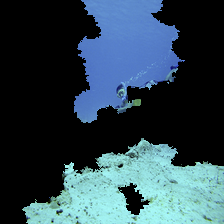

scuba diver: 95.29%
      wreck:  2.06%
 coral reef:  1.21%
   lionfish:  0.49%
  jellyfish:  0.12%
    snorkel:  0.10%
brain coral:  0.07%
      cliff:  0.06%
    volcano:  0.05%
       jeep:  0.04%



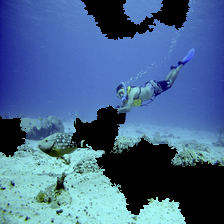

  coral reef: 47.18%
 scuba diver: 29.44%
     snorkel: 14.28%
    lionfish:  5.36%
   sea snake:  0.80%
      puffer:  0.70%
  loggerhead:  0.54%
 brain coral:  0.19%
electric ray:  0.18%
  hammerhead:  0.13%



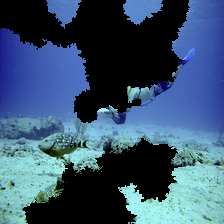

   jellyfish: 39.62%
  coral reef: 20.63%
sea cucumber: 11.90%
   parachute:  6.83%
    lionfish:  3.27%
      chiton:  1.84%
     balloon:  1.70%
       conch:  1.67%
    sea slug:  1.58%
 brain coral:  1.56%



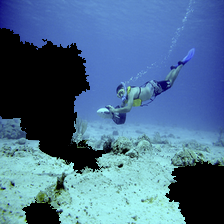

     snorkel: 62.26%
 scuba diver: 26.11%
  coral reef:  8.50%
    lionfish:  1.13%
  loggerhead:  0.67%
         ski:  0.29%
   sea snake:  0.15%
       wreck:  0.12%
sea cucumber:  0.12%
       cliff:  0.11%



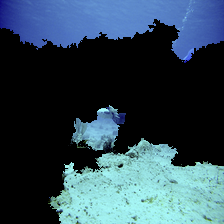

         cliff: 21.56%
       volcano: 15.40%
    promontory: 11.56%
    coral reef:  7.25%
           alp:  5.51%
        valley:  5.14%
         wreck:  4.94%
cliff dwelling:  4.49%
        geyser:  3.69%
     jellyfish:  2.74%



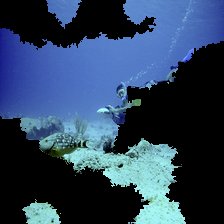

scuba diver: 79.67%
 coral reef: 12.53%
       jeep:  2.96%
      wreck:  1.72%
   lionfish:  0.36%
    tractor:  0.35%
brain coral:  0.26%
     castle:  0.21%
      cliff:  0.16%
       tank:  0.13%



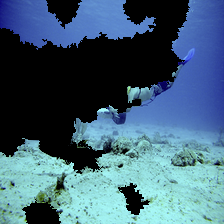

   jellyfish: 35.22%
  coral reef: 24.68%
   parachute:  7.88%
sea cucumber:  6.53%
     balloon:  2.75%
    lionfish:  1.99%
  promontory:  1.67%
     snorkel:  1.42%
       conch:  1.27%
      chiton:  1.16%



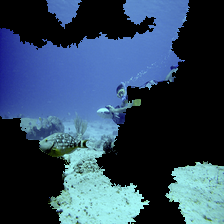

scuba diver: 63.01%
 coral reef: 17.53%
       jeep:  3.35%
      wreck:  1.98%
   lionfish:  1.93%
     castle:  1.77%
    tractor:  1.06%
    volcano:  0.79%
  jellyfish:  0.63%
brain coral:  0.56%



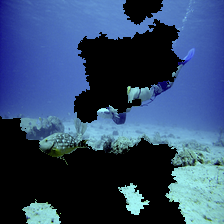

   jellyfish: 72.45%
  coral reef: 15.20%
      chiton:  1.36%
    lionfish:  1.26%
       conch:  1.09%
sea cucumber:  0.95%
     balloon:  0.92%
 scuba diver:  0.72%
   parachute:  0.60%
    sea slug:  0.46%



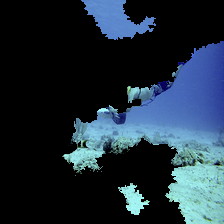

 jellyfish: 41.55%
 parachute: 21.88%
coral reef:  8.12%
   balloon:  5.33%
     cliff:  2.30%
     conch:  1.24%
       alp:  1.12%
promontory:  1.00%
   volcano:  0.99%
  lakeside:  0.98%



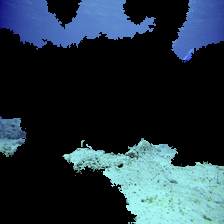

coral reef: 26.72%
 jellyfish: 18.71%
promontory: 13.77%
   volcano:  8.76%
     cliff:  6.45%
  lakeside:  5.41%
    valley:  2.31%
     conch:  1.65%
       alp:  1.61%
  seashore:  1.36%



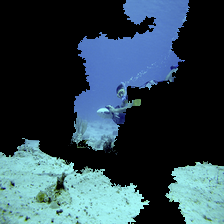

 scuba diver: 88.98%
  coral reef:  4.89%
    lionfish:  1.80%
       wreck:  0.84%
        jeep:  0.53%
     snorkel:  0.39%
 brain coral:  0.36%
sea cucumber:  0.32%
     tractor:  0.20%
   jellyfish:  0.19%



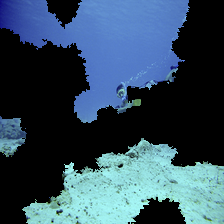

scuba diver: 79.48%
 coral reef: 10.82%
      wreck:  2.34%
   lionfish:  0.95%
      cliff:  0.78%
    volcano:  0.67%
     castle:  0.60%
    snorkel:  0.51%
  jellyfish:  0.44%
brain coral:  0.37%



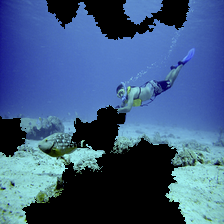

scuba diver: 41.01%
 coral reef: 26.83%
    snorkel: 26.02%
   lionfish:  3.66%
  sea snake:  0.26%
 loggerhead:  0.21%
      wreck:  0.17%
      cliff:  0.15%
 hammerhead:  0.15%
     puffer:  0.14%



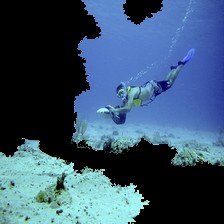

    snorkel: 31.77%
 coral reef: 30.70%
scuba diver: 28.49%
   lionfish:  6.22%
 loggerhead:  1.19%
     puffer:  0.86%
rock beauty:  0.18%
  sea snake:  0.12%
        ski:  0.06%
   sea slug:  0.05%



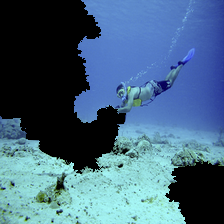

 scuba diver: 56.74%
     snorkel: 36.28%
  coral reef:  4.51%
    lionfish:  0.99%
   sea snake:  0.36%
       wreck:  0.20%
  loggerhead:  0.17%
      puffer:  0.14%
sea cucumber:  0.13%
       cliff:  0.07%



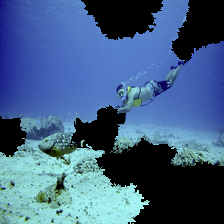

 scuba diver: 40.23%
  coral reef: 35.67%
     snorkel:  9.72%
    lionfish:  5.98%
   jellyfish:  1.53%
      puffer:  1.46%
   sea snake:  1.27%
 brain coral:  0.70%
anemone fish:  0.52%
       conch:  0.33%



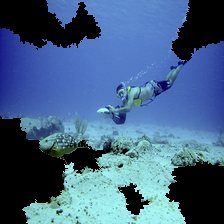

 scuba diver: 40.33%
  coral reef: 27.84%
     snorkel: 26.40%
    lionfish:  2.94%
         ski:  0.41%
  loggerhead:  0.39%
   sea snake:  0.35%
       wreck:  0.31%
 rock beauty:  0.17%
anemone fish:  0.07%



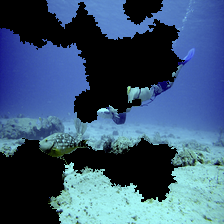

   jellyfish: 51.28%
  coral reef: 29.17%
sea cucumber:  4.95%
    lionfish:  2.69%
   parachute:  1.67%
    sea slug:  1.43%
      chiton:  1.24%
       conch:  1.10%
 brain coral:  1.09%
     balloon:  0.84%



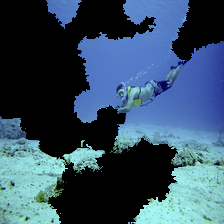

scuba diver: 32.11%
    snorkel: 28.62%
 coral reef: 23.44%
   lionfish:  4.90%
  jellyfish:  3.65%
      conch:  0.92%
green snake:  0.62%
  sea snake:  0.58%
     puffer:  0.55%
     bubble:  0.50%



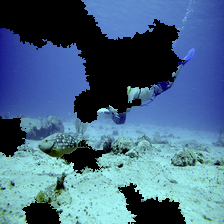

  coral reef: 26.26%
   jellyfish: 15.94%
sea cucumber: 10.41%
    lionfish:  8.98%
 scuba diver:  3.92%
       conch:  3.28%
   parachute:  2.91%
       wreck:  2.55%
     snorkel:  2.53%
 brain coral:  2.31%



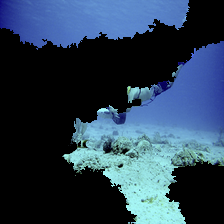

 parachute: 25.33%
       alp: 12.36%
 jellyfish:  9.41%
     cliff:  8.63%
promontory:  4.68%
    valley:  4.67%
   balloon:  4.18%
  lakeside:  3.93%
coral reef:  2.01%
   volcano:  1.85%



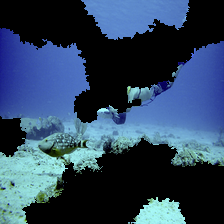

   jellyfish: 32.54%
  coral reef: 28.67%
   parachute:  6.76%
sea cucumber:  4.59%
    lionfish:  4.51%
     balloon:  2.07%
 brain coral:  2.06%
       conch:  1.94%
  promontory:  1.24%
         alp:  1.24%



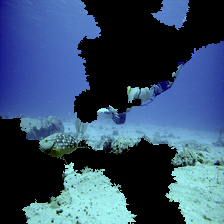

   jellyfish: 49.52%
  coral reef: 20.77%
   parachute:  3.57%
sea cucumber:  3.17%
    lionfish:  2.51%
     balloon:  2.51%
 scuba diver:  1.46%
 brain coral:  1.22%
      bubble:  1.21%
    sea slug:  0.99%



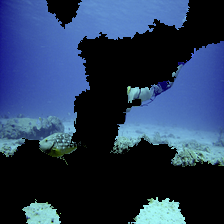

   jellyfish: 41.66%
  coral reef: 33.12%
    lionfish:  9.63%
 scuba diver:  1.84%
 brain coral:  1.47%
       conch:  1.22%
sea cucumber:  1.22%
     volcano:  1.00%
    sea slug:  0.93%
       wreck:  0.43%



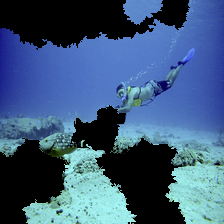

  coral reef: 42.93%
 scuba diver: 34.18%
     snorkel: 15.72%
    lionfish:  4.03%
   sea snake:  0.71%
      puffer:  0.34%
 brain coral:  0.29%
  loggerhead:  0.23%
   jellyfish:  0.16%
electric ray:  0.11%



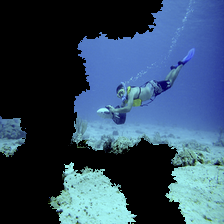

    snorkel: 38.12%
 coral reef: 33.93%
scuba diver: 24.94%
   lionfish:  1.15%
 loggerhead:  0.64%
  sea snake:  0.22%
        ski:  0.21%
     puffer:  0.15%
      cliff:  0.07%
      wreck:  0.07%



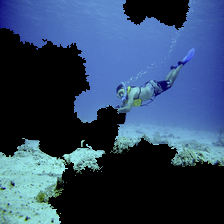

    snorkel: 36.27%
scuba diver: 31.84%
 coral reef: 28.08%
   lionfish:  1.89%
 loggerhead:  0.52%
  sea snake:  0.25%
     puffer:  0.21%
      cliff:  0.15%
brain coral:  0.08%
  jellyfish:  0.07%



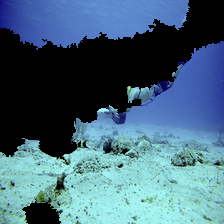

   parachute: 24.05%
   jellyfish: 12.00%
         alp:  8.82%
       cliff:  5.96%
  promontory:  5.88%
  coral reef:  3.37%
sea cucumber:  2.88%
      valley:  2.88%
     balloon:  2.55%
    lakeside:  2.24%



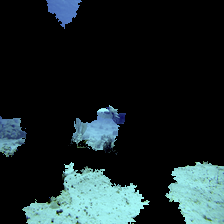

    coral reef: 28.09%
     jellyfish: 15.35%
       volcano: 14.47%
   brain coral:  5.74%
         cliff:  4.29%
         wreck:  3.23%
  sea cucumber:  2.96%
cliff dwelling:  2.70%
   scuba diver:  2.41%
     sea snake:  2.13%



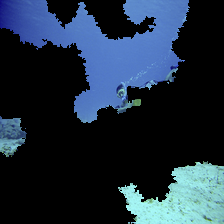

 scuba diver: 64.23%
      castle:  8.17%
  coral reef:  4.04%
       wreck:  2.93%
analog clock:  2.77%
    lionfish:  1.79%
       cliff:  1.25%
    lakeside:  0.85%
        tank:  0.73%
      bubble:  0.68%



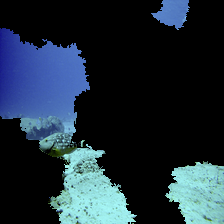

   jellyfish: 24.66%
  coral reef: 23.69%
     volcano: 16.20%
 brain coral:  5.67%
sea cucumber:  2.83%
coral fungus:  2.02%
    lionfish:  1.42%
       cliff:  1.39%
      geyser:  1.27%
 scuba diver:  1.04%



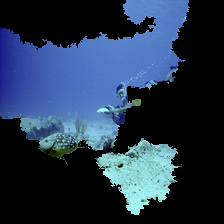

scuba diver: 64.21%
       jeep: 17.02%
 coral reef:  6.20%
      wreck:  2.12%
     castle:  1.89%
    tractor:  1.22%
   snowplow:  0.91%
   lionfish:  0.70%
       tank:  0.55%
   broccoli:  0.24%



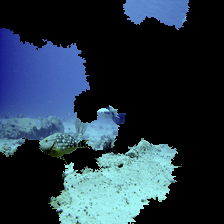

  coral reef: 57.14%
     volcano: 16.71%
 brain coral:  5.11%
   jellyfish:  4.71%
       cliff:  2.05%
      valley:  1.10%
   sea snake:  1.08%
  promontory:  0.96%
sea cucumber:  0.91%
    lionfish:  0.82%



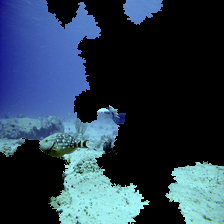

  coral reef: 72.77%
   jellyfish:  6.40%
 brain coral:  5.20%
sea cucumber:  4.05%
 scuba diver:  3.02%
     volcano:  1.45%
   sea snake:  1.41%
    lionfish:  0.81%
       wreck:  0.58%
    sea slug:  0.31%



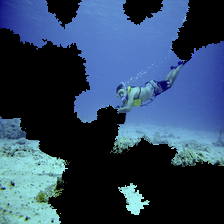

 coral reef: 45.29%
scuba diver: 28.40%
    snorkel: 11.33%
  jellyfish:  6.30%
   lionfish:  3.94%
      conch:  0.72%
brain coral:  0.54%
  sea snake:  0.52%
     puffer:  0.52%
 loggerhead:  0.20%



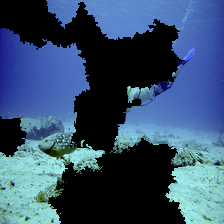

  coral reef: 18.52%
   jellyfish: 13.97%
 scuba diver:  7.26%
       wreck:  7.07%
sea cucumber:  6.73%
    lionfish:  6.33%
     volcano:  3.75%
  promontory:  3.15%
       conch:  2.86%
       cliff:  2.83%



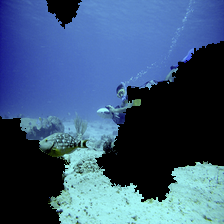

 scuba diver: 80.48%
  coral reef:  4.13%
       wreck:  3.40%
sea cucumber:  1.68%
    lionfish:  1.02%
        jeep:  0.72%
     snorkel:  0.65%
       cliff:  0.55%
    snowplow:  0.49%
   jellyfish:  0.45%



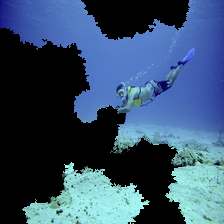

 coral reef: 43.70%
scuba diver: 27.04%
    snorkel: 23.08%
   lionfish:  3.33%
  sea snake:  0.68%
     puffer:  0.42%
  jellyfish:  0.35%
brain coral:  0.19%
 loggerhead:  0.19%
      cliff:  0.11%



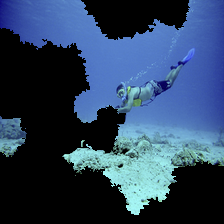

    snorkel: 46.95%
scuba diver: 31.44%
 coral reef: 18.85%
   lionfish:  1.54%
  sea snake:  0.20%
      cliff:  0.16%
brain coral:  0.07%
 loggerhead:  0.07%
     puffer:  0.06%
  jellyfish:  0.06%



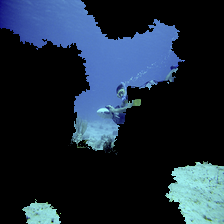

 scuba diver: 77.51%
  coral reef:  9.51%
     volcano:  3.51%
   jellyfish:  1.49%
      castle:  1.13%
       wreck:  1.03%
    lionfish:  0.85%
       cliff:  0.65%
analog clock:  0.32%
 brain coral:  0.28%



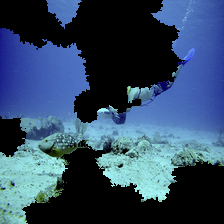

   jellyfish: 32.43%
  coral reef: 21.58%
sea cucumber:  6.53%
 scuba diver:  5.02%
    lionfish:  4.82%
     balloon:  4.42%
     snorkel:  3.27%
 brain coral:  2.81%
   parachute:  2.42%
       conch:  1.79%



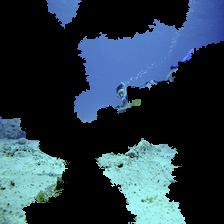

scuba diver: 64.67%
      wreck:  8.67%
 coral reef:  6.42%
      cliff:  6.18%
       jeep:  2.53%
     castle:  2.17%
    volcano:  1.72%
   lakeside:  0.64%
 promontory:  0.45%
 breakwater:  0.40%



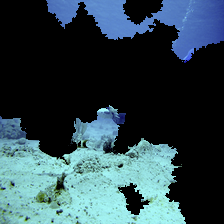

  coral reef: 41.80%
   jellyfish: 21.76%
       conch:  7.78%
 brain coral:  3.85%
     volcano:  3.14%
sea cucumber:  1.70%
       wreck:  1.45%
  promontory:  1.38%
       cliff:  1.14%
      valley:  0.89%



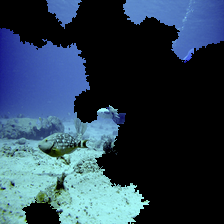

  coral reef: 73.22%
 scuba diver:  7.73%
 brain coral:  2.70%
   jellyfish:  2.58%
     volcano:  2.08%
sea cucumber:  2.03%
   sea snake:  1.49%
    lionfish:  1.09%
     snorkel:  1.08%
       conch:  0.89%



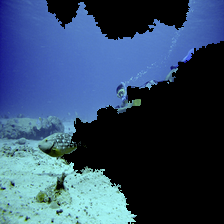

scuba diver: 64.62%
 coral reef: 24.56%
      wreck:  3.16%
   lionfish:  1.93%
  jellyfish:  0.96%
brain coral:  0.60%
    volcano:  0.55%
     castle:  0.51%
      cliff:  0.47%
    snorkel:  0.40%



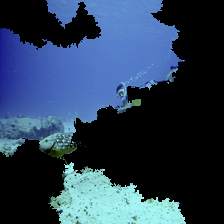

scuba diver: 63.07%
 coral reef: 27.38%
      wreck:  4.44%
   lionfish:  1.36%
  jellyfish:  0.61%
brain coral:  0.52%
    volcano:  0.38%
      cliff:  0.33%
     castle:  0.30%
       jeep:  0.23%



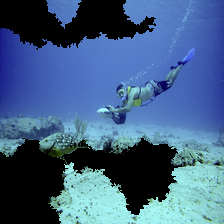

 coral reef: 47.25%
scuba diver: 32.04%
    snorkel: 17.53%
   lionfish:  1.80%
 loggerhead:  0.31%
        ski:  0.17%
  sea snake:  0.16%
rock beauty:  0.14%
      cliff:  0.07%
     puffer:  0.07%



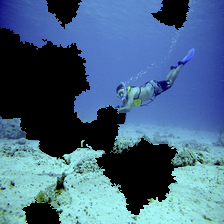

 scuba diver: 39.84%
  coral reef: 29.81%
     snorkel: 25.93%
    lionfish:  2.31%
  loggerhead:  0.28%
   sea snake:  0.25%
      puffer:  0.25%
   jellyfish:  0.18%
 brain coral:  0.14%
sea cucumber:  0.08%



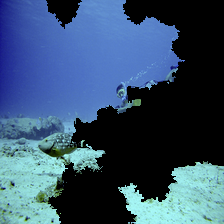

scuba diver: 79.63%
 coral reef:  9.14%
      wreck:  4.51%
   lionfish:  2.17%
     castle:  0.52%
  jellyfish:  0.51%
brain coral:  0.48%
    volcano:  0.39%
    snorkel:  0.38%
      cliff:  0.31%



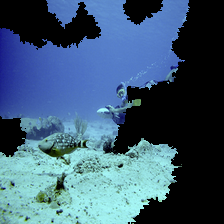

scuba diver: 73.39%
 coral reef: 17.85%
       jeep:  2.50%
      wreck:  1.48%
   lionfish:  1.04%
   snowplow:  0.67%
    tractor:  0.57%
brain coral:  0.38%
    snorkel:  0.18%
     castle:  0.18%



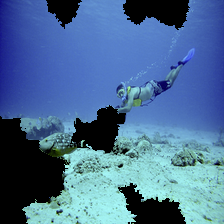

scuba diver: 51.34%
    snorkel: 29.57%
 coral reef: 15.32%
   lionfish:  2.72%
brain coral:  0.16%
  sea snake:  0.12%
 loggerhead:  0.09%
        ski:  0.07%
     puffer:  0.06%
      cliff:  0.05%



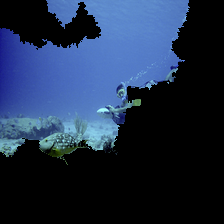

scuba diver: 72.30%
 coral reef: 10.31%
      wreck:  9.39%
     castle:  1.29%
   lakeside:  1.25%
       jeep:  0.77%
   lionfish:  0.56%
      cliff:  0.32%
  jellyfish:  0.29%
    snorkel:  0.20%



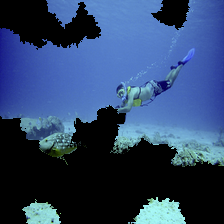

 coral reef: 63.61%
scuba diver: 28.70%
   lionfish:  4.66%
    snorkel:  1.12%
     puffer:  0.42%
  sea snake:  0.40%
 loggerhead:  0.35%
 hammerhead:  0.10%
      wreck:  0.06%
brain coral:  0.06%



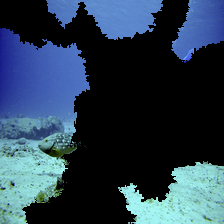

  coral reef: 36.74%
sea cucumber: 15.53%
     volcano:  8.66%
  promontory:  7.08%
   jellyfish:  5.29%
       cliff:  4.80%
 brain coral:  3.92%
       wreck:  2.79%
 scuba diver:  2.58%
     sandbar:  1.73%



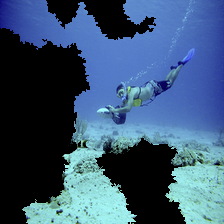

 coral reef: 36.50%
    snorkel: 35.21%
scuba diver: 24.03%
   lionfish:  2.95%
 loggerhead:  0.37%
        ski:  0.17%
  sea snake:  0.15%
     puffer:  0.12%
rock beauty:  0.09%
      wreck:  0.06%



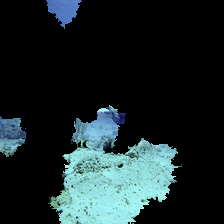

   jellyfish: 46.90%
     volcano: 13.36%
  coral reef:  4.09%
 brain coral:  3.57%
       conch:  2.43%
      geyser:  1.55%
coral fungus:  1.04%
    mushroom:  0.97%
sea cucumber:  0.86%
   golf ball:  0.83%



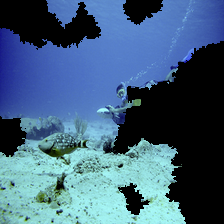

 scuba diver: 78.63%
  coral reef: 16.70%
       wreck:  1.55%
        jeep:  0.73%
    lionfish:  0.54%
 brain coral:  0.37%
     snorkel:  0.19%
     tractor:  0.15%
sea cucumber:  0.13%
   sea snake:  0.11%



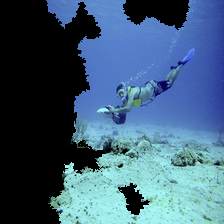

scuba diver: 47.33%
    snorkel: 37.70%
 coral reef: 11.09%
   lionfish:  2.89%
        ski:  0.38%
 loggerhead:  0.24%
rock beauty:  0.07%
  sea snake:  0.05%
  parachute:  0.03%
      wreck:  0.03%



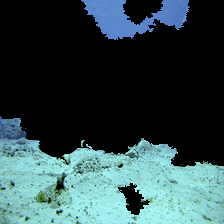

  coral reef: 46.75%
   jellyfish: 23.76%
 brain coral:  2.73%
 scuba diver:  2.67%
     volcano:  2.52%
       conch:  2.22%
       wreck:  1.99%
       cliff:  1.92%
  promontory:  0.94%
sea cucumber:  0.93%



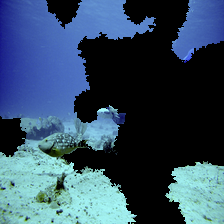

  coral reef: 62.46%
   jellyfish:  7.96%
 scuba diver:  6.83%
 brain coral:  3.62%
sea cucumber:  3.56%
     snorkel:  2.13%
  promontory:  1.37%
       conch:  1.34%
       wreck:  0.98%
     volcano:  0.93%



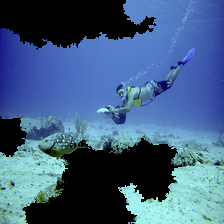

 coral reef: 32.48%
scuba diver: 32.00%
    snorkel: 31.54%
   lionfish:  1.96%
        ski:  0.46%
 loggerhead:  0.44%
  sea snake:  0.18%
      wreck:  0.14%
rock beauty:  0.11%
      cliff:  0.09%



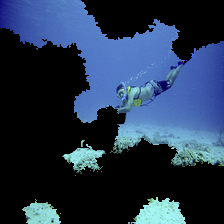

 coral reef: 61.53%
scuba diver: 17.67%
   lionfish:  6.83%
    snorkel:  5.31%
  jellyfish:  3.93%
  sea snake:  1.21%
     puffer:  0.80%
brain coral:  0.40%
green snake:  0.34%
      conch:  0.20%



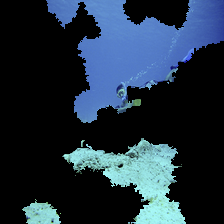

scuba diver: 76.19%
 coral reef: 16.24%
  jellyfish:  1.55%
   lionfish:  1.35%
      wreck:  1.23%
    volcano:  0.51%
brain coral:  0.44%
      cliff:  0.26%
     castle:  0.20%
    snorkel:  0.11%



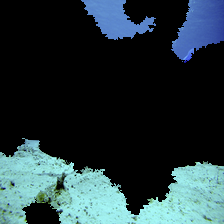

         coral reef: 27.52%
       sea cucumber: 21.17%
         promontory:  6.69%
            volcano:  6.66%
              cliff:  4.37%
          jellyfish:  4.13%
        brain coral:  3.00%
           sea slug:  1.55%
Irish water spaniel:  1.45%
         toy poodle:  1.13%



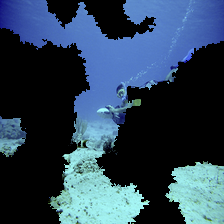

 scuba diver: 80.70%
  coral reef: 10.29%
       wreck:  1.52%
    lionfish:  0.95%
sea cucumber:  0.83%
     snorkel:  0.70%
        jeep:  0.66%
 brain coral:  0.61%
   jellyfish:  0.41%
       cliff:  0.41%



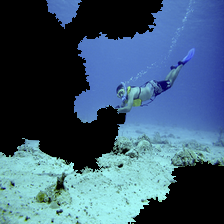

    snorkel: 55.03%
scuba diver: 28.82%
 coral reef: 13.39%
   lionfish:  1.31%
  sea snake:  0.56%
     puffer:  0.15%
 loggerhead:  0.12%
brain coral:  0.09%
green snake:  0.05%
      cliff:  0.04%



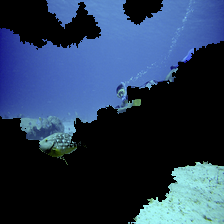

scuba diver: 46.58%
 coral reef: 23.60%
      wreck: 12.82%
     castle:  3.29%
   lionfish:  2.42%
  jellyfish:  1.97%
      cliff:  1.55%
   lakeside:  0.91%
    volcano:  0.87%
   broccoli:  0.48%



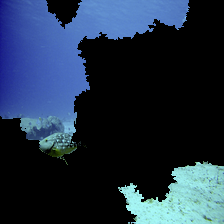

 coral reef: 20.54%
  jellyfish: 19.55%
    volcano: 12.40%
      cliff:  7.73%
 promontory:  5.89%
scuba diver:  5.64%
brain coral:  1.94%
     castle:  1.74%
   lakeside:  1.68%
     geyser:  1.52%



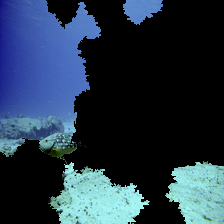

  coral reef: 73.15%
     volcano:  7.56%
   jellyfish:  5.51%
 brain coral:  4.47%
 scuba diver:  1.73%
sea cucumber:  1.54%
    lionfish:  0.74%
       cliff:  0.50%
   sea snake:  0.45%
  promontory:  0.40%



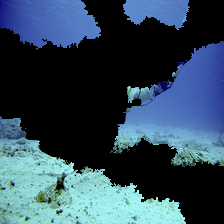

  coral reef: 26.78%
sea cucumber: 11.57%
   jellyfish:  8.84%
       cliff:  7.55%
  promontory:  6.88%
    lakeside:  6.41%
 brain coral:  4.30%
     sandbar:  3.29%
       conch:  2.80%
   parachute:  2.61%



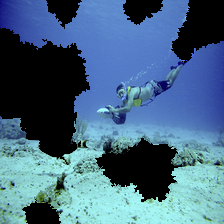

  coral reef: 40.33%
 scuba diver: 30.03%
     snorkel: 19.70%
    lionfish:  5.93%
   jellyfish:  1.15%
sea cucumber:  0.46%
      puffer:  0.30%
       conch:  0.25%
 rock beauty:  0.24%
  loggerhead:  0.23%



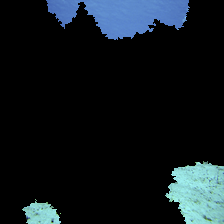

          volcano: 22.49%
            cliff: 12.84%
        jellyfish:  9.00%
              alp:  6.78%
         lakeside:  5.53%
       promontory:  4.04%
       coral reef:  3.48%
           valley:  3.09%
suspension bridge:  2.66%
           geyser:  1.72%



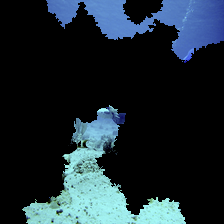

   jellyfish: 49.58%
  coral reef: 23.14%
     volcano:  5.72%
 brain coral:  2.65%
sea cucumber:  1.98%
       conch:  1.38%
       cliff:  1.37%
   sea snake:  1.31%
    lionfish:  0.83%
       wreck:  0.83%



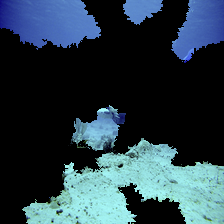

    coral reef: 30.86%
         cliff: 15.72%
       volcano: 15.62%
    promontory:  7.60%
        valley:  4.98%
     jellyfish:  3.36%
cliff dwelling:  3.14%
           alp:  2.70%
   brain coral:  1.50%
      lakeside:  1.25%



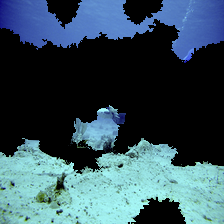

  coral reef: 44.65%
   jellyfish: 30.73%
     volcano:  5.11%
 brain coral:  4.86%
  promontory:  2.07%
       conch:  1.85%
       cliff:  1.32%
sea cucumber:  0.89%
      valley:  0.74%
    lionfish:  0.50%



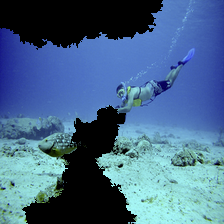

    snorkel: 51.58%
scuba diver: 28.88%
 coral reef: 15.84%
   lionfish:  1.62%
  sea snake:  0.50%
      cliff:  0.29%
      wreck:  0.14%
 loggerhead:  0.14%
brain coral:  0.14%
     puffer:  0.08%



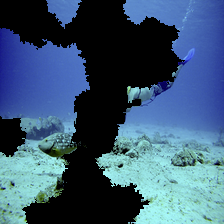

  coral reef: 21.28%
    lionfish: 13.93%
 scuba diver:  9.71%
   jellyfish:  9.53%
sea cucumber:  5.37%
 brain coral:  4.24%
     snorkel:  4.07%
       conch:  2.59%
       cliff:  2.57%
       wreck:  2.40%



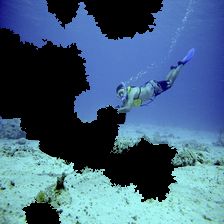

    snorkel: 35.46%
 coral reef: 30.96%
scuba diver: 28.32%
   lionfish:  2.80%
  sea snake:  0.69%
  jellyfish:  0.20%
brain coral:  0.19%
     puffer:  0.16%
      wreck:  0.13%
 loggerhead:  0.12%



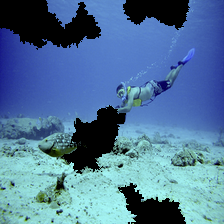

 scuba diver: 47.68%
     snorkel: 30.16%
  coral reef: 18.18%
    lionfish:  3.23%
 brain coral:  0.14%
  loggerhead:  0.10%
   sea snake:  0.09%
      puffer:  0.07%
       conch:  0.04%
sea cucumber:  0.02%



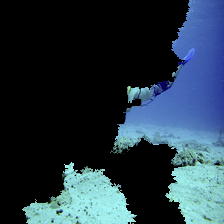

sea cucumber: 28.03%
   jellyfish: 16.83%
  coral reef: 16.18%
       cliff:  4.72%
    sea slug:  2.32%
    lionfish:  2.27%
       conch:  1.94%
 scuba diver:  1.71%
       wreck:  1.47%
  sea urchin:  1.36%



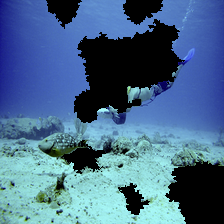

  coral reef: 37.24%
   jellyfish: 36.29%
    lionfish:  5.56%
       conch:  3.82%
sea cucumber:  3.56%
     snorkel:  2.24%
 scuba diver:  2.00%
 brain coral:  1.47%
      chiton:  1.32%
    sea slug:  0.81%



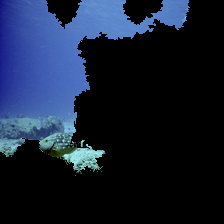

 coral reef: 44.15%
  jellyfish: 19.06%
    volcano:  9.15%
scuba diver:  5.37%
   lakeside:  2.51%
      cliff:  2.45%
 promontory:  1.98%
     geyser:  1.92%
      wreck:  1.91%
brain coral:  1.15%



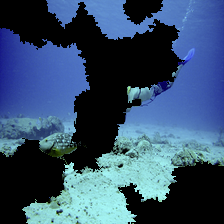

  coral reef: 58.93%
   jellyfish: 11.41%
    lionfish: 10.22%
 scuba diver:  4.14%
 brain coral:  2.72%
sea cucumber:  2.30%
       conch:  2.05%
    sea slug:  0.99%
       wreck:  0.60%
    flatworm:  0.55%



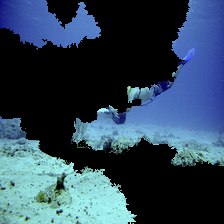

   jellyfish: 44.58%
  coral reef: 18.93%
sea cucumber:  9.35%
   parachute:  5.94%
     balloon:  4.25%
       conch:  2.91%
    lionfish:  1.71%
    sea slug:  1.29%
      chiton:  1.01%
  sea urchin:  0.99%



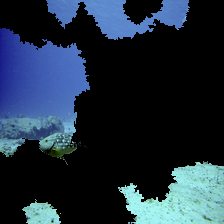

  coral reef: 43.80%
   jellyfish: 29.17%
     volcano:  9.33%
 brain coral:  3.80%
 scuba diver:  1.62%
sea cucumber:  0.92%
    lionfish:  0.87%
      geyser:  0.59%
    lakeside:  0.46%
       conch:  0.40%



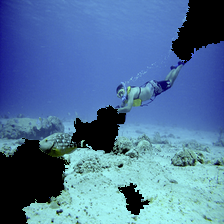

scuba diver: 77.19%
    snorkel: 10.19%
 coral reef:  9.62%
   lionfish:  1.09%
  sea snake:  0.32%
      wreck:  0.16%
brain coral:  0.16%
 loggerhead:  0.16%
   stingray:  0.12%
     puffer:  0.11%



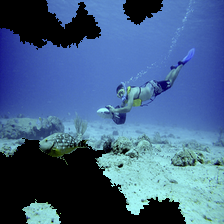

 coral reef: 46.89%
scuba diver: 24.65%
    snorkel: 22.66%
   lionfish:  3.68%
 loggerhead:  0.71%
rock beauty:  0.29%
  sea snake:  0.28%
        ski:  0.17%
     puffer:  0.07%
      wreck:  0.07%



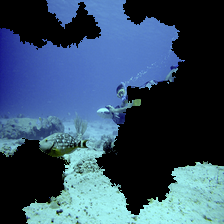

 scuba diver: 76.52%
  coral reef: 15.30%
       wreck:  2.29%
    lionfish:  1.32%
sea cucumber:  1.04%
 brain coral:  0.45%
   jellyfish:  0.38%
      castle:  0.33%
        jeep:  0.25%
     volcano:  0.17%



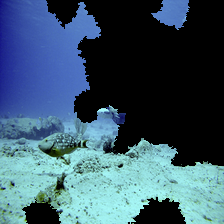

  coral reef: 73.44%
 brain coral:  3.76%
   jellyfish:  3.60%
 scuba diver:  3.39%
sea cucumber:  2.44%
       conch:  2.25%
   sea snake:  1.96%
    lionfish:  1.86%
     snorkel:  0.95%
     volcano:  0.75%



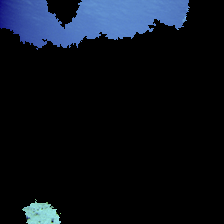

 jellyfish: 25.72%
   volcano: 12.41%
   balloon:  7.84%
  lakeside:  3.64%
       alp:  3.45%
 parachute:  3.03%
     cliff:  2.26%
promontory:  1.90%
    bubble:  1.47%
    geyser:  1.32%



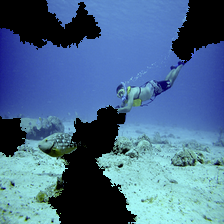

scuba diver: 61.04%
    snorkel: 18.57%
 coral reef: 13.22%
   lionfish:  3.21%
  sea snake:  0.97%
      wreck:  0.59%
      conch:  0.29%
brain coral:  0.21%
water snake:  0.15%
 hammerhead:  0.12%



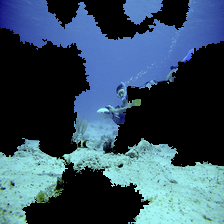

 scuba diver: 93.54%
  coral reef:  2.86%
        jeep:  1.00%
sea cucumber:  0.44%
 brain coral:  0.39%
    lionfish:  0.33%
       wreck:  0.32%
     snorkel:  0.28%
     volcano:  0.09%
        tank:  0.08%



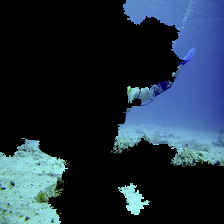

   jellyfish: 24.50%
  coral reef: 15.52%
sea cucumber:  8.36%
 scuba diver:  7.74%
    lionfish:  5.71%
       cliff:  5.53%
       wreck:  3.13%
    sea slug:  1.92%
 brain coral:  1.85%
    lakeside:  1.54%



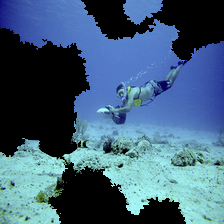

     snorkel: 70.15%
 scuba diver: 19.25%
  coral reef:  6.87%
    lionfish:  2.17%
         ski:  0.44%
 brain coral:  0.11%
   sea snake:  0.10%
sea cucumber:  0.08%
  loggerhead:  0.07%
   jellyfish:  0.06%



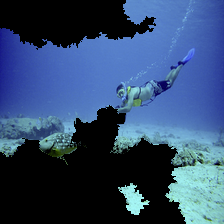

  coral reef: 45.68%
 scuba diver: 38.03%
     snorkel:  9.65%
    lionfish:  3.52%
   sea snake:  0.59%
      puffer:  0.49%
  loggerhead:  0.32%
  hammerhead:  0.18%
electric ray:  0.12%
 brain coral:  0.12%



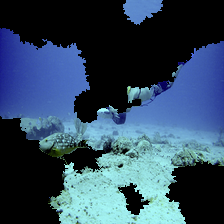

  coral reef: 41.47%
   parachute: 10.87%
   jellyfish:  9.84%
     balloon:  3.88%
         alp:  2.91%
    lionfish:  2.72%
 brain coral:  2.25%
sea cucumber:  2.14%
       cliff:  2.05%
   sea snake:  1.54%



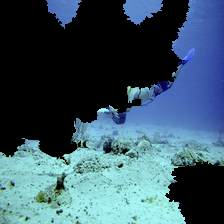

   jellyfish: 27.99%
sea cucumber: 17.01%
   parachute: 10.22%
  coral reef:  7.14%
       conch:  4.41%
     balloon:  2.86%
    sea slug:  2.40%
    lionfish:  2.10%
 brain coral:  1.36%
       cliff:  1.24%



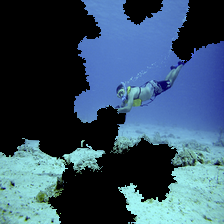

scuba diver: 34.73%
 coral reef: 26.79%
    snorkel: 13.86%
   lionfish: 11.29%
  jellyfish:  7.08%
     puffer:  1.43%
green snake:  0.69%
  sea snake:  0.55%
brain coral:  0.43%
      conch:  0.38%



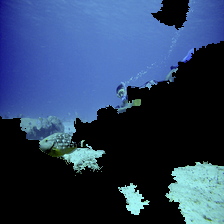

scuba diver: 86.27%
      wreck:  8.26%
 coral reef:  4.03%
   lionfish:  0.35%
    snorkel:  0.11%
      cliff:  0.11%
brain coral:  0.10%
     castle:  0.09%
  jellyfish:  0.06%
   lakeside:  0.05%



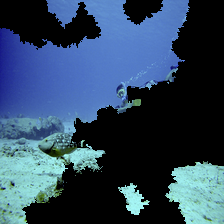

scuba diver: 69.05%
 coral reef: 20.10%
      wreck:  5.60%
   lionfish:  2.10%
  jellyfish:  0.42%
     castle:  0.39%
brain coral:  0.34%
    volcano:  0.28%
    snorkel:  0.23%
       jeep:  0.18%



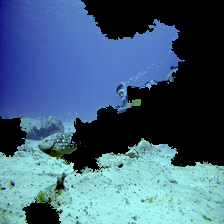

scuba diver: 69.78%
 coral reef: 18.98%
      wreck:  4.95%
   lionfish:  1.48%
brain coral:  0.60%
  sea snake:  0.41%
       jeep:  0.37%
     castle:  0.32%
    snorkel:  0.31%
  jellyfish:  0.27%



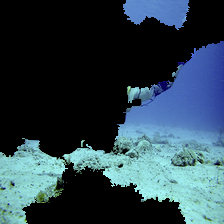

     cliff: 34.02%
promontory:  6.37%
coral reef:  5.12%
   sandbar:  4.14%
    valley:  3.87%
  lakeside:  3.84%
 sea snake:  3.00%
       alp:  2.72%
     wreck:  2.18%
 parachute:  1.96%



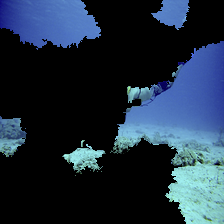

     cliff: 30.37%
coral reef:  9.48%
promontory:  7.46%
  lakeside:  6.00%
   volcano:  5.48%
 jellyfish:  3.92%
     stupa:  2.50%
  seashore:  2.37%
    castle:  2.17%
 parachute:  1.66%



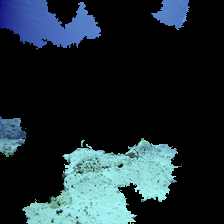

  coral reef: 58.25%
   jellyfish: 16.08%
     volcano: 10.20%
 brain coral:  3.08%
coral fungus:  1.33%
       cliff:  0.79%
    lakeside:  0.63%
  promontory:  0.54%
     obelisk:  0.53%
 scuba diver:  0.49%



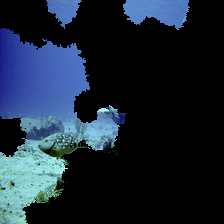

 coral reef: 38.04%
    volcano:  7.38%
scuba diver:  6.06%
      wreck:  4.56%
      cliff:  4.13%
     castle:  3.79%
  jellyfish:  3.71%
        alp:  3.10%
brain coral:  2.75%
   lakeside:  2.10%



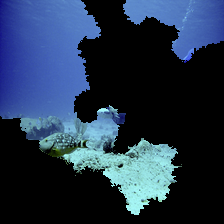

 coral reef: 23.79%
    volcano: 13.62%
      cliff: 12.74%
 promontory: 10.86%
  jellyfish:  7.92%
      wreck:  4.19%
scuba diver:  3.63%
     valley:  2.63%
   lakeside:  2.61%
brain coral:  1.95%



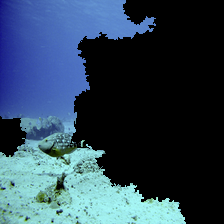

 coral reef: 52.72%
scuba diver:  7.69%
  jellyfish:  4.03%
 promontory:  3.73%
      wreck:  3.72%
    volcano:  3.66%
brain coral:  2.46%
    snorkel:  1.93%
   lionfish:  1.74%
  sea snake:  1.54%



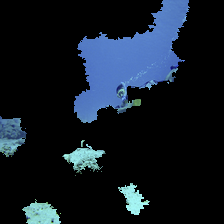

  scuba diver: 60.80%
       castle:  5.11%
   coral reef:  4.51%
        wreck:  3.17%
 analog clock:  2.32%
traffic light:  1.73%
       bubble:  1.32%
    birdhouse:  1.21%
     lakeside:  1.19%
    jellyfish:  1.15%



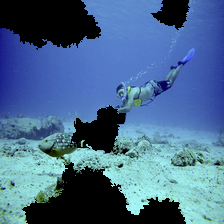

 scuba diver: 57.41%
     snorkel: 32.45%
  coral reef:  8.02%
    lionfish:  1.44%
  loggerhead:  0.09%
   sea snake:  0.08%
 brain coral:  0.08%
      puffer:  0.07%
       wreck:  0.05%
sea cucumber:  0.04%



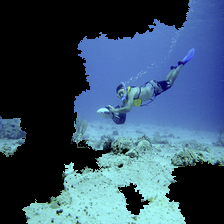

    snorkel: 55.59%
scuba diver: 29.34%
 coral reef: 12.61%
   lionfish:  1.15%
 loggerhead:  0.46%
        ski:  0.34%
  sea snake:  0.11%
rock beauty:  0.05%
      wreck:  0.05%
     puffer:  0.03%



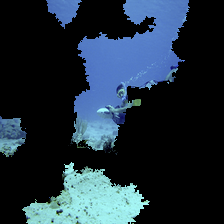

scuba diver: 83.32%
 coral reef:  9.23%
   lionfish:  1.28%
      wreck:  1.16%
       jeep:  0.99%
     castle:  0.48%
  jellyfish:  0.42%
    snorkel:  0.26%
    volcano:  0.25%
    tractor:  0.25%



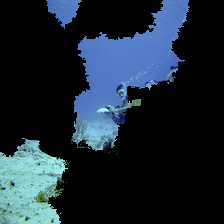

scuba diver: 80.77%
 coral reef:  4.48%
      wreck:  1.87%
     castle:  1.76%
       jeep:  1.22%
    volcano:  1.06%
   lionfish:  0.93%
      cliff:  0.89%
  jellyfish:  0.59%
    snorkel:  0.46%



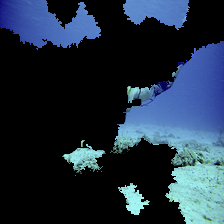

     cliff: 14.67%
coral reef: 14.21%
  lakeside:  9.32%
 jellyfish:  8.77%
 parachute:  8.06%
   volcano:  3.30%
promontory:  3.09%
     stupa:  2.23%
     wreck:  2.10%
    castle:  1.93%



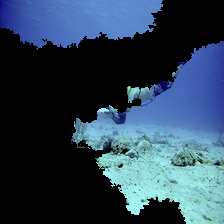

 parachute: 32.26%
       alp: 14.55%
     cliff:  7.48%
    valley:  5.16%
  lakeside:  5.08%
promontory:  4.97%
   balloon:  4.36%
 jellyfish:  4.02%
   sandbar:  2.39%
coral reef:  1.46%



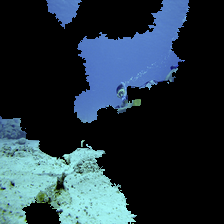

 scuba diver: 50.15%
  coral reef:  9.65%
      castle:  4.65%
       wreck:  2.85%
     volcano:  2.58%
       cliff:  2.16%
analog clock:  1.85%
        jeep:  1.77%
    lionfish:  1.60%
    lakeside:  1.57%



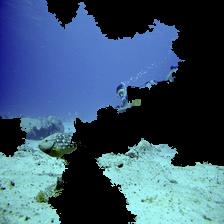

scuba diver: 61.96%
 coral reef: 19.40%
      wreck:  8.88%
   lionfish:  1.44%
       jeep:  1.36%
     castle:  1.11%
brain coral:  0.65%
      cliff:  0.47%
  jellyfish:  0.45%
    volcano:  0.42%



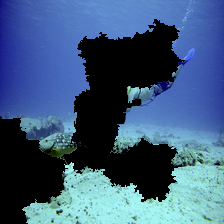

  coral reef: 21.22%
   jellyfish: 15.18%
    lionfish: 14.33%
sea cucumber: 11.37%
 scuba diver:  9.71%
       wreck:  4.97%
    sea slug:  2.08%
       conch:  1.73%
       cliff:  1.59%
 brain coral:  1.54%



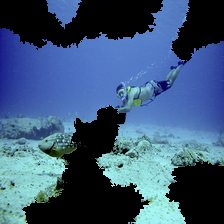

scuba diver: 40.17%
 coral reef: 30.77%
    snorkel: 20.92%
   lionfish:  4.18%
brain coral:  0.87%
  sea snake:  0.63%
      conch:  0.36%
  jellyfish:  0.27%
      cliff:  0.17%
     puffer:  0.16%



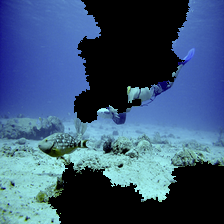

sea cucumber: 27.98%
   jellyfish: 24.32%
  coral reef: 19.91%
    lionfish:  4.16%
 scuba diver:  3.64%
     snorkel:  3.03%
       conch:  2.12%
 brain coral:  1.48%
      chiton:  1.39%
    sea slug:  1.37%



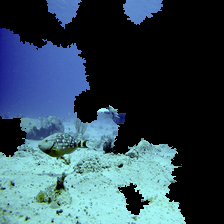

  coral reef: 69.37%
 scuba diver:  4.40%
 brain coral:  4.09%
   jellyfish:  2.42%
   sea snake:  2.42%
       conch:  1.96%
sea cucumber:  1.58%
     volcano:  1.55%
    lionfish:  1.53%
       wreck:  0.80%



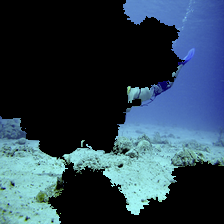

       cliff: 26.31%
  coral reef: 11.12%
 scuba diver:  6.69%
   jellyfish:  5.68%
       wreck:  5.58%
sea cucumber:  4.37%
       conch:  4.15%
  promontory:  3.81%
    lionfish:  3.36%
     snorkel:  2.17%



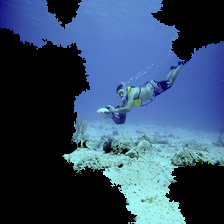

    snorkel: 39.02%
scuba diver: 33.67%
 coral reef: 22.87%
   lionfish:  2.56%
        ski:  0.43%
 loggerhead:  0.19%
  sea snake:  0.15%
      wreck:  0.13%
rock beauty:  0.11%
brain coral:  0.09%



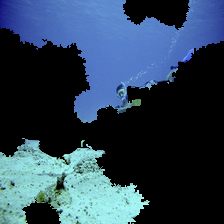

 scuba diver: 48.76%
  coral reef: 31.00%
   jellyfish:  3.39%
     volcano:  2.65%
    lionfish:  2.11%
 brain coral:  2.03%
       wreck:  0.61%
sea cucumber:  0.58%
       cliff:  0.53%
    lakeside:  0.53%



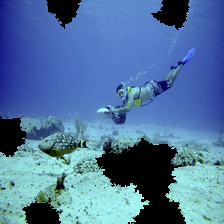

       coral reef: 46.45%
      scuba diver: 31.80%
          snorkel: 17.35%
         lionfish:  2.19%
       loggerhead:  0.86%
              ski:  0.28%
        sea snake:  0.19%
      rock beauty:  0.15%
great white shark:  0.09%
           puffer:  0.07%



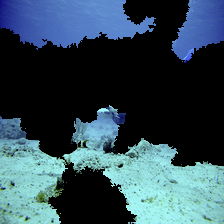

 coral reef: 20.53%
     valley: 14.56%
 promontory: 14.41%
    volcano: 10.91%
      cliff:  8.99%
  jellyfish:  4.14%
   lakeside:  3.43%
      conch:  3.20%
brain coral:  2.24%
    sandbar:  2.03%



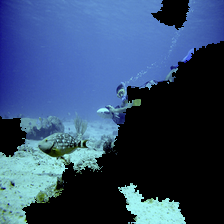

 scuba diver: 74.79%
       wreck: 17.02%
  coral reef:  6.07%
        jeep:  0.31%
     snorkel:  0.25%
    lionfish:  0.23%
 brain coral:  0.21%
   sea snake:  0.08%
sea cucumber:  0.08%
       cliff:  0.07%



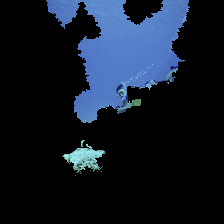

  scuba diver: 54.95%
       castle:  7.15%
 analog clock:  2.90%
   coral reef:  2.88%
traffic light:  2.39%
    birdhouse:  1.89%
        wreck:  1.72%
    jellyfish:  1.59%
       church:  1.43%
     fountain:  1.38%



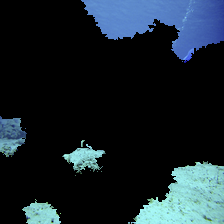

         cliff: 28.50%
       volcano: 20.97%
    coral reef: 18.77%
    promontory:  4.80%
         wreck:  3.95%
     jellyfish:  2.95%
        castle:  1.81%
      lakeside:  1.76%
   scuba diver:  1.72%
cliff dwelling:  1.36%



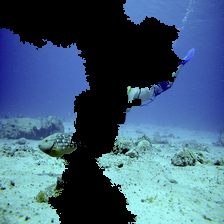

  coral reef: 15.13%
    lionfish: 14.19%
sea cucumber: 13.53%
   jellyfish: 10.53%
     snorkel:  5.71%
 scuba diver:  5.30%
       cliff:  5.02%
 brain coral:  3.96%
       conch:  2.89%
  promontory:  2.37%



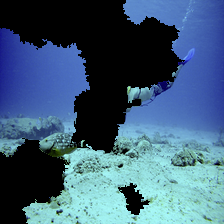

  coral reef: 33.60%
 scuba diver: 18.91%
    lionfish: 13.27%
   jellyfish:  9.27%
 brain coral:  5.50%
sea cucumber:  4.50%
     snorkel:  2.78%
    sea slug:  1.92%
       conch:  1.59%
    flatworm:  1.11%



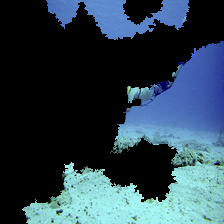

   jellyfish: 21.62%
  coral reef: 13.68%
sea cucumber:  9.10%
       cliff:  6.22%
    lionfish:  4.69%
   parachute:  3.65%
       wreck:  3.08%
 brain coral:  2.92%
       conch:  2.04%
   sea snake:  2.02%



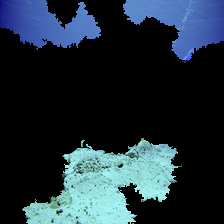

  coral reef: 56.90%
     volcano: 25.08%
   jellyfish:  5.78%
 brain coral:  1.49%
       cliff:  1.30%
coral fungus:  0.75%
    broccoli:  0.70%
  promontory:  0.59%
 scuba diver:  0.57%
      geyser:  0.56%



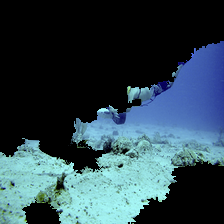

  coral reef: 16.70%
   parachute: 12.99%
   jellyfish:  9.30%
       conch:  6.03%
     sandbar:  5.16%
   sea snake:  4.36%
     balloon:  4.00%
sea cucumber:  3.95%
       cliff:  3.44%
         alp:  2.88%



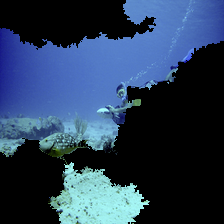

scuba diver: 53.60%
 coral reef: 40.83%
      wreck:  1.71%
   lionfish:  0.86%
brain coral:  0.50%
  jellyfish:  0.36%
       jeep:  0.28%
    snorkel:  0.21%
  sea snake:  0.17%
    volcano:  0.16%



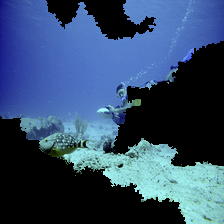

scuba diver: 84.88%
       jeep:  4.82%
 coral reef:  3.45%
      wreck:  3.40%
     castle:  0.50%
      cliff:  0.35%
    tractor:  0.22%
   snowplow:  0.21%
   lionfish:  0.21%
       tank:  0.16%



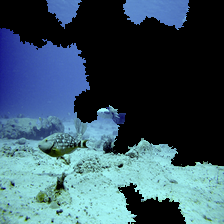

  coral reef: 62.95%
 brain coral:  5.37%
     volcano:  5.02%
 scuba diver:  2.86%
   jellyfish:  2.82%
       conch:  2.50%
   sea snake:  2.37%
sea cucumber:  2.34%
    lionfish:  1.34%
       cliff:  1.00%



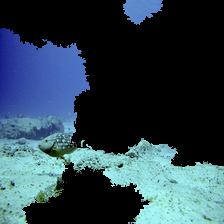

  coral reef: 34.17%
     volcano: 27.25%
       cliff:  5.67%
 brain coral:  5.48%
   jellyfish:  5.04%
sea cucumber:  3.88%
      geyser:  2.07%
  promontory:  1.75%
       conch:  1.53%
 scuba diver:  1.28%



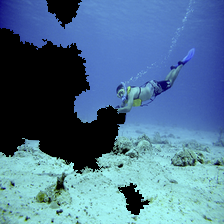

     snorkel: 43.86%
 scuba diver: 39.63%
  coral reef: 13.42%
    lionfish:  1.14%
  loggerhead:  0.70%
   sea snake:  0.27%
      puffer:  0.21%
 brain coral:  0.07%
sea cucumber:  0.07%
  hammerhead:  0.06%



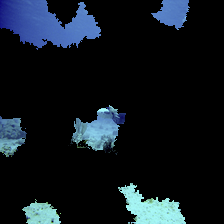

  jellyfish: 52.52%
    volcano: 14.16%
 coral reef: 10.80%
     geyser:  2.47%
brain coral:  1.52%
      cliff:  1.27%
     bubble:  1.20%
      conch:  1.13%
      wreck:  0.79%
scuba diver:  0.72%



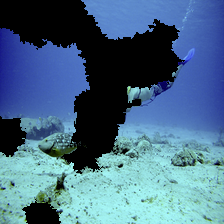

  coral reef: 28.38%
    lionfish: 15.57%
 scuba diver: 12.26%
sea cucumber:  8.87%
   jellyfish:  6.03%
       wreck:  4.08%
       conch:  3.79%
 brain coral:  3.51%
     snorkel:  1.77%
  promontory:  1.71%



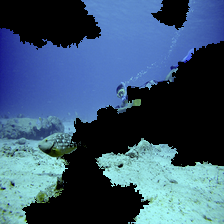

 scuba diver: 76.56%
  coral reef: 13.42%
       wreck:  4.79%
sea cucumber:  0.92%
 brain coral:  0.83%
    lionfish:  0.77%
   jellyfish:  0.64%
     snorkel:  0.52%
       cliff:  0.25%
     volcano:  0.20%



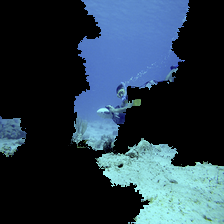

scuba diver: 97.12%
      wreck:  1.15%
       jeep:  0.78%
 coral reef:  0.33%
   lionfish:  0.10%
    snorkel:  0.09%
     castle:  0.05%
      cliff:  0.05%
  amphibian:  0.03%
    volcano:  0.02%



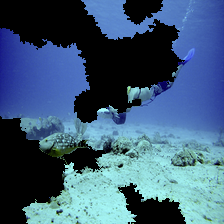

   jellyfish: 39.52%
  coral reef: 29.63%
   parachute:  5.90%
    lionfish:  4.26%
     balloon:  2.58%
sea cucumber:  2.34%
 brain coral:  1.78%
       conch:  1.38%
      chiton:  1.21%
     snorkel:  1.07%



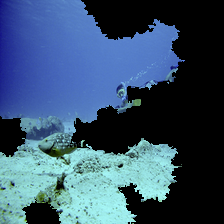

scuba diver: 67.81%
 coral reef: 24.69%
      wreck:  1.66%
   lionfish:  1.21%
  jellyfish:  0.64%
brain coral:  0.43%
     castle:  0.43%
  sea snake:  0.28%
    snorkel:  0.26%
    volcano:  0.22%



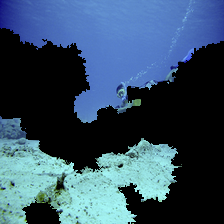

scuba diver: 73.91%
 coral reef: 13.17%
      wreck:  6.92%
      cliff:  1.28%
 promontory:  0.60%
    volcano:  0.46%
   lakeside:  0.33%
     castle:  0.29%
    snorkel:  0.27%
brain coral:  0.24%



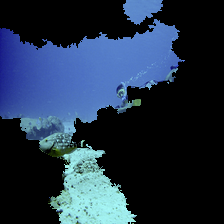

scuba diver: 28.46%
 coral reef: 16.39%
     castle:  6.61%
       jeep:  5.88%
      wreck:  5.12%
   broccoli:  4.71%
    volcano:  2.80%
  jellyfish:  2.77%
   lionfish:  2.32%
    tractor:  2.17%



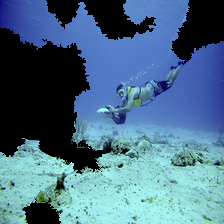

    snorkel: 51.40%
scuba diver: 28.86%
 coral reef: 11.62%
   lionfish:  6.28%
        ski:  0.40%
     puffer:  0.13%
rock beauty:  0.12%
  sea snake:  0.11%
brain coral:  0.11%
 loggerhead:  0.10%



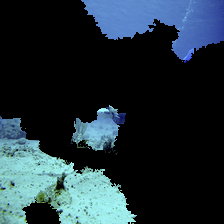

         cliff: 23.60%
    promontory: 18.76%
    coral reef: 16.91%
       volcano: 10.06%
         wreck:  8.75%
  sea cucumber:  2.36%
     jellyfish:  2.20%
   scuba diver:  1.86%
cliff dwelling:  1.57%
        valley:  1.44%



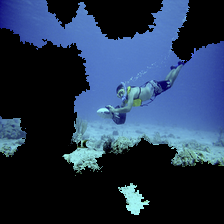

    snorkel: 36.24%
 coral reef: 35.94%
scuba diver: 20.52%
   lionfish:  5.09%
  jellyfish:  0.46%
 loggerhead:  0.37%
     puffer:  0.24%
  sea snake:  0.16%
rock beauty:  0.14%
      wreck:  0.10%



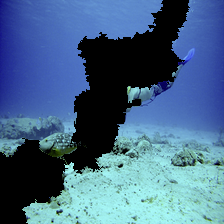

  coral reef: 35.43%
sea cucumber: 19.64%
    lionfish: 15.89%
   jellyfish:  6.77%
 scuba diver:  4.85%
    sea slug:  3.64%
 brain coral:  2.14%
       conch:  1.68%
       wreck:  1.45%
    flatworm:  0.69%



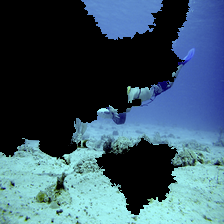

   jellyfish: 42.38%
sea cucumber: 25.05%
  coral reef:  4.61%
   parachute:  2.42%
     balloon:  2.28%
    sea slug:  1.99%
       conch:  1.81%
       cliff:  1.69%
    lionfish:  1.24%
      chiton:  1.19%



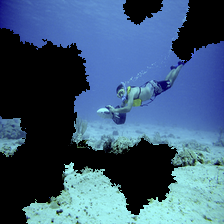

 coral reef: 48.18%
    snorkel: 25.47%
scuba diver: 19.57%
   lionfish:  4.57%
  jellyfish:  0.34%
     puffer:  0.22%
 loggerhead:  0.22%
  sea snake:  0.16%
   sea slug:  0.11%
      conch:  0.11%



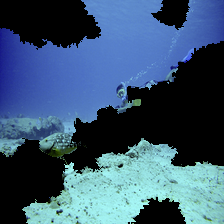

 scuba diver: 68.24%
  coral reef: 25.25%
 brain coral:  1.24%
sea cucumber:  1.13%
       wreck:  1.06%
    lionfish:  0.94%
   jellyfish:  0.65%
     snorkel:  0.23%
     volcano:  0.20%
   sea snake:  0.11%



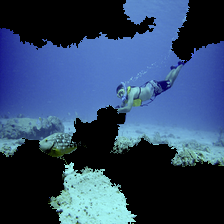

  coral reef: 52.18%
 scuba diver: 30.37%
    lionfish:  5.89%
     snorkel:  5.13%
   jellyfish:  1.23%
 brain coral:  0.90%
      puffer:  0.87%
   sea snake:  0.77%
anemone fish:  0.47%
 green snake:  0.23%



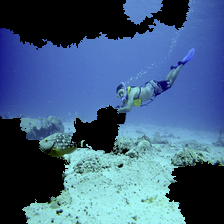

scuba diver: 46.94%
    snorkel: 33.28%
 coral reef: 14.43%
   lionfish:  3.58%
  sea snake:  0.41%
brain coral:  0.22%
     puffer:  0.17%
 loggerhead:  0.12%
        ski:  0.09%
      wreck:  0.06%



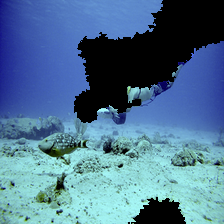

  coral reef: 36.56%
sea cucumber: 20.92%
   jellyfish:  9.70%
     snorkel:  5.69%
       conch:  3.20%
    lionfish:  3.14%
 scuba diver:  2.55%
 brain coral:  1.88%
   sea snake:  1.84%
       wreck:  1.38%



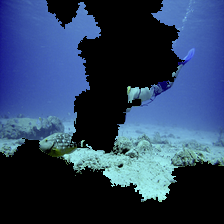

  coral reef: 35.18%
 scuba diver: 17.25%
   jellyfish: 13.68%
    lionfish: 11.13%
     snorkel:  3.30%
 brain coral:  2.32%
sea cucumber:  1.85%
       wreck:  1.61%
       conch:  1.53%
       cliff:  0.97%



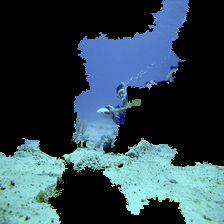

scuba diver: 93.70%
       jeep:  3.08%
 coral reef:  1.32%
      wreck:  0.56%
   lionfish:  0.25%
    tractor:  0.18%
    snorkel:  0.18%
brain coral:  0.08%
  amphibian:  0.07%
   snowplow:  0.07%



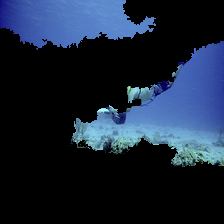

 parachute: 74.83%
   balloon:  7.72%
 jellyfish:  6.97%
  lakeside:  1.25%
coral reef:  0.97%
       alp:  0.76%
promontory:  0.75%
     cliff:  0.74%
   airship:  0.72%
  seashore:  0.45%



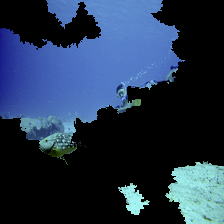

 scuba diver: 77.35%
  coral reef:  8.62%
       wreck:  5.21%
    lionfish:  2.90%
      castle:  1.35%
   jellyfish:  1.01%
     volcano:  0.33%
    lakeside:  0.24%
       cliff:  0.22%
analog clock:  0.18%



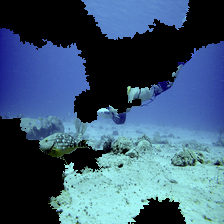

  coral reef: 28.63%
   jellyfish: 21.56%
   parachute:  6.72%
         alp:  5.25%
sea cucumber:  4.28%
       cliff:  3.38%
    lionfish:  2.95%
  promontory:  2.85%
 brain coral:  2.43%
     balloon:  2.34%



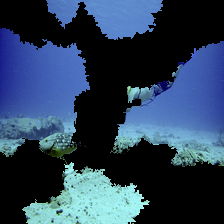

  coral reef: 53.40%
   jellyfish: 15.01%
    lionfish:  7.77%
 brain coral:  4.92%
 scuba diver:  3.41%
sea cucumber:  3.16%
       conch:  2.19%
     volcano:  1.51%
   sea snake:  1.22%
    sea slug:  0.90%



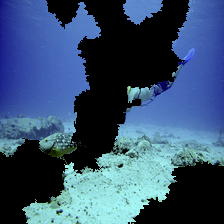

  coral reef: 47.72%
    lionfish: 15.78%
   jellyfish:  8.68%
sea cucumber:  7.63%
 scuba diver:  6.59%
 brain coral:  2.85%
    sea slug:  1.68%
       conch:  1.40%
     snorkel:  0.89%
       wreck:  0.73%



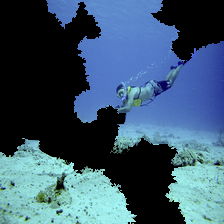

scuba diver: 51.64%
 coral reef: 24.77%
    snorkel: 12.31%
   lionfish:  4.88%
  jellyfish:  1.97%
  sea snake:  0.91%
brain coral:  0.47%
     puffer:  0.41%
      conch:  0.25%
green snake:  0.23%



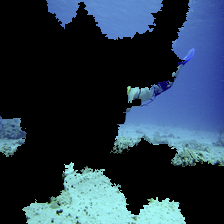

   jellyfish: 24.05%
  coral reef: 18.94%
sea cucumber: 17.02%
    lionfish:  6.73%
       wreck:  3.52%
       cliff:  2.61%
   parachute:  2.20%
 brain coral:  2.15%
    sea slug:  1.53%
  promontory:  1.45%



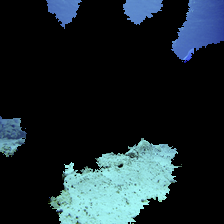

     volcano: 24.16%
  coral reef: 15.26%
   jellyfish: 12.83%
coral fungus:  7.89%
    lakeside:  3.38%
    mushroom:  3.30%
       cliff:  2.92%
  promontory:  2.42%
picket fence:  2.20%
 brain coral:  2.04%



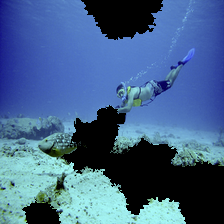

scuba diver: 42.92%
 coral reef: 39.93%
    snorkel: 12.25%
   lionfish:  2.58%
  sea snake:  0.66%
     puffer:  0.37%
 loggerhead:  0.26%
brain coral:  0.16%
        eel:  0.09%
      wreck:  0.07%



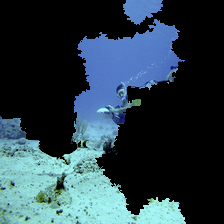

 scuba diver: 84.97%
  coral reef:  6.49%
       wreck:  1.28%
        jeep:  1.13%
    lionfish:  1.02%
     snorkel:  0.54%
     tractor:  0.50%
   jellyfish:  0.49%
 brain coral:  0.36%
sea cucumber:  0.25%



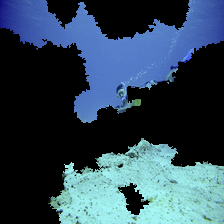

 scuba diver: 89.66%
  coral reef:  6.60%
    lionfish:  0.73%
       wreck:  0.67%
   jellyfish:  0.40%
 brain coral:  0.28%
     volcano:  0.19%
     snorkel:  0.18%
       cliff:  0.17%
sea cucumber:  0.09%



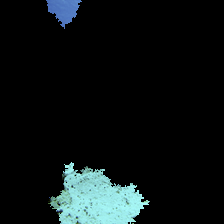

         volcano: 30.79%
       jellyfish: 24.60%
    coral fungus:  7.35%
      coral reef:  5.41%
      matchstick:  2.36%
        mushroom:  2.18%
        lakeside:  0.97%
          geyser:  0.89%
hen-of-the-woods:  0.71%
             ant:  0.71%



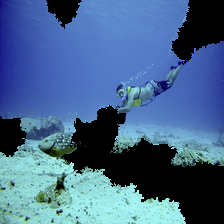

scuba diver: 48.11%
 coral reef: 27.77%
    snorkel: 15.47%
   lionfish:  4.11%
  sea snake:  0.53%
brain coral:  0.50%
     puffer:  0.48%
  jellyfish:  0.39%
      conch:  0.27%
      wreck:  0.27%



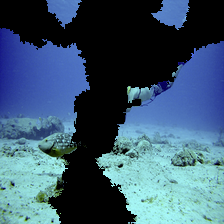

  coral reef: 24.62%
    lionfish:  9.11%
   jellyfish:  9.08%
 scuba diver:  5.96%
sea cucumber:  5.88%
       cliff:  5.02%
 brain coral:  2.93%
   sea snake:  2.84%
     snorkel:  2.82%
     volcano:  2.52%



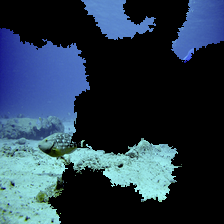

    volcano: 38.24%
 coral reef: 32.41%
  jellyfish: 11.15%
      cliff:  3.43%
 promontory:  2.95%
brain coral:  1.41%
     geyser:  1.39%
   lakeside:  0.98%
scuba diver:  0.69%
    snorkel:  0.66%



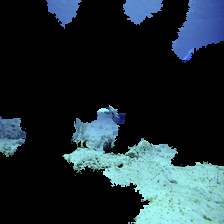

  jellyfish: 22.02%
 coral reef: 18.20%
    volcano:  9.35%
     valley:  7.98%
 promontory:  6.29%
      cliff:  5.72%
      conch:  3.08%
brain coral:  2.86%
   lakeside:  2.69%
        alp:  1.63%



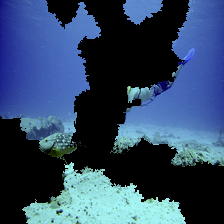

  coral reef: 35.48%
    lionfish: 21.11%
   jellyfish: 16.89%
sea cucumber:  6.86%
 scuba diver:  4.04%
 brain coral:  2.10%
    sea slug:  1.47%
       conch:  0.96%
       wreck:  0.89%
     snorkel:  0.73%



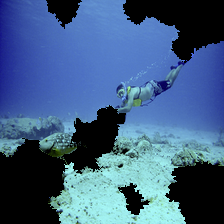

scuba diver: 48.02%
 coral reef: 39.91%
    snorkel:  7.64%
   lionfish:  2.12%
brain coral:  0.46%
  sea snake:  0.32%
  jellyfish:  0.28%
      conch:  0.11%
     puffer:  0.10%
 loggerhead:  0.07%



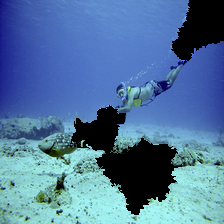

scuba diver: 56.21%
    snorkel: 17.13%
 coral reef: 16.74%
   lionfish:  3.44%
  sea snake:  0.93%
     puffer:  0.64%
      wreck:  0.50%
brain coral:  0.33%
      conch:  0.32%
 loggerhead:  0.31%



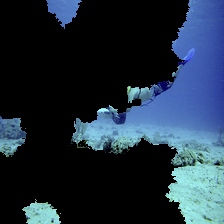

   jellyfish: 44.35%
     balloon: 16.35%
   parachute: 13.43%
  coral reef:  2.91%
       cliff:  2.05%
sea cucumber:  1.71%
       conch:  1.61%
      bubble:  1.24%
       stupa:  1.19%
     volcano:  1.13%



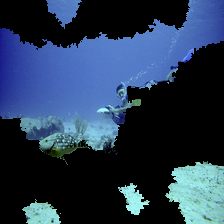

scuba diver: 72.61%
 coral reef: 15.24%
      wreck:  1.98%
   lionfish:  1.42%
     castle:  1.06%
    volcano:  0.97%
      cliff:  0.68%
  jellyfish:  0.62%
       jeep:  0.50%
   lakeside:  0.45%



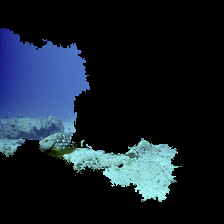

    volcano: 40.31%
 coral reef: 26.31%
  jellyfish: 12.61%
      cliff:  2.86%
brain coral:  2.31%
     geyser:  1.59%
scuba diver:  1.29%
        alp:  1.04%
 promontory:  1.00%
      conch:  0.92%



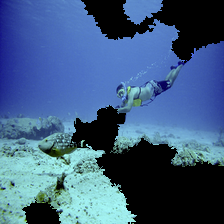

 coral reef: 39.01%
scuba diver: 37.68%
    snorkel: 11.68%
   lionfish:  4.78%
  sea snake:  1.59%
  jellyfish:  0.93%
brain coral:  0.70%
     puffer:  0.69%
 loggerhead:  0.30%
        eel:  0.24%



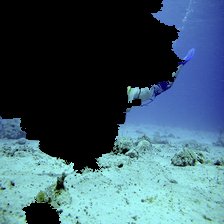

  coral reef: 27.98%
sea cucumber: 15.06%
   jellyfish:  7.53%
       wreck:  6.13%
 scuba diver:  6.13%
       conch:  4.80%
    sea slug:  3.75%
    lionfish:  2.56%
 brain coral:  2.55%
     sandbar:  2.21%



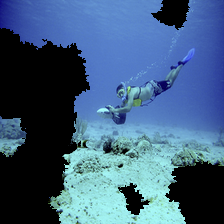

    snorkel: 52.51%
scuba diver: 29.47%
 coral reef: 15.89%
   lionfish:  1.16%
 loggerhead:  0.45%
        ski:  0.13%
  sea snake:  0.09%
rock beauty:  0.05%
      wreck:  0.04%
     puffer:  0.02%



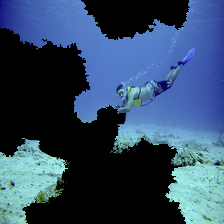

scuba diver: 34.99%
    snorkel: 31.50%
 coral reef: 28.43%
   lionfish:  1.73%
  sea snake:  0.66%
      cliff:  0.45%
  jellyfish:  0.41%
brain coral:  0.25%
 loggerhead:  0.17%
     puffer:  0.15%



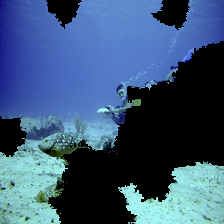

        scuba diver: 88.52%
         coral reef:  3.83%
              wreck:  3.10%
           lionfish:  0.95%
       sea cucumber:  0.65%
            snorkel:  0.57%
        brain coral:  0.47%
          jellyfish:  0.24%
Irish water spaniel:  0.16%
               jeep:  0.14%



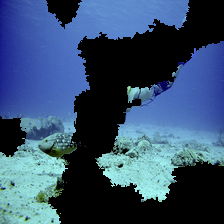

  coral reef: 34.79%
   jellyfish:  9.51%
    lionfish:  7.91%
 scuba diver:  5.95%
       wreck:  5.61%
  promontory:  4.35%
 brain coral:  3.23%
       conch:  3.20%
       cliff:  2.92%
sea cucumber:  2.62%



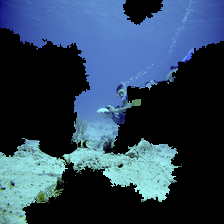

 scuba diver: 94.27%
  coral reef:  2.61%
     snorkel:  0.44%
        jeep:  0.42%
       wreck:  0.38%
 brain coral:  0.33%
    lionfish:  0.29%
     volcano:  0.23%
sea cucumber:  0.16%
       cliff:  0.12%



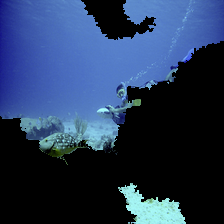

scuba diver: 75.75%
 coral reef: 13.64%
      wreck:  4.96%
     castle:  0.78%
   lionfish:  0.71%
      cliff:  0.60%
   lakeside:  0.45%
       jeep:  0.41%
  jellyfish:  0.28%
    volcano:  0.24%



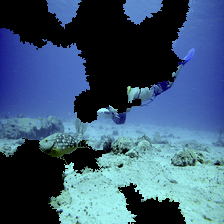

  coral reef: 43.69%
   jellyfish: 17.12%
sea cucumber:  8.25%
   parachute:  6.57%
    lionfish:  5.34%
 brain coral:  2.40%
 scuba diver:  1.53%
     balloon:  1.44%
     snorkel:  1.43%
       conch:  1.17%



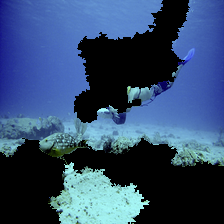

  coral reef: 34.70%
   jellyfish: 28.26%
sea cucumber: 15.15%
      chiton:  4.28%
    lionfish:  4.10%
    sea slug:  2.76%
       conch:  1.63%
 scuba diver:  1.04%
   parachute:  0.88%
  sea urchin:  0.82%



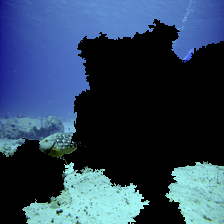

  coral reef: 66.62%
 scuba diver: 10.40%
     volcano:  6.49%
 brain coral:  4.89%
   jellyfish:  2.50%
sea cucumber:  1.63%
       cliff:  1.28%
       wreck:  0.95%
  promontory:  0.92%
       conch:  0.59%



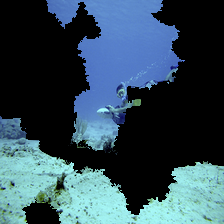

 scuba diver: 95.09%
       wreck:  1.69%
  coral reef:  1.27%
    lionfish:  0.38%
sea cucumber:  0.27%
     snorkel:  0.15%
        jeep:  0.12%
 brain coral:  0.09%
      castle:  0.09%
     volcano:  0.08%



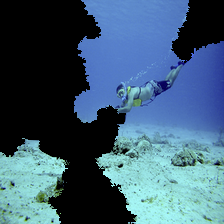

 scuba diver: 76.36%
     snorkel: 15.58%
  coral reef:  3.38%
    lionfish:  1.90%
   sea snake:  0.50%
       wreck:  0.26%
   jellyfish:  0.20%
sea cucumber:  0.19%
      puffer:  0.19%
 green snake:  0.12%



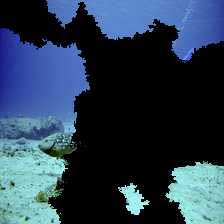

  coral reef: 52.39%
 scuba diver:  8.78%
     volcano:  7.06%
   jellyfish:  6.46%
       wreck:  3.88%
sea cucumber:  3.48%
 brain coral:  3.38%
       cliff:  2.62%
  promontory:  2.52%
       conch:  1.32%



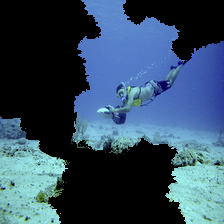

scuba diver: 41.35%
    snorkel: 39.89%
 coral reef: 13.46%
   lionfish:  2.48%
  jellyfish:  0.40%
      cliff:  0.37%
        ski:  0.22%
 loggerhead:  0.21%
      wreck:  0.17%
  sea snake:  0.16%



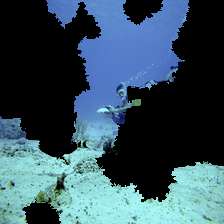

   scuba diver: 86.88%
    coral reef:  2.47%
      lionfish:  1.60%
  sea cucumber:  1.06%
Scotch terrier:  1.01%
         wreck:  0.69%
     jellyfish:  0.43%
  analog clock:  0.42%
   brain coral:  0.42%
          jeep:  0.37%



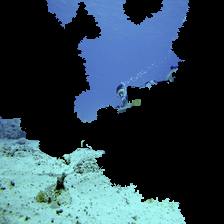

 scuba diver: 67.35%
  coral reef:  9.13%
       wreck:  3.25%
      castle:  3.13%
    lionfish:  2.08%
     volcano:  1.39%
   jellyfish:  1.17%
analog clock:  1.11%
       cliff:  0.97%
        jeep:  0.74%



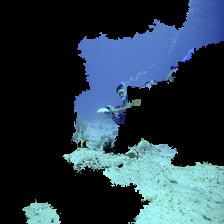

 scuba diver: 95.01%
  coral reef:  1.80%
        jeep:  1.17%
       wreck:  1.06%
    lionfish:  0.19%
     snorkel:  0.11%
 brain coral:  0.10%
     tractor:  0.05%
     volcano:  0.05%
sea cucumber:  0.05%



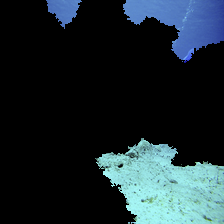

       volcano: 40.08%
         cliff: 19.05%
        geyser:  5.74%
    promontory:  5.65%
           alp:  4.32%
    coral reef:  2.58%
        valley:  2.49%
      lakeside:  1.69%
     jellyfish:  1.68%
cliff dwelling:  1.55%



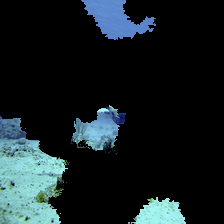

 coral reef: 25.14%
    volcano: 20.32%
  jellyfish: 16.48%
      cliff:  5.00%
 promontory:  4.69%
      wreck:  3.32%
      conch:  3.16%
scuba diver:  1.59%
brain coral:  1.46%
     geyser:  1.08%



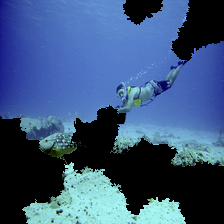

  coral reef: 50.64%
 scuba diver: 37.00%
    lionfish:  4.78%
     snorkel:  3.54%
      puffer:  0.64%
   sea snake:  0.62%
   jellyfish:  0.52%
 brain coral:  0.45%
  loggerhead:  0.20%
anemone fish:  0.15%



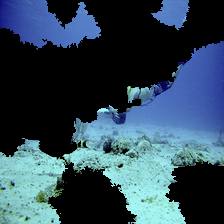

  coral reef: 23.17%
   jellyfish: 22.79%
       cliff:  4.70%
   parachute:  4.55%
sea cucumber:  3.70%
         alp:  3.15%
     balloon:  2.72%
       conch:  2.54%
 brain coral:  2.42%
  promontory:  2.13%



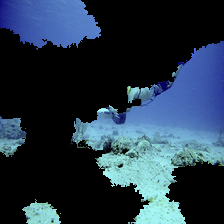

 jellyfish: 20.86%
coral reef: 19.87%
   balloon:  6.94%
     cliff:  5.89%
 parachute:  5.82%
     conch:  3.16%
       alp:  3.01%
promontory:  2.85%
  lakeside:  2.60%
     stupa:  1.98%



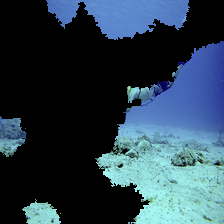

  jellyfish: 14.26%
      cliff: 10.07%
 coral reef:  7.56%
      wreck:  5.48%
   lakeside:  4.65%
   lionfish:  3.06%
brain coral:  3.01%
  parachute:  2.96%
      stupa:  2.84%
     bubble:  2.80%



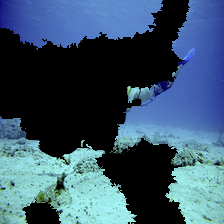

   jellyfish: 21.53%
  coral reef: 15.17%
sea cucumber: 11.42%
  promontory:  8.52%
       cliff:  7.46%
     volcano:  3.54%
 brain coral:  2.43%
     sandbar:  2.41%
    lakeside:  2.29%
   parachute:  1.94%



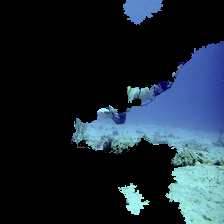

 parachute: 49.54%
 jellyfish: 14.19%
   balloon: 10.83%
     stupa:  2.17%
coral reef:  2.05%
  lakeside:  1.80%
     cliff:  1.34%
       alp:  1.32%
    bubble:  0.98%
     conch:  0.93%



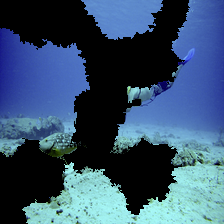

   jellyfish: 35.37%
  coral reef: 28.69%
sea cucumber: 10.05%
    lionfish:  5.79%
 brain coral:  3.48%
       conch:  2.27%
    sea slug:  1.96%
 scuba diver:  1.81%
     volcano:  1.07%
       wreck:  0.71%



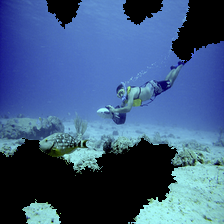

 coral reef: 68.64%
scuba diver: 19.22%
    snorkel:  7.44%
   lionfish:  2.49%
 loggerhead:  0.31%
  jellyfish:  0.19%
  sea snake:  0.17%
rock beauty:  0.15%
     puffer:  0.13%
      cliff:  0.12%



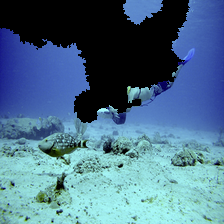

  coral reef: 25.88%
sea cucumber: 22.94%
   jellyfish: 18.27%
    lionfish:  5.32%
     snorkel:  4.96%
       conch:  3.77%
   parachute:  3.13%
 brain coral:  2.88%
    sea slug:  1.81%
   sea snake:  1.25%



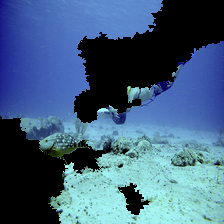

  coral reef: 41.31%
   jellyfish: 10.25%
sea cucumber:  8.31%
 scuba diver:  3.81%
    lionfish:  3.11%
   parachute:  2.83%
       wreck:  2.58%
     snorkel:  2.52%
  promontory:  2.41%
       cliff:  2.03%



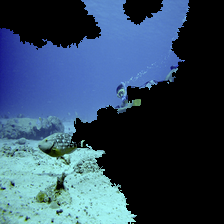

scuba diver: 42.34%
 coral reef: 30.76%
  jellyfish:  6.98%
   lionfish:  5.51%
      wreck:  3.08%
    volcano:  1.64%
     castle:  1.01%
brain coral:  0.90%
   lakeside:  0.59%
    snorkel:  0.56%



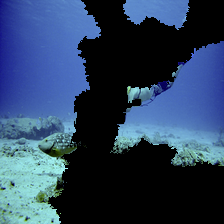

  coral reef: 25.69%
   jellyfish: 20.14%
    lionfish:  6.78%
       cliff:  5.78%
       wreck:  4.47%
sea cucumber:  4.04%
  promontory:  3.86%
    lakeside:  3.78%
 scuba diver:  3.07%
     volcano:  2.53%



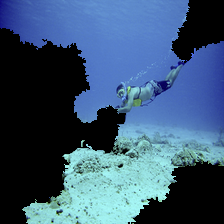

scuba diver: 54.88%
    snorkel: 27.31%
 coral reef: 14.03%
   lionfish:  1.60%
  sea snake:  0.61%
     puffer:  0.22%
      cliff:  0.14%
brain coral:  0.14%
  jellyfish:  0.08%
      wreck:  0.08%



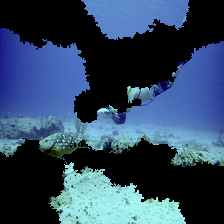

  coral reef: 39.42%
   jellyfish: 30.93%
   parachute:  7.40%
sea cucumber:  4.89%
    lionfish:  3.28%
 brain coral:  1.96%
     balloon:  1.22%
    sea slug:  1.13%
       conch:  0.97%
       cliff:  0.71%



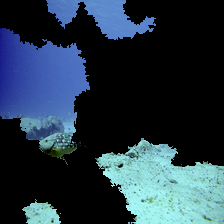

 coral reef: 28.05%
  jellyfish: 20.18%
    volcano: 16.90%
brain coral:  3.51%
scuba diver:  2.34%
      conch:  2.27%
      cliff:  1.95%
   lionfish:  1.83%
      wreck:  1.78%
   lakeside:  1.36%



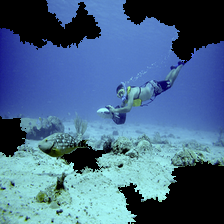

  coral reef: 39.62%
     snorkel: 36.83%
 scuba diver: 16.73%
    lionfish:  4.12%
         ski:  0.64%
   sea snake:  0.34%
  loggerhead:  0.32%
 rock beauty:  0.26%
       wreck:  0.14%
anemone fish:  0.09%



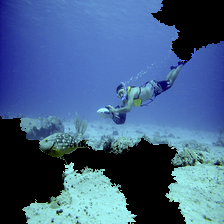

scuba diver: 49.99%
 coral reef: 25.91%
    snorkel: 15.96%
   lionfish:  2.63%
        ski:  0.86%
 loggerhead:  0.85%
      cliff:  0.59%
  sea snake:  0.49%
      wreck:  0.36%
rock beauty:  0.13%



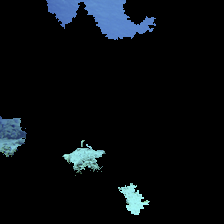

     volcano: 15.44%
   jellyfish: 15.04%
    lakeside: 13.41%
  coral reef: 11.04%
       cliff:  5.79%
      castle:  4.05%
     obelisk:  3.07%
picket fence:  2.47%
      geyser:  1.85%
         alp:  1.23%



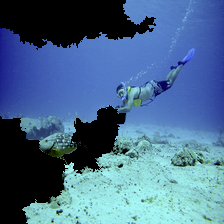

scuba diver: 47.97%
    snorkel: 27.97%
 coral reef: 18.02%
   lionfish:  4.04%
  sea snake:  0.47%
     puffer:  0.23%
 loggerhead:  0.20%
brain coral:  0.09%
        ski:  0.09%
 hammerhead:  0.08%



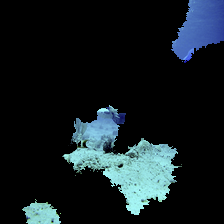

   jellyfish: 65.50%
     volcano:  7.06%
  coral reef:  3.70%
       conch:  2.03%
 brain coral:  1.94%
coral fungus:  1.74%
    mushroom:  0.89%
  promontory:  0.68%
       dough:  0.56%
      geyser:  0.49%



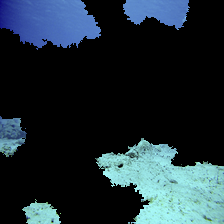

 coral reef: 30.62%
    volcano: 13.38%
      cliff: 10.94%
  jellyfish:  8.82%
 promontory:  6.21%
   lakeside:  5.53%
     valley:  2.90%
brain coral:  2.19%
     geyser:  2.05%
    sandbar:  1.60%



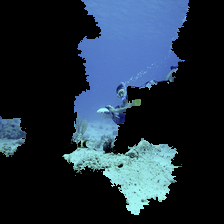

scuba diver: 94.15%
       jeep:  2.88%
      wreck:  1.41%
 coral reef:  0.42%
     castle:  0.11%
   snowplow:  0.11%
    snorkel:  0.09%
   lionfish:  0.08%
  amphibian:  0.08%
      cliff:  0.07%



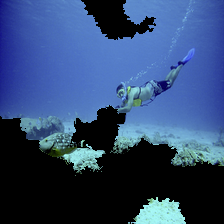

 scuba diver: 57.82%
  coral reef: 28.85%
     snorkel:  6.86%
    lionfish:  4.28%
      puffer:  0.44%
  loggerhead:  0.43%
   sea snake:  0.35%
       wreck:  0.19%
  hammerhead:  0.09%
electric ray:  0.06%



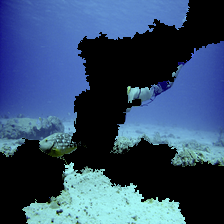

  coral reef: 47.23%
    lionfish: 14.68%
sea cucumber:  6.85%
   jellyfish:  6.29%
 scuba diver:  5.47%
 brain coral:  3.75%
       wreck:  1.79%
       conch:  1.64%
     volcano:  1.48%
    sea slug:  1.41%



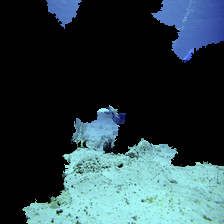

     jellyfish: 29.14%
       volcano:  9.73%
    coral reef:  4.76%
   brain coral:  3.34%
         conch:  3.33%
Scotch terrier:  2.31%
        valley:  2.11%
        geyser:  1.94%
  sea cucumber:  1.64%
    promontory:  1.62%



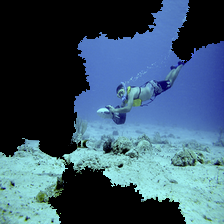

     snorkel: 76.00%
 scuba diver: 17.12%
  coral reef:  3.85%
    lionfish:  1.63%
         ski:  0.59%
  loggerhead:  0.12%
   sea snake:  0.12%
 rock beauty:  0.05%
       wreck:  0.04%
anemone fish:  0.04%



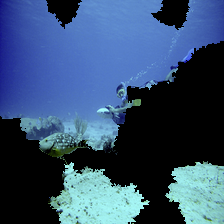

 scuba diver: 88.55%
  coral reef:  6.27%
       wreck:  1.60%
    lionfish:  1.12%
 brain coral:  0.47%
     snorkel:  0.34%
   jellyfish:  0.32%
sea cucumber:  0.29%
     volcano:  0.09%
      castle:  0.06%



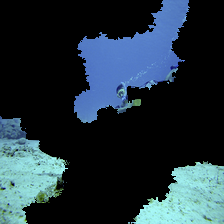

scuba diver: 52.41%
      wreck: 20.46%
      cliff:  6.03%
 coral reef:  3.89%
     castle:  3.53%
    volcano:  2.27%
 promontory:  1.22%
       jeep:  1.13%
   lakeside:  0.74%
 breakwater:  0.64%



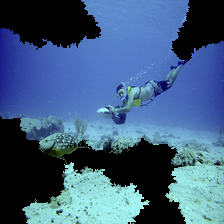

 scuba diver: 48.84%
  coral reef: 23.46%
     snorkel: 20.22%
    lionfish:  3.70%
  loggerhead:  0.59%
   sea snake:  0.38%
         ski:  0.29%
      puffer:  0.24%
sea cucumber:  0.23%
       wreck:  0.21%



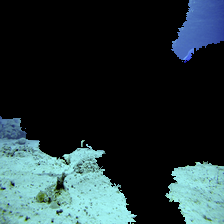

  promontory: 24.91%
  coral reef: 19.46%
     volcano:  9.78%
       cliff:  8.19%
   jellyfish:  6.30%
sea cucumber:  4.50%
    lakeside:  3.73%
       wreck:  1.92%
    seashore:  1.61%
       conch:  1.60%



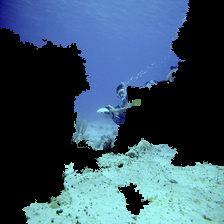

 scuba diver: 97.66%
  coral reef:  0.77%
       wreck:  0.53%
        jeep:  0.40%
     snorkel:  0.17%
    lionfish:  0.12%
 brain coral:  0.05%
sea cucumber:  0.03%
    snowplow:  0.03%
     tractor:  0.03%



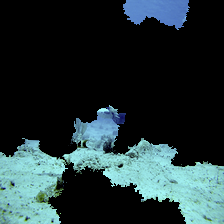

        valley: 26.17%
       volcano: 12.31%
    coral reef:  8.18%
     jellyfish:  6.23%
         cliff:  4.21%
   brain coral:  2.73%
         conch:  2.67%
           alp:  2.36%
cliff dwelling:  2.14%
    promontory:  1.98%



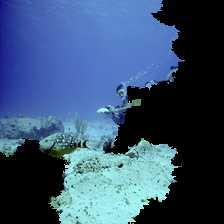

scuba diver: 88.62%
 coral reef:  7.97%
      wreck:  1.37%
brain coral:  0.42%
       jeep:  0.40%
   lionfish:  0.22%
    tractor:  0.13%
  sea snake:  0.08%
  jellyfish:  0.07%
    snorkel:  0.05%



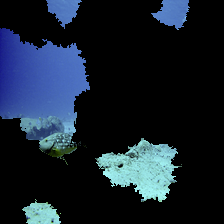

  jellyfish: 41.49%
    volcano: 21.89%
 coral reef: 11.69%
brain coral:  1.80%
      cliff:  1.46%
    obelisk:  1.33%
scuba diver:  1.27%
     bubble:  1.26%
     geyser:  1.02%
   lionfish:  0.92%



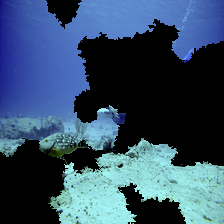

  coral reef: 72.74%
 scuba diver: 12.07%
 brain coral:  2.75%
   jellyfish:  2.55%
     volcano:  2.11%
  promontory:  1.67%
       wreck:  1.19%
       cliff:  1.15%
    lionfish:  0.60%
sea cucumber:  0.43%



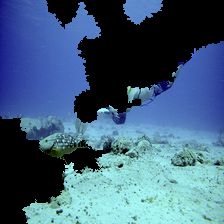

  coral reef: 44.53%
   jellyfish: 20.79%
    lionfish:  4.32%
sea cucumber:  4.16%
   parachute:  3.97%
 brain coral:  2.22%
     balloon:  1.58%
         alp:  1.24%
    sea slug:  1.16%
 scuba diver:  1.13%



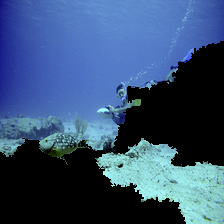

 scuba diver: 88.40%
       wreck:  5.43%
  coral reef:  2.63%
        jeep:  1.75%
       cliff:  0.29%
 brain coral:  0.13%
     snorkel:  0.13%
sea cucumber:  0.09%
   amphibian:  0.08%
     tractor:  0.08%



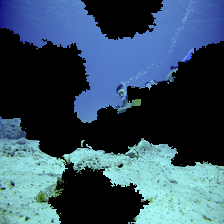

 scuba diver: 80.23%
  coral reef: 10.74%
       wreck:  1.58%
       cliff:  1.18%
     volcano:  0.77%
    lionfish:  0.72%
     snorkel:  0.61%
 brain coral:  0.55%
sea cucumber:  0.53%
   jellyfish:  0.51%



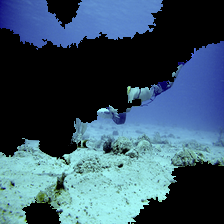

   jellyfish: 31.59%
   parachute: 18.32%
  coral reef: 10.32%
     balloon:  5.44%
       cliff:  3.27%
  promontory:  3.14%
         alp:  2.72%
sea cucumber:  2.22%
       conch:  2.12%
     volcano:  2.10%



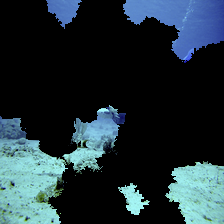

       volcano: 23.72%
    coral reef: 21.08%
         cliff: 15.12%
    promontory:  6.72%
     jellyfish:  6.56%
   brain coral:  2.40%
        valley:  2.35%
   scuba diver:  1.86%
cliff dwelling:  1.58%
         conch:  1.56%



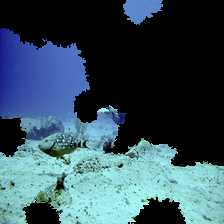

  coral reef: 63.05%
 brain coral:  5.43%
   sea snake:  3.90%
sea cucumber:  3.46%
       conch:  2.93%
 scuba diver:  2.56%
     volcano:  2.07%
    lionfish:  1.80%
   jellyfish:  1.32%
       wreck:  0.83%



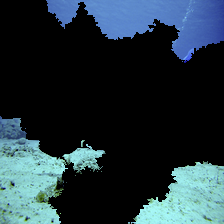

         cliff: 52.25%
    promontory: 15.22%
       volcano:  8.12%
    coral reef:  6.07%
         wreck:  4.61%
      lakeside:  3.11%
        valley:  2.00%
  sea cucumber:  1.13%
   scuba diver:  0.88%
cliff dwelling:  0.80%



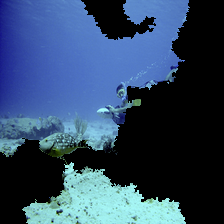

 scuba diver: 77.05%
  coral reef: 17.29%
       wreck:  1.45%
    lionfish:  1.13%
 brain coral:  0.48%
     snorkel:  0.37%
        jeep:  0.32%
      castle:  0.20%
   sea snake:  0.18%
sea cucumber:  0.14%



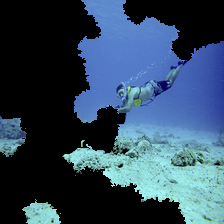

scuba diver: 48.89%
    snorkel: 28.02%
 coral reef: 14.56%
   lionfish:  4.45%
  jellyfish:  0.93%
  sea snake:  0.31%
      conch:  0.24%
green snake:  0.21%
      cliff:  0.21%
     puffer:  0.21%



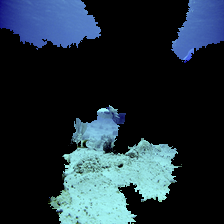

   jellyfish: 26.14%
     volcano: 24.54%
  coral reef: 10.16%
coral fungus:  2.01%
  promontory:  1.86%
       cliff:  1.62%
 brain coral:  1.46%
      valley:  1.33%
      geyser:  1.16%
         alp:  1.02%



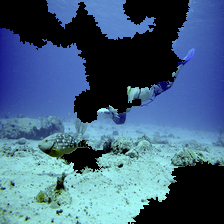

  coral reef: 48.91%
   jellyfish: 20.46%
sea cucumber:  8.49%
    lionfish:  6.81%
       conch:  1.98%
 brain coral:  1.93%
     snorkel:  1.68%
    sea slug:  1.14%
   parachute:  0.90%
  sea urchin:  0.85%



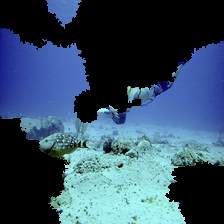

   jellyfish: 25.17%
  coral reef: 23.32%
     balloon: 12.93%
sea cucumber:  7.41%
   parachute:  4.72%
    sea slug:  2.93%
         alp:  1.59%
       conch:  1.38%
    flatworm:  1.36%
       bison:  1.31%



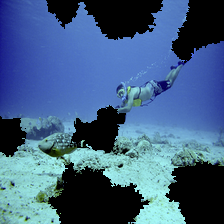

 scuba diver: 62.55%
     snorkel: 17.63%
  coral reef: 13.56%
    lionfish:  4.04%
 brain coral:  0.37%
       conch:  0.20%
   sea snake:  0.20%
   jellyfish:  0.19%
      puffer:  0.11%
anemone fish:  0.11%



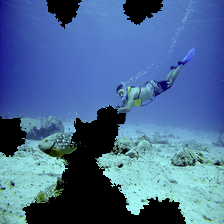

    snorkel: 36.69%
scuba diver: 32.63%
 coral reef: 26.45%
   lionfish:  2.49%
 loggerhead:  0.22%
  sea snake:  0.22%
      wreck:  0.13%
      cliff:  0.11%
brain coral:  0.11%
 hammerhead:  0.09%



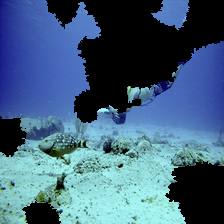

  coral reef: 52.93%
   jellyfish: 13.89%
sea cucumber:  6.13%
    lionfish:  4.46%
 scuba diver:  2.89%
 brain coral:  2.65%
       conch:  1.95%
   sea snake:  1.87%
     snorkel:  1.45%
    sea slug:  1.17%



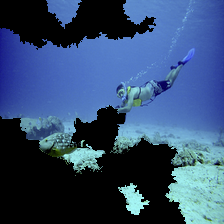

scuba diver: 46.03%
 coral reef: 32.96%
    snorkel: 15.95%
   lionfish:  2.90%
  sea snake:  0.31%
     puffer:  0.28%
 loggerhead:  0.23%
      wreck:  0.16%
      cliff:  0.11%
 hammerhead:  0.11%



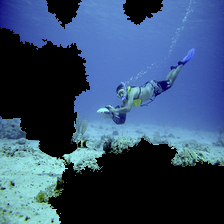

    snorkel: 43.49%
 coral reef: 31.17%
scuba diver: 20.76%
   lionfish:  2.49%
 loggerhead:  1.14%
     puffer:  0.11%
rock beauty:  0.11%
        ski:  0.07%
      wreck:  0.06%
  sea snake:  0.06%



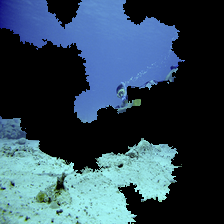

scuba diver: 52.18%
 coral reef: 26.29%
  jellyfish:  4.44%
      wreck:  3.19%
    volcano:  1.91%
     castle:  1.83%
brain coral:  1.15%
   lionfish:  1.09%
      cliff:  0.86%
    snorkel:  0.60%



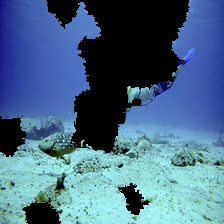

  coral reef: 34.52%
 scuba diver: 16.75%
sea cucumber: 12.92%
    lionfish:  8.00%
   jellyfish:  7.92%
     snorkel:  2.91%
       conch:  2.09%
 brain coral:  1.73%
  sea urchin:  0.97%
       wreck:  0.93%



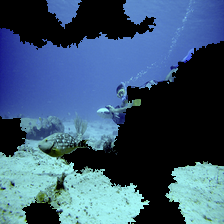

 scuba diver: 65.58%
  coral reef: 20.98%
       wreck:  2.79%
        jeep:  1.86%
sea cucumber:  1.24%
    lionfish:  1.18%
 brain coral:  0.79%
     tractor:  0.51%
     snorkel:  0.49%
    snowplow:  0.45%



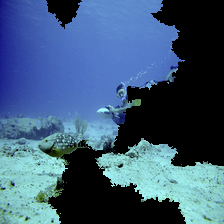

scuba diver: 94.36%
 coral reef:  2.47%
      wreck:  1.73%
   lionfish:  0.30%
       jeep:  0.20%
brain coral:  0.17%
    snorkel:  0.16%
  jellyfish:  0.07%
    volcano:  0.05%
     castle:  0.04%



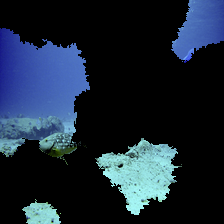

       jellyfish: 38.04%
      coral reef: 22.55%
         volcano: 14.83%
     brain coral:  5.64%
    coral fungus:  2.11%
           conch:  1.10%
        mushroom:  1.05%
        broccoli:  0.98%
hen-of-the-woods:  0.70%
    head cabbage:  0.60%



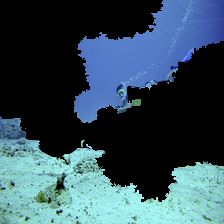

 scuba diver: 74.38%
  coral reef:  6.93%
       wreck:  3.78%
       cliff:  2.32%
    lionfish:  1.34%
        jeep:  1.18%
      castle:  1.11%
sea cucumber:  1.05%
  promontory:  0.72%
     snorkel:  0.70%



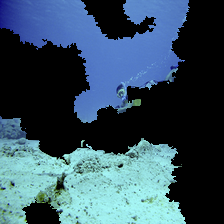

scuba diver: 58.10%
 coral reef: 24.86%
   lionfish:  2.23%
       jeep:  1.40%
      wreck:  1.39%
     castle:  0.91%
    volcano:  0.91%
      cliff:  0.77%
brain coral:  0.67%
  jellyfish:  0.64%



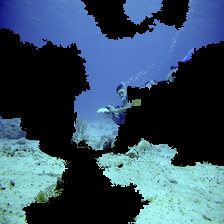

 scuba diver: 90.24%
  coral reef:  3.04%
        jeep:  2.51%
       wreck:  1.40%
sea cucumber:  0.41%
     snorkel:  0.37%
    lionfish:  0.32%
 brain coral:  0.29%
       cliff:  0.26%
     volcano:  0.19%



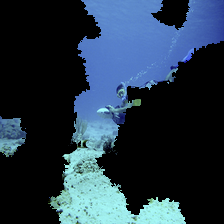

scuba diver: 92.43%
 coral reef:  2.97%
      wreck:  2.59%
   lionfish:  0.33%
    snorkel:  0.24%
brain coral:  0.17%
       jeep:  0.16%
  jellyfish:  0.15%
      cliff:  0.12%
     castle:  0.10%



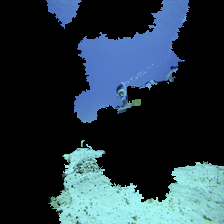

scuba diver: 67.01%
 coral reef:  6.10%
   lionfish:  3.04%
     castle:  3.02%
      wreck:  1.58%
       jeep:  1.54%
      cliff:  1.26%
    volcano:  1.14%
   snowplow:  0.98%
    tractor:  0.97%



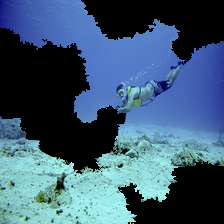

     snorkel: 47.08%
 scuba diver: 29.16%
  coral reef: 17.21%
    lionfish:  2.91%
   sea snake:  0.66%
   jellyfish:  0.65%
 brain coral:  0.46%
       conch:  0.21%
sea cucumber:  0.18%
       cliff:  0.12%



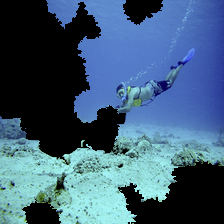

scuba diver: 37.60%
    snorkel: 34.94%
 coral reef: 23.16%
   lionfish:  3.04%
 loggerhead:  0.28%
     puffer:  0.22%
  sea snake:  0.19%
 hammerhead:  0.06%
brain coral:  0.04%
      wreck:  0.04%



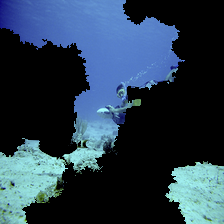

 scuba diver: 88.73%
  coral reef:  3.69%
       wreck:  1.38%
     volcano:  1.30%
     snorkel:  0.76%
       cliff:  0.61%
 brain coral:  0.50%
sea cucumber:  0.47%
    lionfish:  0.39%
   jellyfish:  0.27%



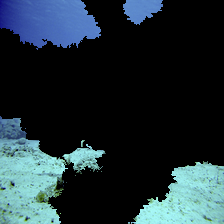

       cliff: 24.84%
  coral reef: 16.69%
  promontory: 16.20%
     volcano: 15.82%
    lakeside:  6.63%
      valley:  5.63%
     sandbar:  3.30%
sea cucumber:  1.58%
    seashore:  1.08%
 brain coral:  0.64%



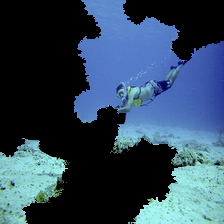

scuba diver: 38.93%
 coral reef: 25.43%
    snorkel: 19.16%
   lionfish:  5.23%
  jellyfish:  4.67%
  sea snake:  0.96%
      cliff:  0.78%
green snake:  0.52%
     puffer:  0.52%
brain coral:  0.49%



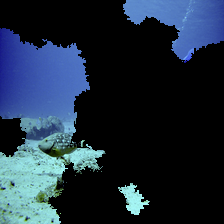

 coral reef: 37.62%
    volcano: 12.38%
scuba diver:  9.95%
      wreck:  4.46%
      cliff:  4.43%
  jellyfish:  3.84%
 promontory:  3.24%
     castle:  3.04%
   lakeside:  1.89%
     geyser:  1.37%



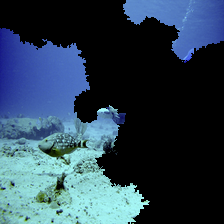

  coral reef: 65.70%
 scuba diver:  6.99%
   jellyfish:  4.15%
 brain coral:  3.53%
sea cucumber:  3.14%
     volcano:  2.50%
     snorkel:  1.96%
    lionfish:  1.85%
       conch:  1.67%
   sea snake:  1.58%



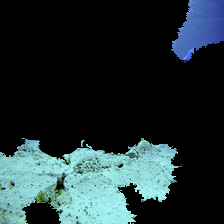

  coral reef: 49.53%
   jellyfish: 18.88%
coral fungus:  4.47%
     volcano:  3.24%
 brain coral:  3.19%
sea cucumber:  1.42%
    sea slug:  1.37%
         ant:  1.36%
  sea urchin:  0.92%
      chiton:  0.82%



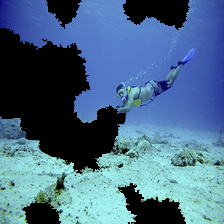

     snorkel: 47.34%
 scuba diver: 36.66%
  coral reef: 13.79%
    lionfish:  1.25%
 brain coral:  0.14%
   sea snake:  0.12%
  loggerhead:  0.09%
   jellyfish:  0.07%
       conch:  0.07%
sea cucumber:  0.06%



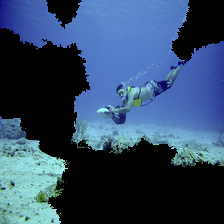

    snorkel: 36.67%
scuba diver: 30.73%
 coral reef: 27.30%
   lionfish:  2.37%
 loggerhead:  0.63%
      wreck:  0.27%
        ski:  0.24%
  jellyfish:  0.21%
      cliff:  0.15%
  sea snake:  0.14%



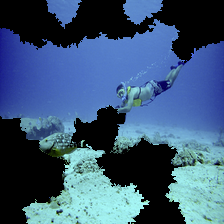

  coral reef: 40.60%
 scuba diver: 30.66%
     snorkel:  9.41%
    lionfish:  8.71%
   jellyfish:  1.96%
   sea snake:  1.65%
 brain coral:  1.33%
      puffer:  0.65%
anemone fish:  0.39%
 green snake:  0.34%



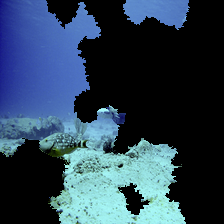

  coral reef: 78.98%
   jellyfish:  5.82%
 brain coral:  5.07%
 scuba diver:  2.66%
     volcano:  1.86%
    lionfish:  0.80%
sea cucumber:  0.62%
   sea snake:  0.49%
       wreck:  0.30%
    sea slug:  0.25%



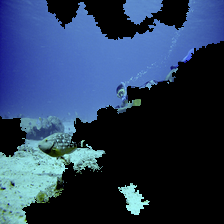

scuba diver: 65.38%
 coral reef: 17.10%
      wreck:  9.15%
     castle:  1.98%
   lionfish:  1.45%
       jeep:  0.97%
  jellyfish:  0.36%
   lakeside:  0.32%
brain coral:  0.22%
      cliff:  0.20%



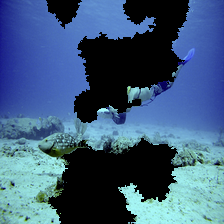

   jellyfish: 63.41%
  coral reef: 18.03%
sea cucumber:  4.95%
      chiton:  2.13%
    lionfish:  1.64%
       conch:  1.50%
   parachute:  1.42%
    sea slug:  0.96%
 brain coral:  0.74%
     snorkel:  0.70%



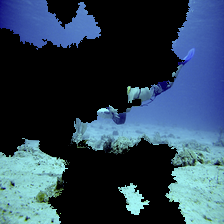

   jellyfish: 58.18%
  coral reef:  9.84%
sea cucumber:  6.60%
   parachute:  5.24%
     balloon:  4.30%
       conch:  1.49%
      chiton:  1.20%
    sea slug:  1.19%
    lionfish:  1.05%
   bottlecap:  0.72%



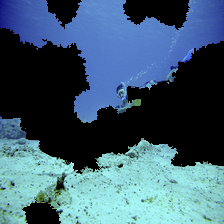

 scuba diver: 55.30%
  coral reef: 19.21%
       wreck:  5.12%
   jellyfish:  3.03%
 brain coral:  2.58%
       cliff:  1.61%
     snorkel:  1.58%
sea cucumber:  1.49%
     volcano:  1.39%
    lionfish:  1.24%



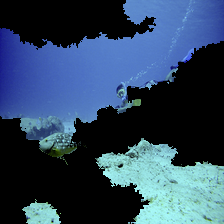

scuba diver: 56.66%
 coral reef: 30.08%
      wreck:  4.07%
   lionfish:  1.49%
  jellyfish:  1.02%
      cliff:  0.88%
brain coral:  0.68%
    volcano:  0.67%
       jeep:  0.59%
     castle:  0.41%



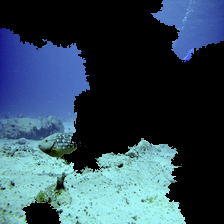

  coral reef: 54.51%
     volcano: 10.61%
   jellyfish:  6.96%
 brain coral:  6.01%
sea cucumber:  4.94%
 scuba diver:  3.21%
       cliff:  2.13%
    lionfish:  1.47%
       conch:  1.31%
   sea snake:  1.08%



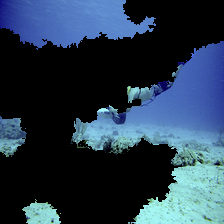

 jellyfish: 37.18%
 parachute: 11.32%
   balloon:  9.24%
coral reef:  7.35%
     cliff:  5.54%
promontory:  3.87%
   volcano:  3.62%
  lakeside:  2.95%
  seashore:  1.59%
     conch:  1.29%



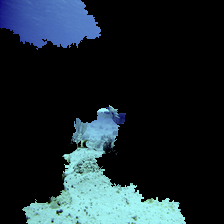

   jellyfish: 40.50%
  coral reef: 18.68%
     volcano:  7.25%
 brain coral:  3.22%
   sea snake:  2.66%
sea cucumber:  2.48%
       conch:  2.04%
       cliff:  1.61%
    stingray:  1.31%
       wreck:  1.26%



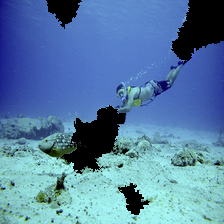

scuba diver: 71.48%
    snorkel: 18.02%
 coral reef:  7.54%
   lionfish:  1.49%
brain coral:  0.17%
      conch:  0.14%
 loggerhead:  0.12%
  sea snake:  0.11%
      wreck:  0.09%
     puffer:  0.09%



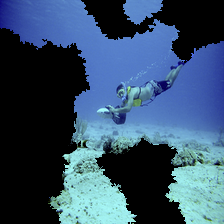

 coral reef: 44.21%
    snorkel: 31.82%
scuba diver: 17.22%
   lionfish:  3.63%
  sea snake:  0.45%
  jellyfish:  0.40%
        ski:  0.34%
 loggerhead:  0.25%
     puffer:  0.21%
brain coral:  0.13%



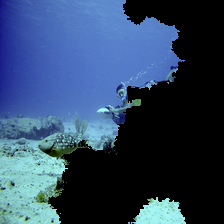

scuba diver: 84.11%
 coral reef:  9.92%
      wreck:  2.28%
   lionfish:  1.28%
brain coral:  0.26%
    snorkel:  0.21%
  jellyfish:  0.21%
      cliff:  0.20%
    volcano:  0.14%
     castle:  0.14%



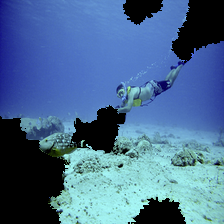

scuba diver: 60.48%
 coral reef: 19.30%
    snorkel: 14.72%
   lionfish:  2.96%
brain coral:  0.33%
  sea snake:  0.30%
  jellyfish:  0.25%
     puffer:  0.22%
      wreck:  0.11%
 loggerhead:  0.11%



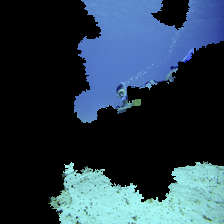

        scuba diver: 87.54%
              wreck:  4.07%
         coral reef:  2.35%
           lionfish:  1.19%
       sea cucumber:  0.59%
              cliff:  0.36%
             castle:  0.35%
            snorkel:  0.26%
Irish water spaniel:  0.21%
               jeep:  0.21%



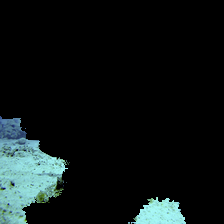

  coral reef: 18.02%
     volcano: 13.86%
  promontory:  9.51%
   jellyfish:  5.47%
       cliff:  5.15%
  breakwater:  3.75%
       wreck:  3.31%
sea cucumber:  3.07%
 scuba diver:  2.23%
 brain coral:  1.85%



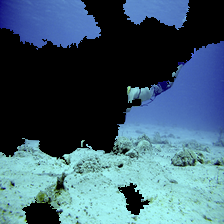

  coral reef: 28.33%
       cliff:  6.51%
   jellyfish:  6.06%
 scuba diver:  5.96%
sea cucumber:  5.14%
  promontory:  4.84%
 brain coral:  4.70%
     sandbar:  3.58%
    lakeside:  3.23%
         alp:  2.59%



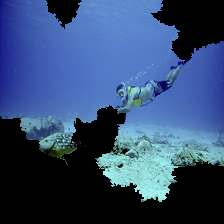

scuba diver: 59.10%
 coral reef: 25.20%
    snorkel:  7.96%
   lionfish:  3.57%
  jellyfish:  0.92%
brain coral:  0.38%
  sea snake:  0.25%
      cliff:  0.23%
      conch:  0.18%
     puffer:  0.16%



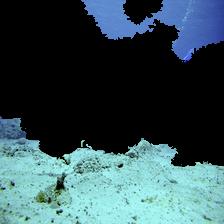

  coral reef: 40.41%
   jellyfish:  9.86%
  promontory:  8.44%
       conch:  6.51%
       cliff:  5.76%
       wreck:  4.31%
     volcano:  3.46%
 brain coral:  1.80%
sea cucumber:  1.71%
    lakeside:  1.12%



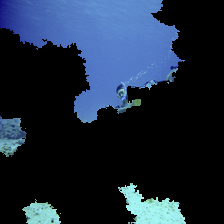

 scuba diver: 68.92%
  coral reef:  4.93%
       wreck:  3.58%
      castle:  2.85%
     volcano:  2.56%
    lakeside:  1.29%
analog clock:  1.25%
       cliff:  0.94%
      bubble:  0.88%
    fountain:  0.83%



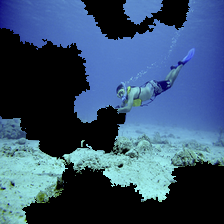

    snorkel: 47.38%
scuba diver: 33.58%
 coral reef: 16.39%
   lionfish:  1.69%
  sea snake:  0.13%
 loggerhead:  0.08%
      cliff:  0.08%
brain coral:  0.07%
      wreck:  0.05%
     puffer:  0.05%



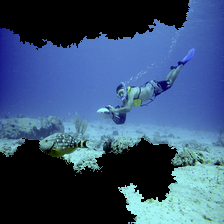

 coral reef: 34.66%
    snorkel: 34.46%
scuba diver: 26.55%
   lionfish:  1.73%
        ski:  0.62%
 loggerhead:  0.59%
  sea snake:  0.22%
      cliff:  0.19%
rock beauty:  0.12%
  parachute:  0.11%



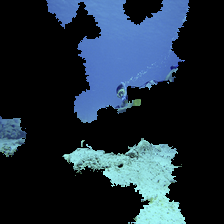

 scuba diver: 74.02%
  coral reef: 14.86%
       wreck:  1.82%
    lionfish:  1.52%
   jellyfish:  1.31%
      castle:  0.95%
     volcano:  0.65%
       cliff:  0.29%
analog clock:  0.24%
        jeep:  0.22%



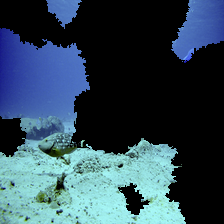

  coral reef: 39.80%
   jellyfish: 16.82%
 scuba diver:  9.37%
     volcano:  5.15%
 brain coral:  3.78%
sea cucumber:  2.22%
    lionfish:  1.79%
     snorkel:  1.73%
       conch:  1.51%
  promontory:  0.87%



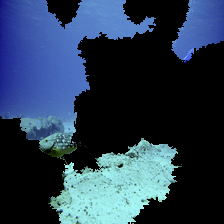

  coral reef: 38.72%
   jellyfish: 29.26%
     volcano: 16.23%
 brain coral:  2.31%
       cliff:  1.30%
  promontory:  1.30%
 scuba diver:  1.01%
coral fungus:  0.72%
    lakeside:  0.52%
      geyser:  0.52%



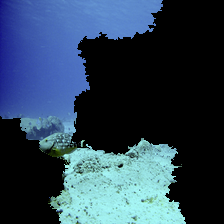

     volcano: 35.41%
  coral reef: 24.82%
   jellyfish: 12.66%
 brain coral:  5.33%
      geyser:  2.74%
       cliff:  2.69%
sea cucumber:  2.09%
 scuba diver:  0.74%
  promontory:  0.74%
       wreck:  0.71%



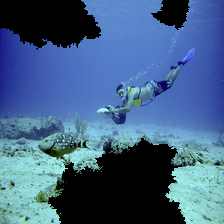

scuba diver: 39.86%
    snorkel: 31.23%
 coral reef: 25.42%
   lionfish:  1.67%
 loggerhead:  0.89%
  sea snake:  0.13%
rock beauty:  0.09%
        ski:  0.09%
      wreck:  0.06%
     puffer:  0.06%



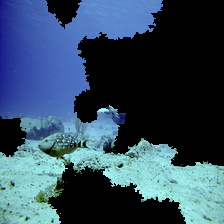

  coral reef: 49.52%
 scuba diver:  8.95%
     volcano:  5.11%
   jellyfish:  4.74%
 brain coral:  4.40%
  promontory:  3.29%
       cliff:  3.19%
       wreck:  2.36%
       conch:  1.73%
sea cucumber:  1.38%



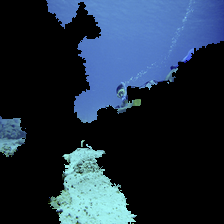

scuba diver: 66.41%
 coral reef: 11.12%
      wreck:  8.85%
     castle:  1.08%
       jeep:  0.86%
   lionfish:  0.79%
    volcano:  0.78%
  jellyfish:  0.75%
   lakeside:  0.69%
      cliff:  0.52%



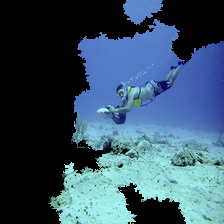

     snorkel: 53.97%
 scuba diver: 27.66%
  coral reef: 12.03%
    lionfish:  3.00%
         ski:  1.94%
  loggerhead:  0.26%
   sea snake:  0.16%
   parachute:  0.14%
 rock beauty:  0.09%
anemone fish:  0.09%



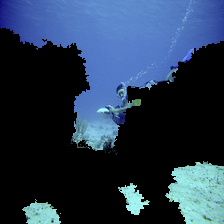

 scuba diver: 90.03%
  coral reef:  3.77%
       wreck:  2.47%
     volcano:  0.51%
    lionfish:  0.38%
       cliff:  0.37%
     snorkel:  0.17%
   jellyfish:  0.15%
sea cucumber:  0.14%
        jeep:  0.14%



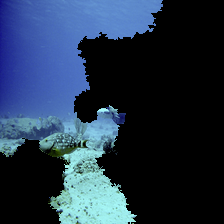

  coral reef: 73.94%
     volcano:  3.39%
   jellyfish:  3.19%
 brain coral:  3.19%
 scuba diver:  2.85%
       wreck:  2.24%
sea cucumber:  2.03%
       cliff:  1.41%
   sea snake:  1.25%
  promontory:  0.94%



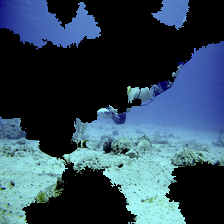

   jellyfish: 23.31%
  coral reef: 22.33%
       cliff:  6.34%
   parachute:  4.07%
       conch:  3.87%
  promontory:  3.70%
         alp:  2.70%
     balloon:  2.67%
sea cucumber:  2.46%
 brain coral:  1.95%



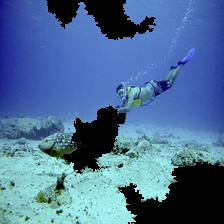

 scuba diver: 60.72%
     snorkel: 20.69%
  coral reef: 15.41%
    lionfish:  2.53%
  loggerhead:  0.12%
      puffer:  0.09%
 brain coral:  0.07%
   sea snake:  0.07%
       wreck:  0.03%
electric ray:  0.03%



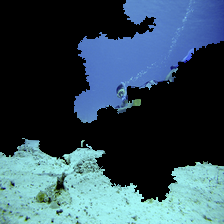

 scuba diver: 73.50%
  coral reef:  9.27%
    lionfish:  2.99%
       wreck:  2.39%
sea cucumber:  1.37%
        jeep:  1.01%
       cliff:  0.86%
      castle:  0.57%
     snorkel:  0.55%
        tank:  0.49%



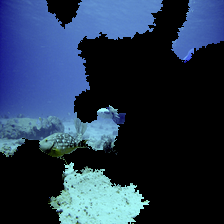

  coral reef: 78.85%
   jellyfish:  8.83%
 scuba diver:  4.41%
 brain coral:  2.17%
     volcano:  0.85%
sea cucumber:  0.72%
    lionfish:  0.69%
     snorkel:  0.48%
  promontory:  0.30%
       wreck:  0.28%



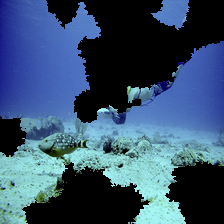

  coral reef: 42.48%
   jellyfish: 18.74%
    lionfish:  5.02%
 scuba diver:  4.73%
sea cucumber:  4.21%
 brain coral:  2.86%
     balloon:  2.11%
     snorkel:  1.81%
       conch:  1.76%
   sea snake:  1.34%



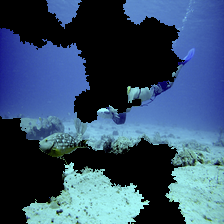

   jellyfish: 49.93%
  coral reef: 14.47%
   parachute:  6.60%
    lionfish:  5.06%
sea cucumber:  4.73%
     balloon:  3.05%
    sea slug:  1.69%
 brain coral:  1.41%
      chiton:  1.32%
    flatworm:  1.10%



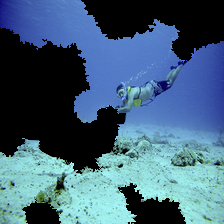

 scuba diver: 36.07%
     snorkel: 32.10%
  coral reef: 24.16%
    lionfish:  3.16%
 brain coral:  0.91%
   jellyfish:  0.81%
   sea snake:  0.78%
sea cucumber:  0.20%
       conch:  0.17%
 green snake:  0.17%



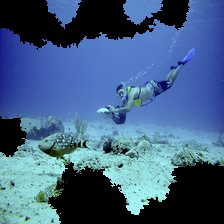

    snorkel: 37.11%
 coral reef: 33.87%
scuba diver: 24.52%
   lionfish:  2.45%
        ski:  0.68%
 loggerhead:  0.30%
  sea snake:  0.21%
rock beauty:  0.19%
      wreck:  0.09%
brain coral:  0.06%



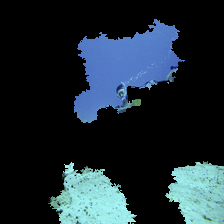

  scuba diver: 69.11%
   coral reef: 10.29%
      volcano:  3.30%
    jellyfish:  2.19%
     lionfish:  1.30%
        wreck:  1.01%
       castle:  0.98%
       bubble:  0.80%
      tractor:  0.74%
traffic light:  0.64%



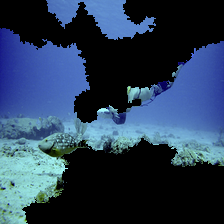

  coral reef: 37.73%
   jellyfish: 36.80%
   parachute:  9.03%
sea cucumber:  2.25%
     balloon:  2.07%
    lionfish:  1.53%
       conch:  1.13%
     volcano:  0.71%
    sea slug:  0.70%
 brain coral:  0.66%



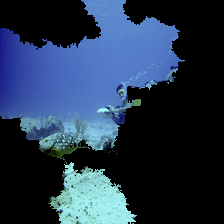

scuba diver: 63.07%
 coral reef: 22.86%
   lionfish:  2.61%
  jellyfish:  1.95%
    volcano:  1.42%
      wreck:  1.32%
brain coral:  0.75%
   fountain:  0.56%
     castle:  0.45%
      cliff:  0.35%



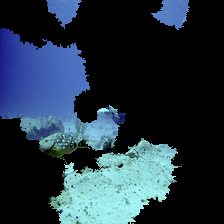

 coral reef: 27.05%
  jellyfish: 21.38%
    volcano: 17.11%
brain coral:  4.41%
      cliff:  2.53%
   lionfish:  1.82%
scuba diver:  1.71%
     geyser:  1.24%
        alp:  1.03%
     valley:  1.02%



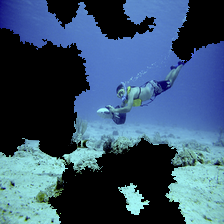

scuba diver: 33.69%
    snorkel: 32.00%
 coral reef: 24.31%
   lionfish:  7.52%
  jellyfish:  0.47%
     puffer:  0.28%
 loggerhead:  0.20%
brain coral:  0.16%
  sea snake:  0.15%
rock beauty:  0.14%



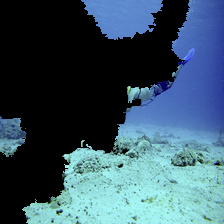

sea cucumber: 16.99%
  coral reef: 12.37%
   jellyfish: 12.32%
       cliff:  8.09%
       wreck:  7.31%
    lionfish:  4.58%
  promontory:  4.52%
       conch:  3.89%
 brain coral:  2.08%
 scuba diver:  1.58%



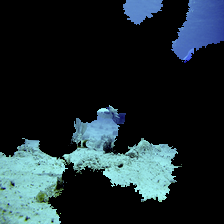

     jellyfish: 18.51%
    coral reef: 17.49%
       volcano: 14.65%
        valley: 10.00%
   brain coral:  2.80%
         cliff:  2.74%
         conch:  2.69%
    promontory:  2.21%
      lakeside:  1.43%
cliff dwelling:  1.37%



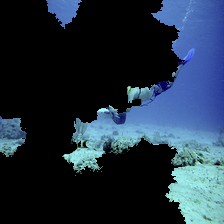

 jellyfish: 48.37%
 parachute:  9.26%
   balloon:  8.75%
coral reef:  5.06%
     cliff:  2.92%
     conch:  2.25%
    bubble:  1.58%
   volcano:  1.38%
   airship:  1.32%
promontory:  0.92%



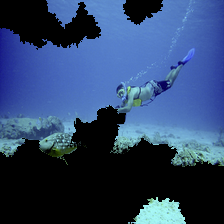

  coral reef: 79.78%
 scuba diver: 11.61%
    lionfish:  4.04%
     snorkel:  2.52%
      puffer:  0.54%
   sea snake:  0.37%
  loggerhead:  0.36%
  hammerhead:  0.12%
electric ray:  0.06%
 brain coral:  0.06%



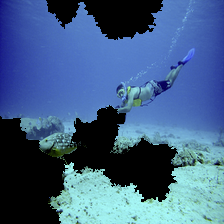

scuba diver: 41.29%
 coral reef: 39.61%
    snorkel: 11.63%
   lionfish:  5.21%
  sea snake:  0.47%
     puffer:  0.23%
      cliff:  0.15%
brain coral:  0.15%
 loggerhead:  0.11%
  jellyfish:  0.10%



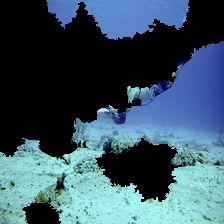

   jellyfish: 29.20%
   parachute: 10.67%
sea cucumber:  7.46%
  coral reef:  6.81%
     balloon:  4.29%
         alp:  4.27%
       cliff:  3.39%
       stupa:  2.37%
    lionfish:  1.92%
       conch:  1.64%



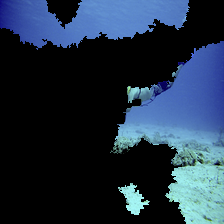

 jellyfish: 27.79%
 parachute: 18.20%
coral reef:  9.11%
  lakeside:  5.83%
     cliff:  5.39%
promontory:  2.82%
   balloon:  2.77%
   volcano:  2.10%
     wreck:  1.47%
  fountain:  1.15%



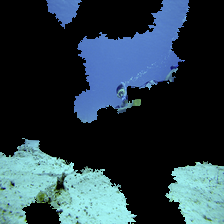

scuba diver: 68.22%
 coral reef: 12.93%
   lionfish:  2.79%
    volcano:  2.39%
      wreck:  1.84%
     castle:  1.26%
  jellyfish:  1.13%
      cliff:  0.98%
brain coral:  0.46%
     bubble:  0.38%



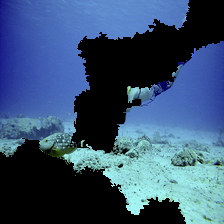

  coral reef: 33.44%
       cliff:  8.37%
 scuba diver:  7.66%
       wreck:  5.56%
  promontory:  4.88%
   jellyfish:  4.59%
    lionfish:  4.36%
sea cucumber:  3.43%
 brain coral:  2.80%
     volcano:  2.76%



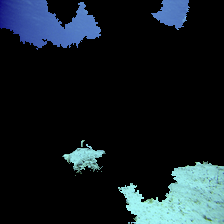

    jellyfish: 42.93%
      volcano: 19.87%
   coral reef: 13.81%
     lakeside:  1.32%
       geyser:  1.32%
  brain coral:  1.27%
        cliff:  1.24%
      obelisk:  1.21%
jigsaw puzzle:  0.71%
       bubble:  0.70%



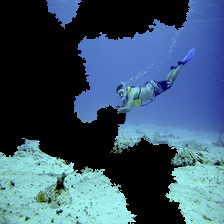

    snorkel: 48.38%
 coral reef: 24.98%
scuba diver: 21.13%
   lionfish:  1.86%
  sea snake:  0.78%
     puffer:  0.43%
 loggerhead:  0.36%
  jellyfish:  0.25%
brain coral:  0.20%
green snake:  0.18%



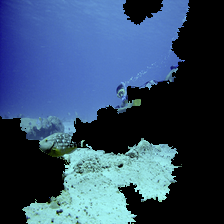

scuba diver: 70.25%
 coral reef: 20.44%
      wreck:  2.86%
   lionfish:  1.68%
  jellyfish:  0.79%
brain coral:  0.66%
     castle:  0.40%
    volcano:  0.25%
    snorkel:  0.24%
      cliff:  0.20%



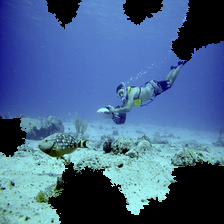

 coral reef: 49.26%
    snorkel: 25.76%
scuba diver: 19.69%
   lionfish:  2.92%
        ski:  0.58%
rock beauty:  0.30%
  sea snake:  0.22%
 loggerhead:  0.18%
brain coral:  0.10%
      wreck:  0.09%



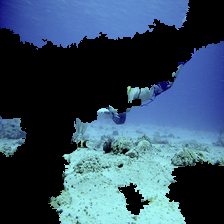

 parachute: 21.32%
 jellyfish: 10.11%
       alp:  9.19%
coral reef:  8.08%
     cliff:  6.55%
promontory:  6.13%
   balloon:  4.93%
  lakeside:  4.58%
    valley:  3.65%
   sandbar:  1.85%



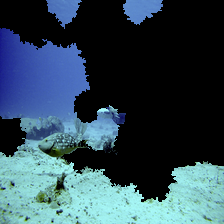

        coral reef: 27.73%
      sea cucumber: 19.08%
       brain coral:  6.69%
    Scotch terrier:  3.21%
         jellyfish:  2.91%
       scuba diver:  2.80%
      Newfoundland:  2.44%
    cocker spaniel:  2.23%
           volcano:  1.80%
Kerry blue terrier:  1.80%



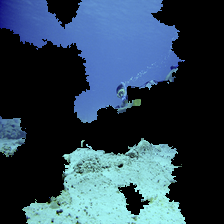

scuba diver: 70.63%
 coral reef: 22.23%
  jellyfish:  1.78%
      wreck:  0.95%
   lionfish:  0.91%
brain coral:  0.67%
    volcano:  0.64%
    snorkel:  0.15%
      cliff:  0.12%
     castle:  0.10%



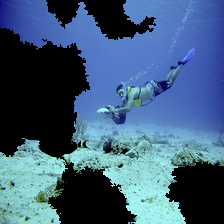

     snorkel: 55.97%
 scuba diver: 31.35%
  coral reef: 10.29%
    lionfish:  1.80%
  loggerhead:  0.11%
         ski:  0.11%
 rock beauty:  0.06%
   sea snake:  0.06%
 brain coral:  0.04%
sea cucumber:  0.03%



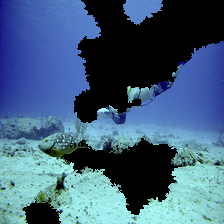

  coral reef: 37.57%
   jellyfish: 27.43%
sea cucumber:  8.85%
       conch:  3.03%
    lionfish:  2.80%
    sea slug:  1.71%
 brain coral:  1.52%
 scuba diver:  1.48%
   parachute:  1.36%
     snorkel:  1.00%



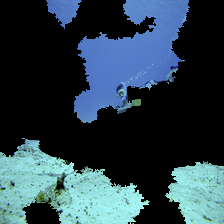

scuba diver: 71.21%
 coral reef: 12.17%
   lionfish:  3.47%
      wreck:  1.89%
     castle:  1.32%
    volcano:  1.06%
  jellyfish:  0.60%
      cliff:  0.52%
    tractor:  0.50%
brain coral:  0.45%



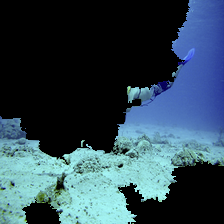

  coral reef: 24.86%
sea cucumber: 16.59%
       conch:  7.23%
   jellyfish:  6.00%
       wreck:  5.51%
       cliff:  4.89%
 scuba diver:  4.44%
    lionfish:  2.48%
  promontory:  2.11%
  sea urchin:  1.77%



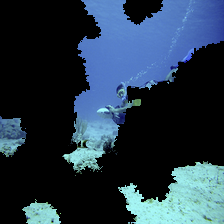

scuba diver: 90.19%
 coral reef:  3.03%
      wreck:  2.22%
   lionfish:  0.91%
  jellyfish:  0.43%
brain coral:  0.33%
    snorkel:  0.31%
      cliff:  0.30%
    volcano:  0.25%
       jeep:  0.23%



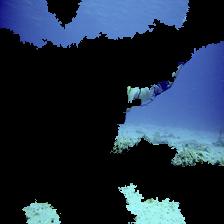

   jellyfish: 43.34%
  coral reef: 16.53%
   parachute:  6.48%
 brain coral:  2.57%
       cliff:  2.27%
    lionfish:  2.27%
    lakeside:  2.25%
 scuba diver:  1.96%
     balloon:  1.84%
sea cucumber:  1.72%



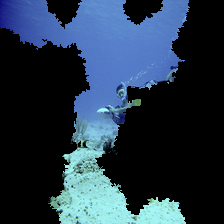

scuba diver: 74.18%
 coral reef: 15.34%
  jellyfish:  2.25%
   lionfish:  1.53%
    volcano:  0.98%
      wreck:  0.91%
brain coral:  0.81%
    snorkel:  0.66%
     castle:  0.44%
      cliff:  0.21%



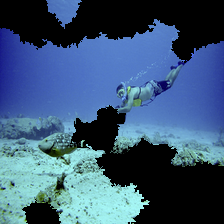

  coral reef: 54.53%
 scuba diver: 24.92%
     snorkel: 10.69%
    lionfish:  4.27%
 brain coral:  0.99%
   sea snake:  0.92%
      puffer:  0.76%
   jellyfish:  0.52%
anemone fish:  0.35%
       conch:  0.24%



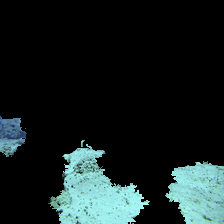

      coral reef: 22.19%
       jellyfish: 19.19%
    coral fungus: 14.31%
         volcano:  7.08%
        mushroom:  3.50%
     sea anemone:  3.03%
     brain coral:  2.30%
      matchstick:  1.50%
hen-of-the-woods:  1.20%
           wreck:  1.20%



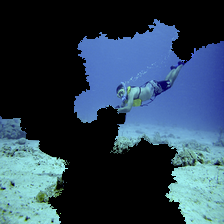

    snorkel: 40.60%
scuba diver: 30.64%
 coral reef: 15.90%
  jellyfish:  2.65%
   lionfish:  2.15%
  sea snake:  1.54%
      cliff:  0.68%
      conch:  0.61%
brain coral:  0.57%
green snake:  0.52%



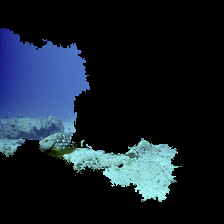

    volcano: 40.31%
 coral reef: 26.31%
  jellyfish: 12.61%
      cliff:  2.86%
brain coral:  2.31%
     geyser:  1.59%
scuba diver:  1.29%
        alp:  1.04%
 promontory:  1.00%
      conch:  0.92%



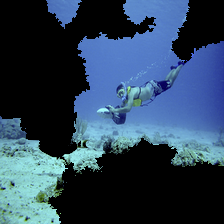

    snorkel: 53.10%
scuba diver: 27.03%
 coral reef: 12.36%
   lionfish:  4.95%
 loggerhead:  0.49%
        ski:  0.24%
     puffer:  0.21%
  jellyfish:  0.20%
      wreck:  0.16%
  sea snake:  0.14%



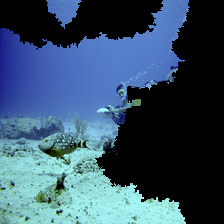

 scuba diver: 66.98%
  coral reef: 20.46%
    lionfish:  2.58%
       wreck:  1.77%
        jeep:  1.77%
     snorkel:  1.08%
 brain coral:  0.70%
   jellyfish:  0.37%
      castle:  0.36%
sea cucumber:  0.30%



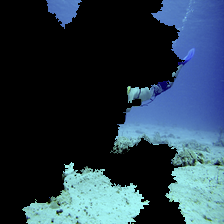

   jellyfish: 20.65%
  coral reef: 20.46%
 scuba diver:  7.22%
sea cucumber:  6.15%
    lionfish:  5.56%
       cliff:  4.89%
 brain coral:  3.00%
    sea slug:  2.50%
     volcano:  2.42%
     snorkel:  1.94%



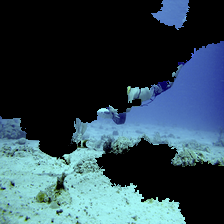

  coral reef: 27.92%
   jellyfish: 17.82%
   parachute: 13.70%
       conch:  5.57%
     balloon:  4.65%
sea cucumber:  4.05%
    lionfish:  2.36%
   sea snake:  2.14%
     sandbar:  1.98%
    sea slug:  1.64%



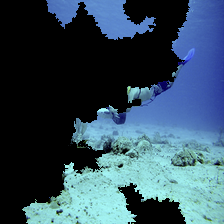

   parachute: 23.81%
   jellyfish: 14.80%
  coral reef:  8.69%
     balloon:  8.56%
       cliff:  6.06%
    lionfish:  4.14%
sea cucumber:  3.36%
         alp:  2.47%
  promontory:  2.13%
       conch:  1.63%



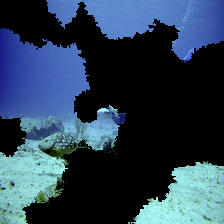

  coral reef: 41.46%
 scuba diver: 13.59%
       wreck: 10.00%
     volcano:  5.92%
sea cucumber:  5.32%
       cliff:  4.19%
  promontory:  3.53%
 brain coral:  3.13%
   jellyfish:  1.61%
     snorkel:  0.78%



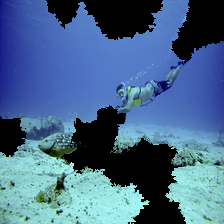

 scuba diver: 43.61%
  coral reef: 30.90%
     snorkel: 11.82%
    lionfish:  7.44%
   jellyfish:  1.05%
 brain coral:  0.81%
   sea snake:  0.72%
       conch:  0.50%
      puffer:  0.49%
anemone fish:  0.43%



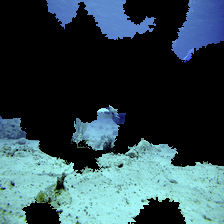

  coral reef: 33.01%
       cliff: 12.13%
  promontory: 11.39%
     volcano:  8.85%
       conch:  4.42%
   jellyfish:  4.15%
      valley:  3.31%
 brain coral:  3.25%
       wreck:  2.65%
sea cucumber:  2.31%



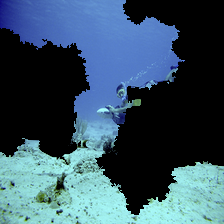

        scuba diver: 79.96%
       sea cucumber:  5.59%
         coral reef:  2.55%
     Scotch terrier:  1.79%
 Kerry blue terrier:  1.06%
           lionfish:  0.97%
Irish water spaniel:  0.83%
        brain coral:  0.72%
            snorkel:  0.60%
         toy poodle:  0.58%



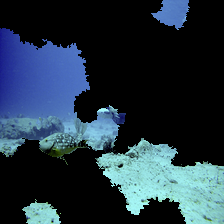

  coral reef: 47.26%
   jellyfish: 16.72%
 brain coral:  6.86%
     volcano:  5.79%
       conch:  3.34%
    lionfish:  3.01%
 scuba diver:  2.07%
sea cucumber:  1.17%
 sea anemone:  0.71%
       wreck:  0.67%



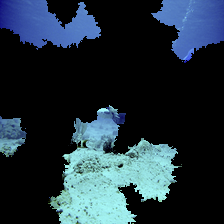

 coral reef: 31.66%
  jellyfish: 28.17%
    volcano: 12.89%
brain coral:  3.79%
     valley:  2.18%
 promontory:  1.69%
      cliff:  1.26%
      conch:  1.16%
   lakeside:  0.93%
     geyser:  0.87%



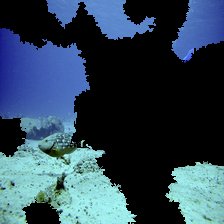

  coral reef: 67.42%
     volcano:  4.09%
   jellyfish:  3.94%
 scuba diver:  3.48%
sea cucumber:  2.98%
 brain coral:  2.71%
  promontory:  1.92%
       conch:  1.38%
       wreck:  1.04%
    lakeside:  0.90%



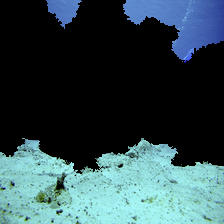

     volcano: 24.97%
  coral reef: 15.46%
       cliff:  6.69%
   jellyfish:  6.47%
 brain coral:  4.51%
  promontory:  4.33%
sea cucumber:  3.36%
      geyser:  3.25%
         alp:  1.63%
     sandbar:  1.57%



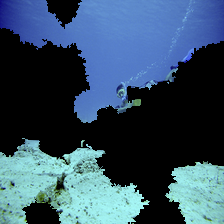

 scuba diver: 71.03%
  coral reef: 16.69%
     volcano:  1.27%
       wreck:  1.23%
    lionfish:  1.11%
 brain coral:  1.06%
   jellyfish:  1.02%
       cliff:  0.83%
sea cucumber:  0.80%
     snorkel:  0.47%



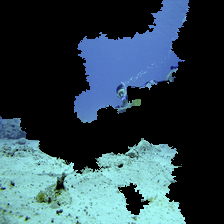

scuba diver: 78.15%
 coral reef: 12.73%
      wreck:  3.64%
   lionfish:  0.81%
  jellyfish:  0.62%
       jeep:  0.34%
    volcano:  0.32%
      cliff:  0.29%
brain coral:  0.26%
    snorkel:  0.25%



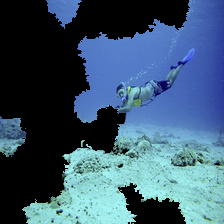

    snorkel: 54.57%
scuba diver: 31.52%
 coral reef: 11.83%
   lionfish:  1.05%
  sea snake:  0.24%
 loggerhead:  0.10%
        ski:  0.10%
     puffer:  0.08%
brain coral:  0.06%
      cliff:  0.06%



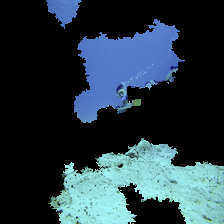

scuba diver: 80.25%
 coral reef: 10.14%
    volcano:  1.19%
   lionfish:  0.74%
      wreck:  0.69%
     castle:  0.63%
    tractor:  0.54%
       jeep:  0.50%
  jellyfish:  0.48%
      cliff:  0.47%



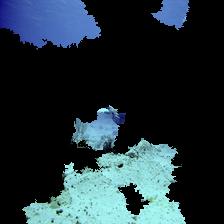

  coral reef: 35.89%
   jellyfish: 13.62%
     volcano: 10.07%
       cliff:  5.36%
 scuba diver:  2.76%
 brain coral:  2.72%
       wreck:  1.76%
         alp:  1.73%
    lionfish:  1.33%
coral fungus:  1.21%



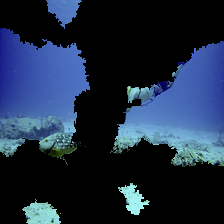

   jellyfish: 50.44%
  coral reef: 29.01%
    lionfish:  2.72%
 scuba diver:  1.65%
     volcano:  1.62%
       conch:  1.22%
sea cucumber:  0.89%
    sea slug:  0.81%
     balloon:  0.69%
    lakeside:  0.65%



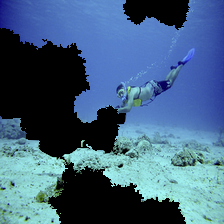

    snorkel: 64.29%
scuba diver: 27.17%
 coral reef:  7.04%
   lionfish:  0.83%
      cliff:  0.13%
 loggerhead:  0.08%
  sea snake:  0.07%
brain coral:  0.04%
        ski:  0.03%
     puffer:  0.02%



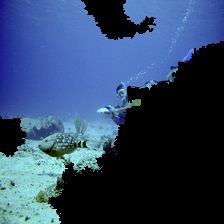

scuba diver: 67.63%
      wreck: 15.52%
 coral reef: 11.79%
       jeep:  1.24%
    snorkel:  0.52%
   lionfish:  0.45%
     castle:  0.41%
   lakeside:  0.33%
      cliff:  0.22%
brain coral:  0.16%



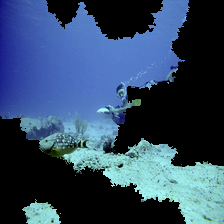

scuba diver: 91.98%
 coral reef:  3.04%
      wreck:  1.35%
       jeep:  1.18%
   lionfish:  0.41%
     castle:  0.39%
    tractor:  0.18%
brain coral:  0.12%
    snorkel:  0.12%
    volcano:  0.10%



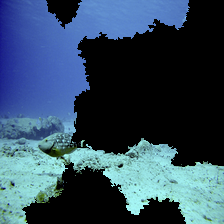

       volcano: 32.56%
    coral reef: 20.29%
         cliff: 13.44%
    promontory:  8.58%
     jellyfish:  4.53%
        geyser:  3.80%
   brain coral:  3.48%
   scuba diver:  2.72%
cliff dwelling:  1.27%
       snorkel:  1.16%



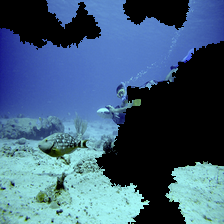

 scuba diver: 76.49%
  coral reef: 12.80%
    lionfish:  2.27%
       wreck:  2.07%
sea cucumber:  1.92%
 brain coral:  1.01%
     snorkel:  0.66%
   jellyfish:  0.36%
        jeep:  0.35%
      castle:  0.14%



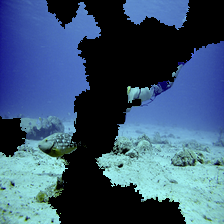

  coral reef: 31.15%
 scuba diver:  6.88%
       wreck:  5.48%
    lionfish:  5.17%
  promontory:  5.02%
       cliff:  4.51%
   jellyfish:  4.46%
 brain coral:  3.87%
sea cucumber:  3.08%
    lakeside:  2.35%



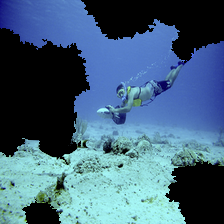

     snorkel: 48.25%
 scuba diver: 29.07%
  coral reef: 17.60%
    lionfish:  3.01%
sea cucumber:  0.28%
   sea snake:  0.23%
         ski:  0.22%
 brain coral:  0.20%
 rock beauty:  0.15%
   jellyfish:  0.13%



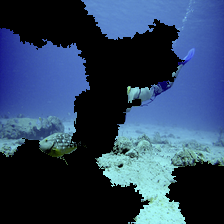

  coral reef: 35.16%
   jellyfish: 23.24%
    lionfish: 12.89%
 scuba diver:  5.22%
sea cucumber:  2.71%
       wreck:  2.38%
 brain coral:  2.06%
     volcano:  1.85%
       conch:  1.74%
    sea slug:  1.52%



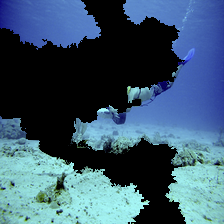

   jellyfish: 37.12%
  coral reef: 14.81%
sea cucumber:  6.71%
   parachute:  5.81%
       conch:  4.68%
       cliff:  3.18%
  promontory:  3.03%
    lakeside:  2.69%
     balloon:  2.21%
    lionfish:  1.93%



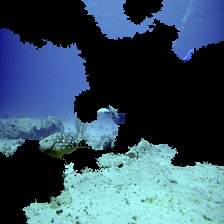

  coral reef: 77.86%
   jellyfish:  4.15%
 brain coral:  3.64%
sea cucumber:  2.79%
 scuba diver:  1.79%
     volcano:  1.35%
  promontory:  0.96%
       conch:  0.94%
    lionfish:  0.89%
       wreck:  0.70%



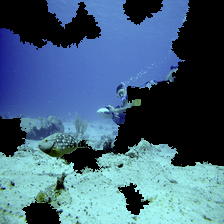

scuba diver: 82.12%
 coral reef: 12.33%
      wreck:  2.47%
   lionfish:  0.76%
       jeep:  0.58%
brain coral:  0.25%
    snorkel:  0.22%
   snowplow:  0.13%
    tractor:  0.11%
  jellyfish:  0.09%



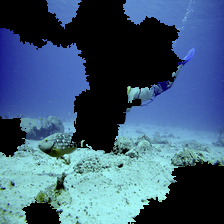

  coral reef: 27.47%
    lionfish: 16.31%
 scuba diver: 13.13%
   jellyfish:  9.97%
 brain coral:  3.53%
sea cucumber:  3.37%
       conch:  3.12%
     snorkel:  2.75%
     volcano:  1.39%
    sea slug:  1.15%



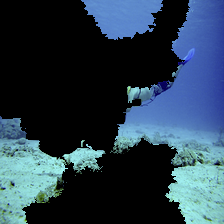

       cliff: 21.74%
sea cucumber: 10.01%
   jellyfish:  8.87%
  promontory:  8.15%
  coral reef:  7.64%
       wreck:  6.58%
       conch:  2.33%
     volcano:  2.18%
    lakeside:  2.16%
    seashore:  2.16%



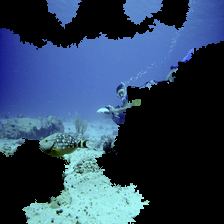

scuba diver: 51.87%
 coral reef: 39.39%
      wreck:  2.91%
   lionfish:  0.93%
       jeep:  0.85%
brain coral:  0.66%
  jellyfish:  0.48%
     castle:  0.38%
  sea snake:  0.25%
    snorkel:  0.24%



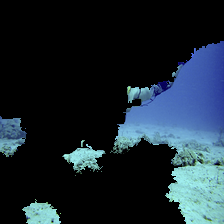

     cliff: 18.11%
coral reef: 11.63%
 jellyfish:  9.11%
   volcano:  4.77%
promontory:  4.77%
     stupa:  4.30%
     wreck:  3.16%
  lakeside:  2.67%
     conch:  2.64%
   balloon:  2.61%



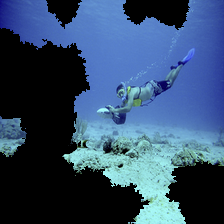

    snorkel: 54.42%
scuba diver: 23.50%
 coral reef: 19.12%
   lionfish:  2.14%
 loggerhead:  0.21%
        ski:  0.12%
  sea snake:  0.07%
rock beauty:  0.07%
      cliff:  0.04%
brain coral:  0.04%



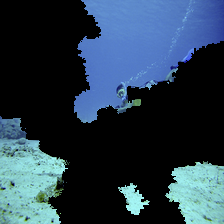

scuba diver: 85.46%
      wreck:  8.45%
 coral reef:  1.39%
      cliff:  1.15%
   lionfish:  0.50%
 promontory:  0.40%
    volcano:  0.24%
     castle:  0.23%
   lakeside:  0.19%
    snorkel:  0.18%



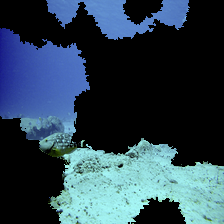

  coral reef: 37.80%
   jellyfish: 20.27%
     volcano: 18.40%
 brain coral:  8.50%
sea cucumber:  1.24%
      geyser:  1.24%
       cliff:  0.92%
 scuba diver:  0.89%
   sea snake:  0.83%
    lionfish:  0.82%



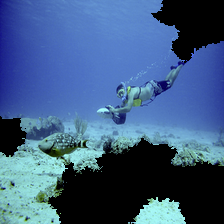

 coral reef: 42.74%
scuba diver: 36.08%
    snorkel: 12.69%
   lionfish:  3.66%
 loggerhead:  0.96%
  sea snake:  0.65%
      wreck:  0.43%
        ski:  0.36%
rock beauty:  0.23%
     puffer:  0.21%



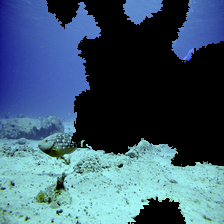

  coral reef: 61.16%
   jellyfish:  9.02%
     volcano:  5.21%
sea cucumber:  4.54%
 brain coral:  4.25%
 scuba diver:  3.05%
     snorkel:  2.24%
  promontory:  2.06%
       conch:  0.95%
       cliff:  0.75%


In [0]:
%%time
# Hide color is the color for a superpixel turned OFF. Alternatively, if it is NONE, the superpixel will be replaced by the average of its pixels
explanation = explainer.explain_instance(test_image, classifyImages, top_labels=5, hide_color=0, num_samples=1000)

In [0]:
from skimage.segmentation import mark_boundaries

In [0]:
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))